# Proposal to Generate and Characterize Entanglement using Metamaterial Resonators


In [3]:
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
from numpy import *
from qutip import *
from IPython.display import Image
from numpy.linalg import *
import multiprocessing as mp
import scipy.constants as sc
import time
import datetime
import os
from matplotlib import cm
import matplotlib as mpl
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"],
})
plt.rcParams['figure.dpi'] = 100


## 1. Metamaterial Circuit Resonator

The dispersion relation for a left-handed TL will be given by
$$ \omega_\ell (k_\ell) = \frac{1}{2\sqrt{L_\ell C_\ell}\sin(k_\ell\Delta x/2)},$$
where
$$ \omega_{IR} (k_\ell) = \frac{1}{2\sqrt{L_\ell C\_\ell}}.$$

A conventional transmission line, with right-handed configuration, dispersion relation is
$$ \omega_r(k_r) = \frac{2}{\sqrt{L_r C_r}}\sin\left(\frac{k_r\Delta x}{2}\right) \rightarrow \frac{k_r}{\sqrt{c_r l_r}}.$$

The values of $C_\ell$ and $L_\ell$ can be picked based on the line impedance $Z_0$ and the infrared cutoff $\omega_{IR}$, according to the following equations:
$$ C_\ell = \frac{1}{2\omega_{IR}Z_0},$$
and
$$ L_\ell = \frac{Z_0}{2\omega_{IR}}.$$

For $Z_0 = 50\,\Omega$ and $\omega_{IR} \approx 2\pi\times 5\,$ GHz, we will have:


In [2]:
Z0 = 50  # Ohm
wIR = 2 * pi * 5 * 1e9  # 5 GHz

C = (1 / (2 * wIR * Z0))
L = (Z0 / (2 * wIR))

#L = 993.6 * 1e-12
#C = 402.3 * 1e-15

print('C = %.3f fF' % (C*1e15))
print('L = %.3f pH' % (L*1e12))


C = 318.310 fF
L = 795.775 pH


In [8]:
print('C2 = %.3f fF' % (2.5*C*1e15))
print('L2 = %.3f pH' % (2.5*L*1e12))

C2 = 568.411 fF
L2 = 1421.026 pH


In [3]:
(0.5e-9)/(2* pi* sqrt(L*C))

3.9802406266912858

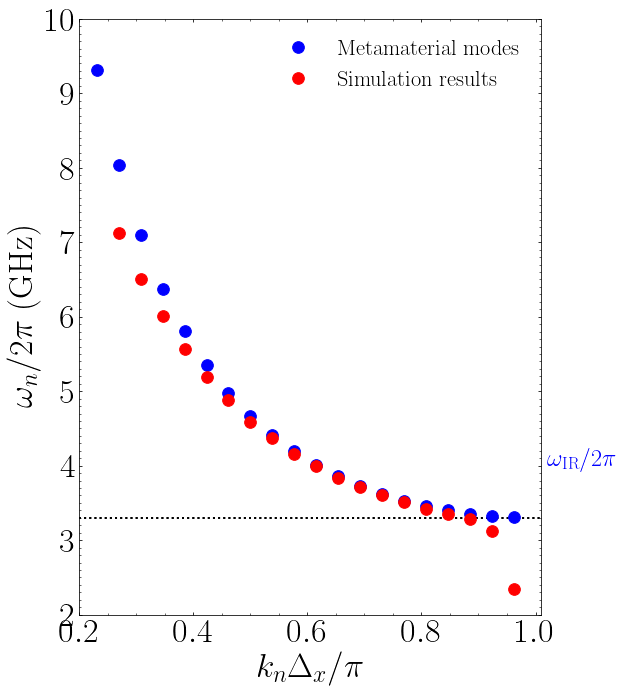

In [155]:
N_cells = 26
meta_length = 3500 * 1e-6  # Approximated value based on our designs

DeltaX = meta_length/N_cells

k_list = [(i*pi)/meta_length for i in range(1, N_cells)]
omega_list = [1/(2 * sqrt(L*C) * sin(k * DeltaX / 2)) for k in k_list]

fig, axes = plt.subplots(1, 1, figsize=(9, 10))   # 9, 5

x_list = [(k * DeltaX)/pi for k in k_list]
y_list = [k / (2*pi*1e9) for k in omega_list]


# CST Results
y_list2 = [ 2.34,
            3.13,
            3.28,
            3.345,
            3.425,
            3.51,
            3.6,
            3.71,
            3.84,
            3.995,
            4.16,
            4.37,
            4.5929,
            4.8776,
            5.1858,
            5.5625,
            6.006,
            6.5008,
            7.1285]

x_list2 = [x_list[-k] for k in range(1,len(y_list2)+1)]

axes.axhline(y=(0.5e-9)/(2* pi* sqrt(L*C)), color='black', linestyle=':', lw=2.)
axes.axhline(y=3.3, color='black', linestyle=':', lw=2.)

axes.plot(x_list, y_list, 'o', label='Metamaterial modes',
          markersize=12, color='blue', lw=3.5)

axes.plot(x_list2, y_list2, 'o', label='Simulation results',
          markersize=12, color='red', lw=3.5)

axes.set_xlabel(r'$k_n\Delta_x/\pi$', rotation=0, fontsize=35)
axes.set_ylabel(r'$\omega_n/2\pi$ (GHz)', rotation=90, fontsize=35)
axes.set_xlim(0.2, 1.01)
axes.set_ylim(2, 10)
axes.tick_params(axis='both', which='major', direction='in', labelsize=35)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=35)
# axes.yaxis.tick_right()
axes.xaxis.set_ticks_position('both')
axes.yaxis.set_ticks_position('both')
# axes.legend(loc=2,fontsize=23,frameon=False)
#start, end = axes.get_xlim()
axes.xaxis.set_ticks(arange(0.2, 1.2, 0.2))
axes.yaxis.set_ticks(arange(2, 11, 1))
axes.xaxis.set_minor_locator(AutoMinorLocator(4))
axes.yaxis.set_minor_locator(AutoMinorLocator(10))
#axes.text(-900, 0.14, r"$n_2 = 1$",color='red', fontsize=25, rotation=-45)
axes.text(1.02, 4., r'$\omega_\mathrm{IR}/2\pi$',
          color='blue', fontsize=25, rotation=0)

axes.legend(fontsize=23, frameon=False)
plt.margins(x=0.01, y=0.01)
plt.tight_layout()

#plt.savefig('dispersionLHTL.pdf')
plt.show()


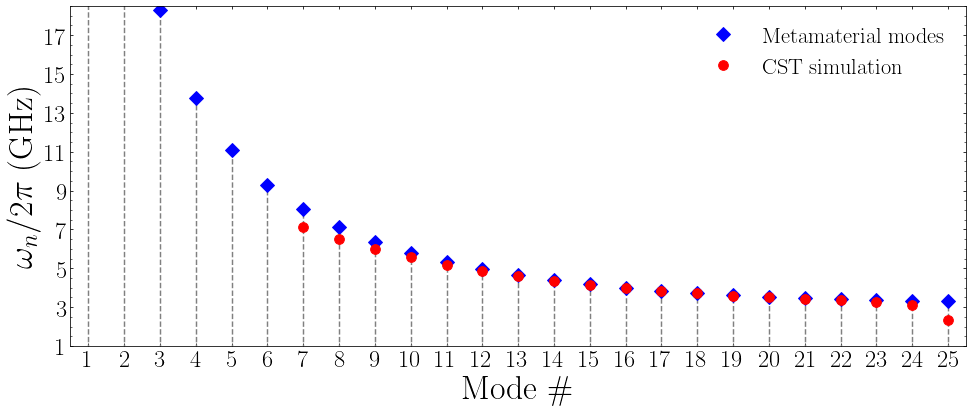

In [177]:
fig, axes = plt.subplots(1, 1, figsize=(14, 6))   # 9, 5

x_list = arange(1,N_cells,1)
y_list = [k / (2*pi*1e9) for k in omega_list]

x_list2 = [x_list[-k] for k in range(1,len(y_list2)+1)]

#axes.axhline(y=(0.5e-9)/(2* pi* sqrt(L*C)), color='black', linestyle=':', lw=2.)
#axes.axhline(y=3.3, color='black', linestyle=':', lw=2.)
plt.stem(x_list,y_list,linefmt=('--','grey'))


axes.plot(x_list, y_list, 'D', label='Metamaterial modes',
          markersize=10, color='blue', lw=3.5)

axes.plot(x_list2, y_list2, 'o', label='CST simulation',
          markersize=10, color='red', lw=3.5)

axes.set_xlabel(r'Mode $\#$', rotation=0, fontsize=35)
axes.set_ylabel(r'$\omega_n/2\pi$ (GHz)', rotation=90, fontsize=35)
axes.set_xlim(0.5, 25.5)
axes.set_ylim(2, 18.5)
axes.tick_params(axis='both', which='major', direction='in', labelsize=25)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=25)
# axes.yaxis.tick_right()
axes.xaxis.set_ticks_position('both')
axes.yaxis.set_ticks_position('both')
# axes.legend(loc=2,fontsize=23,frameon=False)
#start, end = axes.get_xlim()
axes.xaxis.set_ticks(arange(1, 26, 1))
axes.yaxis.set_ticks(arange(1, 19, 2))
#axes.xaxis.set_minor_locator(AutoMinorLocator(0))
axes.yaxis.set_minor_locator(AutoMinorLocator(4))
#axes.text(-900, 0.14, r"$n_2 = 1$",color='red', fontsize=25, rotation=-45)
#axes.text(1.02, 4., r'$\omega_\mathrm{IR}/2\pi$',
#          color='blue', fontsize=25, rotation=0)

axes.legend(fontsize=23, frameon=False)
plt.margins(x=0.01, y=0.01)
plt.tight_layout()
plt.grid(False)

#plt.savefig('dispersionLHTL.pdf')
plt.show()


In [5]:
v = 3992
f = 2* pi * 500 * 1e6

lw = v/f
lw * 1e6

1.2706930656456925

In [8]:
f = (v/(4e-6))/(2 * pi * 1e6)
f

158.83663320571156

In [89]:
# Mode frequencies:
for k in range(0, len(omega_list)):
    print('w'+str(k)+'(/2pi) = %.5f GHz' % float(omega_list[k]/(2*pi*1e9)))


w0(/2pi) = 54.32398 GHz
w1(/2pi) = 27.21163 GHz
w2(/2pi) = 18.19644 GHz
w3(/2pi) = 13.70575 GHz
w4(/2pi) = 11.02510 GHz
w5(/2pi) = 9.24973 GHz
w6(/2pi) = 7.99195 GHz
w7(/2pi) = 7.05797 GHz
w8(/2pi) = 6.34015 GHz
w9(/2pi) = 5.77399 GHz
w10(/2pi) = 5.31847 GHz
w11(/2pi) = 4.94629 GHz
w12(/2pi) = 4.63862 GHz
w13(/2pi) = 4.38203 GHz
w14(/2pi) = 4.16675 GHz
w15(/2pi) = 3.98550 GHz
w16(/2pi) = 3.83276 GHz
w17(/2pi) = 3.70431 GHz
w18(/2pi) = 3.59689 GHz
w19(/2pi) = 3.50796 GHz
w20(/2pi) = 3.43556 GHz
w21(/2pi) = 3.37816 GHz
w22(/2pi) = 3.33462 GHz
w23(/2pi) = 3.30409 GHz
w24(/2pi) = 3.28600 GHz


### Voltage across the composite transmission line (CTL)

Assuming perfect transmission and no reflections (ideal case) in the composite transmission line (CTL). The voltage across the tranmission line for the mode $k$ will be given by the sum
$$ V_{n,k}(t) = V_{n,k}^+(t) + V_{n,k}^-(t),$$
where
\begin{equation}
V_n^+(t) = e^{-i\omega t}\left\{
\begin{aligned}
& e^{-ik_r n\Delta x} \qquad \mathrm{RHTL} \\
& e^{+ik_\ell n\Delta x} \qquad \mathrm{LHTL}
\end{aligned}
\right.
\end{equation}

\begin{equation}
V_n^-(t) =e^{-i\omega t} \left\{
\begin{aligned}
& e^{+ik_r n\Delta x} \qquad \mathrm{RHTL} \\
& e^{-ik_\ell n\Delta x} \qquad \mathrm{LHTL}
\end{aligned}
\right.
\end{equation}

Applying the boundary conditions, we obtain the follwoing system of equations:
\begin{equation}
\left\{
\begin{aligned}
& 0 = |e^{-2ik_rN_r\Delta x} - V_0^{(k)}e^{+i\Delta\phi_k}|^2 \\
& 0 = |e^{+2ik_\ell N\_\ell\Delta x} - V_0^{(k)}e^{-i\Delta\phi_k}|^2
\end{aligned}
\right.
\end{equation}


In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

x_list = linspace(0, meta_length, 40) * (1e3)
y1_list = [(exp(1j*k_list[35]*k)+exp(-1j*k_list[35]*k)) for k in x_list]
y2_list = [real(exp(1j*k_list[34]*k)) for k in x_list]
y3_list = [real(exp(1j*k_list[33]*k)) for k in x_list]

axes.plot(x_list, y1_list, 'o', markersize=8, color='blue', lw=1.)
#axes.plot(x_list, y2_list,'o',markersize=8, color='red', lw=1.)
#axes.plot(x_list, y3_list,'o',markersize=8, color='green', lw=1.)

axes.set_xlabel(r'$k_n\Delta_x/\pi$', rotation=0, fontsize=35)
axes.set_ylabel(r'$\omega_n/2\pi$ (GHz)', rotation=90, fontsize=35)
axes.set_xlim(0, 10)
# axes.set_ylim(0,60)
axes.tick_params(axis='both', which='major', direction='in', labelsize=35)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=35)
# axes.yaxis.tick_right()
axes.xaxis.set_ticks_position('both')
axes.yaxis.set_ticks_position('both')
# axes.legend(loc=2,fontsize=23,frameon=False)
#start, end = axes.get_xlim()
#axes.xaxis.set_ticks(arange(0, 10.1, 1))
#axes.yaxis.set_ticks(arange(0, 61, 10))
# axes.xaxis.set_minor_locator(AutoMinorLocator(4))
axes.xaxis.set_minor_locator(AutoMinorLocator(10))
#axes.text(-900, 0.14, r"$n_2 = 1$",color='red', fontsize=25, rotation=-45)
#axes.text(1.02, 4.8, r'$\omega_\mathrm{IR}/2\pi$',color='red', fontsize=25,rotation=0)

plt.margins(x=0.01, y=0.01)
plt.tight_layout()

# plt.savefig('dispersionLHTL.pdf')
plt.show()


In [ ]:
cr = 1667 * 1e-15 * 1e6  # F/m
lr = 4167 * 1e-12 * 1e6  # F/m

kr_list = [k * sqrt(cr*lr) for k in omega_list]


In [13]:
estadoBell_1 = (tensor(fock(2, 0), fock(2, 0)) + exp(1j * pi/6)
                * tensor(fock(2, 1), fock(2, 1))).unit()
matrixBell_1 = estadoBell_1 * estadoBell_1.dag()

estadoBell_2 = (tensor(fock(2, 0), fock(2, 0)) - exp(1j * pi/3)
                * tensor(fock(2, 1), fock(2, 1))).unit()
matrixBell_2 = estadoBell_2 * estadoBell_2.dag()

estadoBell_3 = (tensor(fock(2, 0), fock(2, 1)) + exp(1j * pi)
                * tensor(fock(2, 1), fock(2, 0))).unit()
matrixBell_3 = estadoBell_3 * estadoBell_3.dag()

estadoBell_4 = (tensor(fock(2, 0), fock(2, 1)) - exp(1j * pi)
                * tensor(fock(2, 1), fock(2, 0))).unit()
matrixBell_4 = estadoBell_4 * estadoBell_4.dag()


chiBell_1 = matrixBell_1 - \
    tensor(ptrace(matrixBell_1, (0)), ptrace(matrixBell_1, (1)))
chiBell_2 = matrixBell_1 - \
    tensor(ptrace(matrixBell_1, (0)), ptrace(matrixBell_1, (1)))
chiBell_3 = matrixBell_1 - \
    tensor(ptrace(matrixBell_3, (0)), ptrace(matrixBell_3, (1)))
chiBell_4 = matrixBell_4 - \
    tensor(ptrace(matrixBell_4, (0)), ptrace(matrixBell_4, (1)))

a1 = tensor(destroy(2), qeye(2))
a2 = tensor(qeye(2), destroy(2))

trX1 = trace(chiBell_1 * a1.dag() * a1 * a2.dag() * a2)
trX2 = trace(chiBell_2 * a1.dag() * a1 * a2.dag() * a2)
trX3 = trace(chiBell_3 * a1.dag() * a1 * a2.dag() * a2)
trX4 = trace(chiBell_4 * a1.dag() * a1 * a2.dag() * a2)

[trX1, trX2, trX3, trX4]


[(0.25+0j), (0.25+0j), (0.25+0j), (-0.2499999999999999+0j)]

## 2. Simulation 1

We will initially consider the following simulation parameters:

$
T = 0 \\ 
\kappa_1(/2\pi) = \kappa_2(/2\pi) = 100 \text{ kHz} \\
\gamma = 100\times\kappa_a \\
\omega_r(/2\pi) = 100 \text{ MHz} \\
\omega_1(/2\pi) = 5.1 \text{ GHz} \\
\omega_2(/2\pi) = 5.7 \text{ GHz} \\
\textcolor{green}{g_a(/2\pi) = [0,12] \text{ MHz}} \\
g_b = 2\pi\times 4\text{ MHz} \\
\omega_a^d = 0.9999  \omega_a \\
\omega_b^d = 0.9999 \omega_b \\
E_a = 2\pi\times 5 \text{ kHz} \\
E_b = 2\pi\times 160 \text{ kHz}
$


In [ ]:
# galist = 2 * pi * linspace(0, 9, 26) * 1e6

g_size = 100
galist = 2 * pi * linspace(0, 12, g_size) * 1e6
gblist = 2 * pi * linspace(0, 12, g_size) * 1e6

wa = 2 * pi * 5.1 * 1e9  # 5.1 GHz
wb = 2 * pi * 5.7 * 1e9  # 5.7 GHz
wr = 2 * pi * 100 * 1e6  # 100 MHz

ohm_a_initial = wa - 2 * pi * 2.0 * 1e6  # -1500 kHz
ohm_a_final = wa + 2 * pi * 0.5 * 1e6  # 500 kHz

ohm_a_list = linspace(ohm_a_initial, ohm_a_final, 180)

# Dissipation rates
kappa_a = 2 * pi * 100 * 1e3   # 100 kHz
kappa_b = 2 * pi * 100 * 1e3   # 100 kHz
gamma = 100 * kappa_a          # 10 MHz

T = 0                              # Temperature
w_th = (sc.k*T)/(sc.hbar)

# avg number of thermal bath excitation coupled to r
n_th_r = n_thermal(wr, w_th)

# Operators
N = 3
a = tensor(destroy(N), qeye(N), qeye(N))
b = tensor(qeye(N), destroy(N), qeye(N))
r = tensor(qeye(N), qeye(N), destroy(N))
Na = a.dag() * a
Nb = b.dag() * b
Nr = r.dag() * r
Xa = a.dag() + a
Xb = b.dag() + b
Xr = r.dag() + r

A_xy_list = []
A_xy_list_2 = []
B_xy_list = []
Na_xy_list = []
Nb_xy_list = []

pA0_xy_list = []
pA1_xy_list = []
pA2_xy_list = []

pB0_xy_list = []
pB1_xy_list = []
pB2_xy_list = []

S_plus_xy_list = []
S_minus_xy_list = []
reS_plus_xy_list = []
reS_minus_xy_list = []
imS_plus_xy_list = []
imS_minus_xy_list = []
neg_xy_list = []

DeltaE_xy_list = []
T_xy_list = []

for k in range(len(galist)):

    # Field operators
    a_list = []
    b_list = []
    Na_list = []
    Nb_list = []
    a_list_2 = []

    # Entanglement
    S_plus_list = []
    S_minus_list = []
    DeltaE_list = []
    T_list = []
    reS_plus_list = []
    reS_minus_list = []
    imS_plus_list = []
    imS_minus_list = []
    neg_list = []

    # Populations
    pA_0_list = []
    pB_0_list = []
    pA_1_list = []
    pB_1_list = []
    pA_2_list = []
    pB_2_list = []

    for i in range(len(ohm_a_list)):

        ga = galist[k]
        gb = 2 * pi * 5 * 1e6          # Fixed at 5 MHz

        chiA = ((ga**2)/wr)
        chiB = ((gb**2)/wr)
        chiAB = ((gb*ga)/wr)

        E_a = 2 * pi * 40 * 1e3
        Ohm_a = ohm_a_list[i]

        E_b = 2 * pi * 40 * 1e3
        Ohm_b = wb - chiB  # 0.9999294416838251 * wb

        Hvec = []
        Hvec.append((wa-Ohm_a) * Na)
        Hvec.append((wb-Ohm_b) * Nb)
        Hvec.append(wr * Nr)
        Hvec.append(-ga * Na * Xr)
        Hvec.append(-gb * Nb * Xr)
        Hvec.append(E_a * Xa)
        Hvec.append(E_b * Xb)
        H = 0
        for i in range(len(Hvec)):
            H = H + Hvec[i]

        c_ops = []
        rate = kappa_a
        if rate > 0.0:
            c_ops.append(sqrt(rate) * a)

        rate = kappa_b
        if rate > 0.0:
            c_ops.append(sqrt(rate) * b)

        rate = gamma * (1 + n_th_r)
        if rate > 0.0:
            c_ops.append(sqrt(rate) * r)

        #rate = gamma * n_th_r
        # if rate > 0.0:
        #    c_ops.append(sqrt(rate) * r.dag())

        rho_ss = steadystate(H, c_ops)
        chi_ss = rho_ss - tensor(ptrace(rho_ss, (0)),
                                 ptrace(rho_ss, (1)), ptrace(rho_ss, (2)))

        #S_plus_matrix  = chi_ss * b.dag() * b * a.dag()
        #S_minus_matrix = chi_ss * b.dag() * b * a

        #S_plus  = (2* ga * gb / wr) * S_plus_matrix.tr()
        #S_minus = (2* ga * gb / wr) * S_minus_matrix.tr()

        S_plus = (2 * ga * gb / wr) * expect(b.dag() * b * a.dag(), chi_ss)
        S_minus = (2 * ga * gb / wr) * expect(b.dag() * b * a, chi_ss)
        Tx = (ga * gb / wr) * expect(Na * Nb, chi_ss)

        T_list.append(Tx)
        S_plus_list.append(abs(S_plus))
        S_minus_list.append(abs(S_minus))

        reS_plus_list.append(real(S_plus))
        reS_minus_list.append(real(S_minus))

        imS_plus_list.append(imag(S_plus))
        imS_minus_list.append(imag(S_minus))

        #a_ss = expect(a, rho_ss)
        a_ss = (rho_ss * a).tr()
        b_ss = expect(b, rho_ss)

        aada = expect(a * a.dag() * a, rho_ss)
        #adada = expect(a.dag() * a.dag() * a, rho_ss)
        #bbdb = expect(b * b.dag() * b, rho_ss)

        pol_arg = (r - r.dag()) * ((ga/wr) * Na + (gb/wr) * Nb)
        pol = pol_arg.expm()
        #pol_arg_half = (pol_arg / 2)
        #pol_half = pol_arg_half.expm()

        na_ss = expect(Na, rho_ss)
        na2_ss = expect(Na**2, rho_ss)
        nb_ss = expect(Nb, rho_ss)

        DeltaE = -(ga**2/wr) * na2_ss - (ga * gb / wr) * na_ss * nb_ss - Tx
        DeltaE_list.append(DeltaE)

        rho_p = pol * rho_ss * pol.dag()

        a_ss_2 = (E_a - ga * (rho_p * a * Xr).tr() - (2 * ga**2 / wr) * aada - S_minus) / \
            ((-ga**2 / wr) + 1j * (kappa_a/2) + 2 * chiAB * nb_ss - wa + Ohm_a)
        a_list_2.append(a_ss_2)

        a_list.append(a_ss)
        b_list.append(b_ss)

        Na_list.append(abs(na_ss))
        Nb_list.append(abs(nb_ss))

        rhoAB = ptrace(rho_ss, (0, 1))
        rhoA = ptrace(rhoAB, (0))
        rhoB = ptrace(rhoAB, (1))

        # Ground state
        p0A = (fidelity(rhoA, fock(N, 0)))**2
        p0B = (fidelity(rhoB, fock(N, 0)))**2
        # First excited state
        p1A = (fidelity(rhoA, fock(N, 1)))**2
        p1B = (fidelity(rhoB, fock(N, 1)))**2
        # Second excited state
        p2A = (fidelity(rhoA, fock(N, 2)))**2
        p2B = (fidelity(rhoB, fock(N, 2)))**2

        pA_0_list.append(p0A)
        pB_0_list.append(p0B)
        pA_1_list.append(p1A)
        pB_1_list.append(p1B)
        pA_2_list.append(p2A)
        pB_2_list.append(p2B)

        neg = negativity(rhoAB, 0, method='eigenvalues')
        neg_list.append(neg)

    #fig, axes = plt.subplots(1,1, figsize=(10,7))

    absA_list = [abs(k) for k in a_list]
    absA_list_2 = [abs(k) for k in a_list_2]
    absB_list = [abs(k) for k in b_list]
    x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]

    #maxA_2 = max(absA_list_2)

    #absA_list_norm_2 = [k / maxA_2  for k in absA_list_2]

    #axes.plot(x_list,absA_list,label=r'$\langle \hat{a} \rangle$', lw=2.0)
    #axes.plot(x_list,absB_list,label=r'$\langle \hat{b} \rangle$', lw=2.0)
    #axes.plot(x_list,Na_list,label=r'$\vert\langle \hat{a}^\dagger\hat{a} \rangle\vert$', lw=2.0)
    #axes.plot(x_list,Nb_list,label=r'$\langle \hat{b}^\dagger\hat{b} \rangle\vert$', lw=2.0)

    #xposition = [-chiA/ (2*pi*1e3),-chiA/ (2*pi*1e3)-chiAB/ (2*pi*1e3)]
    #plt.axvline(x=xposition[0], color='blue', linestyle='--')
    #plt.axvline(x=xposition[1], color='red', linestyle='--')

    #axes.set_xlabel(r'$\omega_a - \omega_a^d$ (kHz)',rotation=0,fontsize= 20.0)
    #axes.set_ylabel(r'$\langle \hat{a}\rangle$',rotation=90,fontsize= 22.0)
    #axes.tick_params(axis='both', which='major', labelsize=16)
    #axes.tick_params(axis='both', which='minor', labelsize=16)
    # axes.legend(loc=1,fontsize=16)

    A_xy_list.append(absA_list)
    A_xy_list_2.append(absA_list_2)
    B_xy_list.append(absB_list)
    Na_xy_list.append(Na_list)
    Nb_xy_list.append(Nb_list)

    pA0_xy_list.append(pA_0_list)
    pA1_xy_list.append(pA_1_list)
    pA2_xy_list.append(pA_2_list)

    pB0_xy_list.append(pB_0_list)
    pB1_xy_list.append(pB_1_list)
    pB2_xy_list.append(pB_2_list)

    S_plus_xy_list.append(S_plus_list)
    S_minus_xy_list.append(S_minus_list)
    reS_plus_xy_list.append(reS_plus_list)
    reS_minus_xy_list.append(reS_minus_list)
    imS_plus_xy_list.append(imS_plus_list)
    imS_minus_xy_list.append(imS_minus_list)
    neg_xy_list.append(neg_list)

    DeltaE_xy_list.append(DeltaE_list)
    T_xy_list.append(T_list)

    print('%d/99' % k)


### Results


In [ ]:
rhoR = ptrace(rho_ss, (2))

fig, axes = plt.subplots(1, 1, figsize=(12, 3))

axes.bar(arange(0, N), rhoR.diag())
axes.set_title("\\textbf{Phonons distribution}")
axes.set_xlim([-.5, N])
axes.set_ylim([0, 1])
axes.set_xlabel(r"$n$", fontsize=18)
axes.set_ylabel(r"Probability", fontsize=18)
#axes.text(1, .75, r"$$e^{-\vert\alpha\vert^2}\frac{\alpha^{2n}}{n!}$$", fontsize=14)
plt.show()

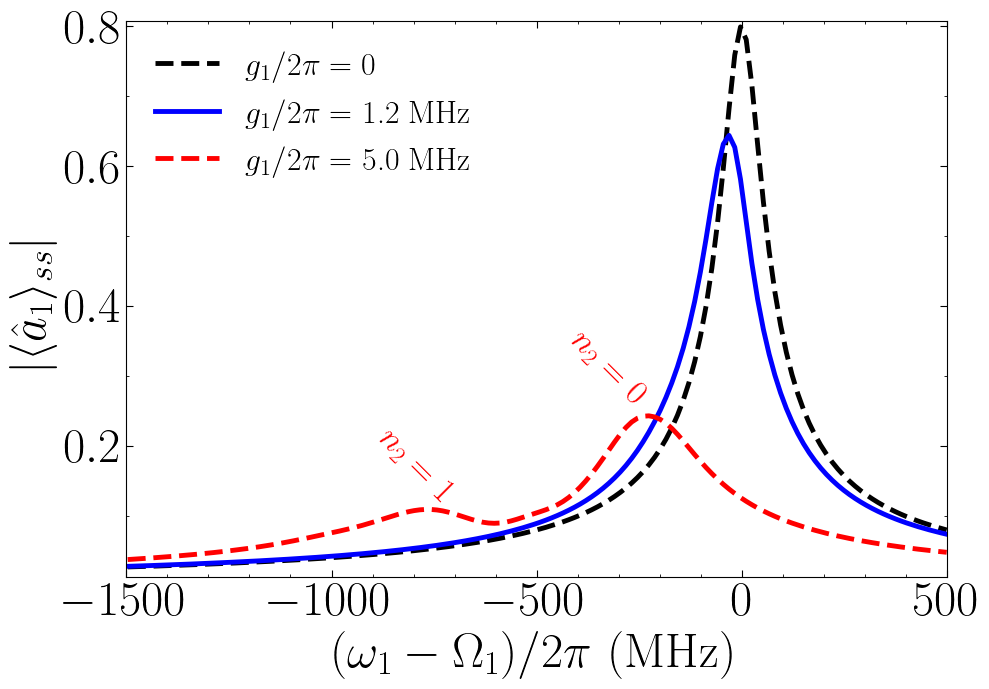

In [94]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]
y_list = [k / (2*pi*1e6) for k in galist]

axes.plot(x_list, A_xy_list_2[0], color='black',
          linestyle='--', label=r'$g_1/2\pi =  0$', lw=3.5)
axes.plot(x_list, A_xy_list_2[10], color='blue', linestyle='-',
          label=r'$g_1/2\pi = $ %.1f MHz' % y_list[10], lw=3.5)
axes.plot(x_list, A_xy_list_2[41], color='red', linestyle='--',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[41], lw=3.5)
#axes.plot(x_list, A_xy_list_2[50], color='red', linestyle=':',
#          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[50], lw=2.5)


axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (MHz)', rotation=0, fontsize=35)
axes.set_ylabel(
    r'$\vert\langle \hat{a}_1\rangle_{ss}\vert$', rotation=90, fontsize=35)

axes.tick_params(axis='both', which='major', direction='in', labelsize=35)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=35)
# axes.yaxis.tick_right()
axes.yaxis.set_ticks_position('both')
axes.legend(loc=2, fontsize=23, frameon=False)
#start, end = axes.get_xlim()
axes.xaxis.set_ticks(arange(-2000, 501, 500))

axes.xaxis.set_ticks_position('both')
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

axes.text(-900, 0.12, r"$n_2 = 1$", color='red', fontsize=25, rotation=-45)
axes.text(-430, 0.26, r"$n_2 = 0$", color='red', fontsize=25, rotation=-45)
axes.set_xlim(-1500, 500)

plt.margins(x=0.01, y=0.01)
plt.tight_layout()
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_1D_a1ss_opt1.pdf')
plt.show()


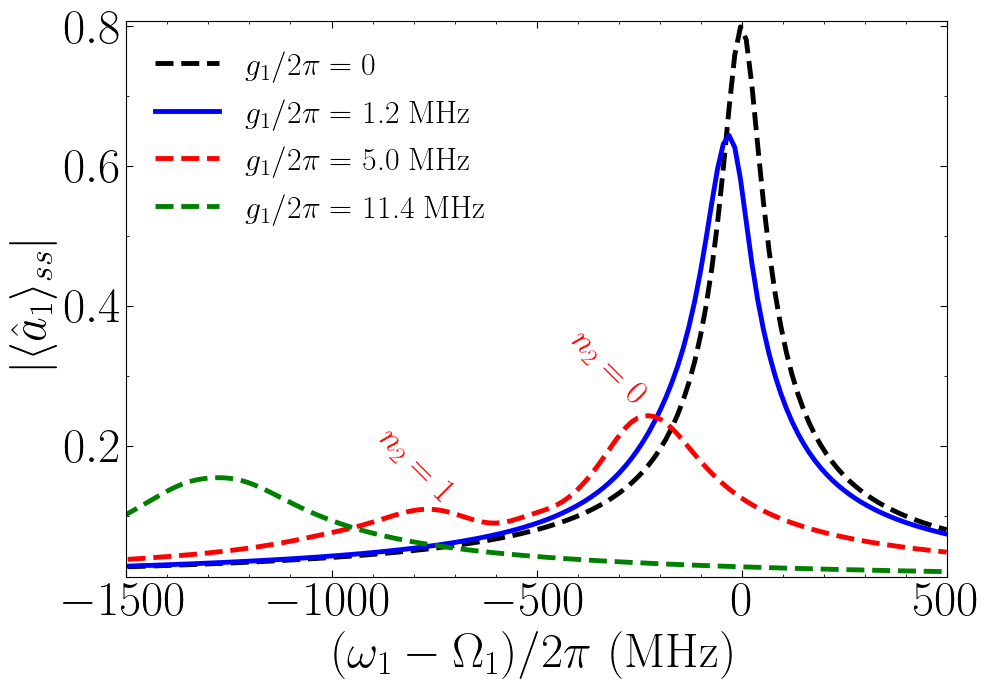

In [95]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]
y_list = [k / (2*pi*1e6) for k in galist]

axes.plot(x_list, A_xy_list_2[0], color='black',
          linestyle='--', label=r'$g_1/2\pi =  0$', lw=3.5)
axes.plot(x_list, A_xy_list_2[10], color='blue', linestyle='-',
          label=r'$g_1/2\pi = $ %.1f MHz' % y_list[10], lw=3.5)
axes.plot(x_list, A_xy_list_2[41], color='red', linestyle='--',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[41], lw=3.5)
axes.plot(x_list, A_xy_list_2[94], color='green', linestyle='--',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[94], lw=3.5)


axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (MHz)', rotation=0, fontsize=35)
axes.set_ylabel(
    r'$\vert\langle \hat{a}_1\rangle_{ss}\vert$', rotation=90, fontsize=35)

axes.tick_params(axis='both', which='major', direction='in', labelsize=35)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=35)
# axes.yaxis.tick_right()
axes.yaxis.set_ticks_position('both')
axes.legend(loc=2, fontsize=23, frameon=False)
#start, end = axes.get_xlim()
axes.xaxis.set_ticks(arange(-2000, 501, 500))

axes.xaxis.set_ticks_position('both')
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

axes.text(-900, 0.12, r"$n_2 = 1$", color='red', fontsize=25, rotation=-45)
axes.text(-430, 0.26, r"$n_2 = 0$", color='red', fontsize=25, rotation=-45)
axes.set_xlim(-1500, 500)

plt.margins(x=0.01, y=0.01)
plt.tight_layout()
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_1D_a1ss_opt2.pdf')
plt.show()


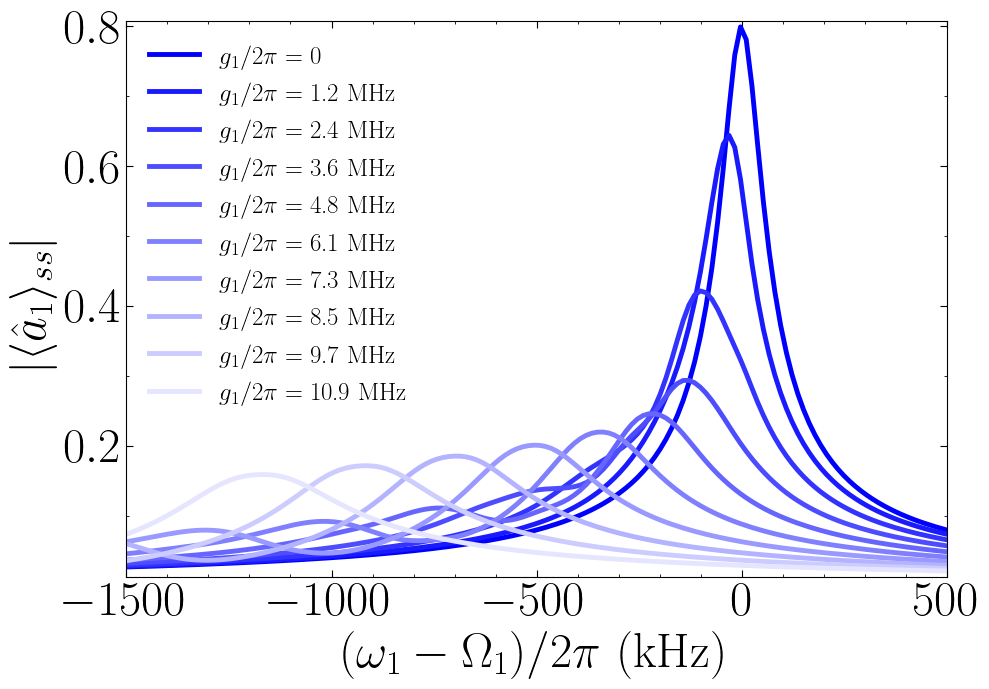

In [96]:
def lighten_color(color, amount=0.5):
    """
    Lightens the given color by multiplying (1-luminosity) by the given amount.
    Input can be matplotlib color string, hex string, or RGB tuple.

    Examples:
    >> lighten_color('g', 0.3)
    >> lighten_color('#F034A3', 0.6)
    >> lighten_color((.3,.55,.1), 0.5)
    """
    import matplotlib.colors as mc
    import colorsys
    try:
        c = mc.cnames[color]
    except:
        c = color
    c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])

fig, axes = plt.subplots(1, 1, figsize=(10, 7))

x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]
y_list = [k / (2*pi*1e6) for k in galist]

linew = 3.5

axes.plot(x_list, A_xy_list_2[0], color='blue',
          linestyle='-', label=r'$g_1/2\pi =  0$', lw=linew)
axes.plot(x_list, A_xy_list_2[10], color=lighten_color('blue',0.9), linestyle='-',
          label=r'$g_1/2\pi = $ %.1f MHz' % y_list[10], lw=linew)
axes.plot(x_list, A_xy_list_2[20], color=lighten_color('blue',0.8), linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[20], lw=linew)
axes.plot(x_list, A_xy_list_2[30], color=lighten_color('blue',0.7), linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[30], lw=linew)
axes.plot(x_list, A_xy_list_2[40], color=lighten_color('blue',0.6), linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[40], lw=linew)
axes.plot(x_list, A_xy_list_2[50], color=lighten_color('blue',0.5), linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[50], lw=linew)
axes.plot(x_list, A_xy_list_2[60], color=lighten_color('blue',0.4), linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[60], lw=linew)
axes.plot(x_list, A_xy_list_2[70], color=lighten_color('blue',0.3), linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[70], lw=linew)
axes.plot(x_list, A_xy_list_2[80], color=lighten_color('blue',0.2), linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[80], lw=linew)
axes.plot(x_list, A_xy_list_2[90], color=lighten_color('blue',0.1), linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[90], lw=linew)


axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=35)
axes.set_ylabel(
    r'$\vert\langle \hat{a}_1\rangle_{ss}\vert$', rotation=90, fontsize=35)

axes.tick_params(axis='both', which='major', direction='in', labelsize=35)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=35)
# axes.yaxis.tick_right()
axes.yaxis.set_ticks_position('both')
axes.legend(loc=2, fontsize=18, frameon=False)
#start, end = axes.get_xlim()
axes.xaxis.set_ticks(arange(-2000, 501, 500))

axes.xaxis.set_ticks_position('both')
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

#axes.text(-900, 0.12, r"$n_2 = 1$", color='blue', fontsize=25, rotation=-45)
#xes.text(-430, 0.26, r"$n_2 = 0$", color='blue', fontsize=25, rotation=-45)
axes.set_xlim(-1500, 500)

plt.margins(x=0.01, y=0.01)
plt.tight_layout()
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_1D_a1ss_opt3.pdf')
plt.show()


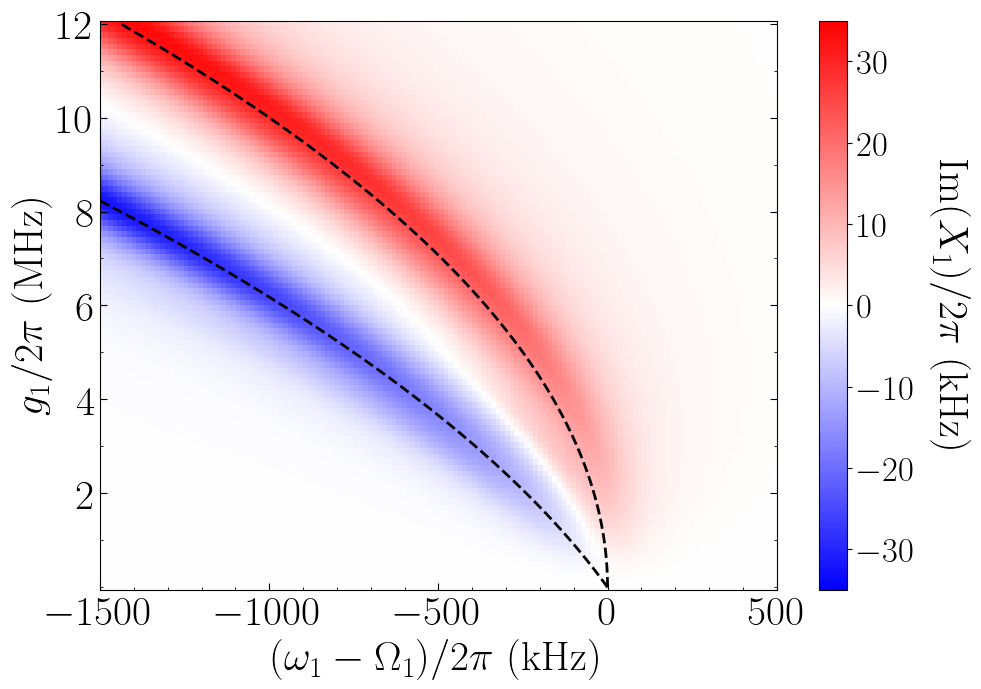

In [128]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
z_list = [[k / (2*pi*1e3) for k in i] for i in imS_minus_xy_list]

nrm = mpl.colors.Normalize(-35, 35)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(shift_curve, y_list, '--', color='black', lw=2.0)
axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
axes.set_xlim(-1500, 500)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=Lsize)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Im$(X_1)/2\pi$ (kHz)',labelpad=40, rotation=270, fontsize=Lsize)
plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_2D_ImX.pdf')
plt.show()


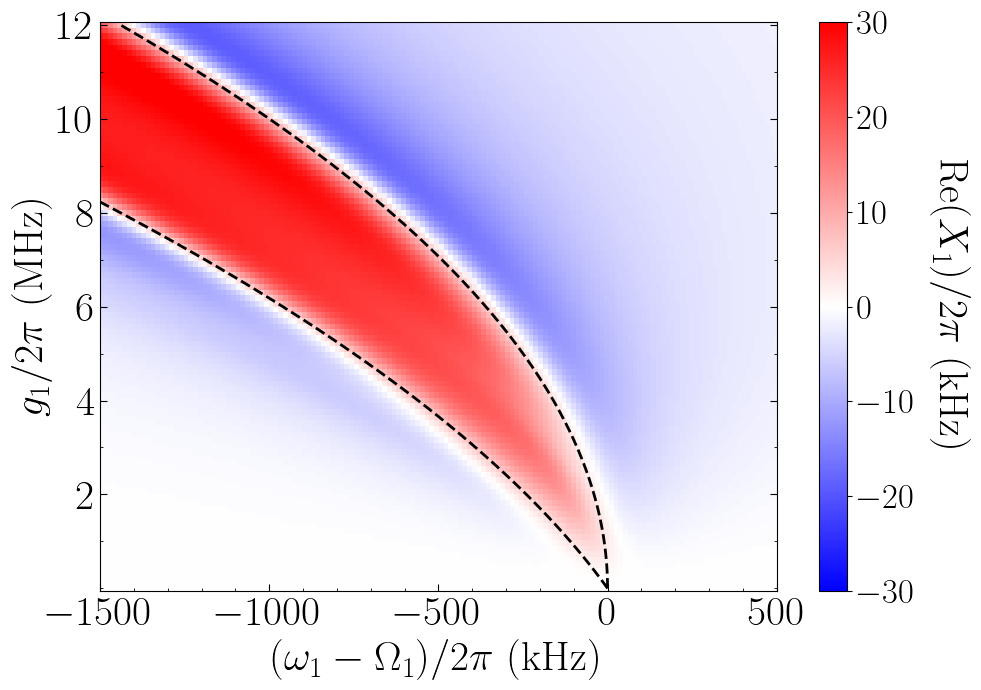

In [129]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
z_list = [[k / (2*pi*1e3) for k in i] for i in reS_minus_xy_list]

nrm = mpl.colors.Normalize(-30, 30)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(shift_curve, y_list, '--', color='black', lw=2.0)
axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
axes.set_xlim(-1500, 500)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=Lsize)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
cbar = plt.colorbar()

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Re$(X_1)/2\pi$ (kHz)',labelpad=40, rotation=270, fontsize=Lsize)
plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_2D_ReX.pdf')
plt.show()


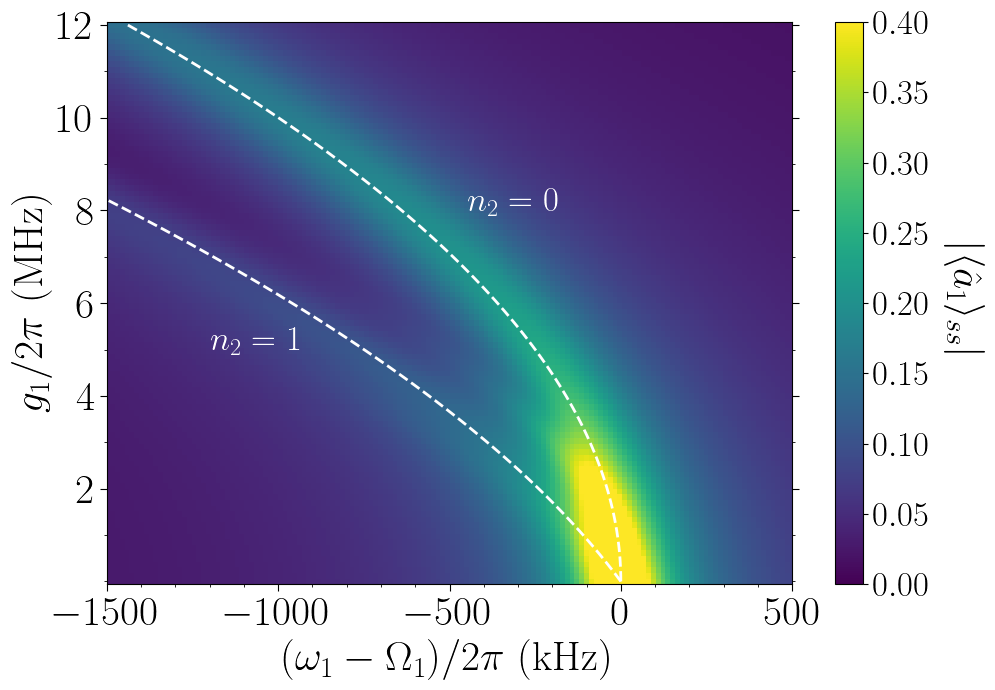

In [131]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e6) for k in galist]
nrm = mpl.colors.Normalize(0, 0.4)
axes.pcolormesh(x_list, y_list, A_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)


plt.pcolormesh(x_list, y_list, A_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_1 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a1ss.pdf')
plt.show()


In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
nrm = mpl.colors.Normalize(0, 1)
axes.pcolormesh(x_list, y_list, pA0_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
yyy = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(yyy, y_list, '--', color='black', lw=2.0)
axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_title(r'Cavity 1', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, pA0_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 0\vert \hat \rho \vert n_1 = 0\rangle$', rotation=270, fontsize=30)
plt.tight_layout()

plt.savefig('pop1_0_01.pdf')
plt.show()

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
nrm = mpl.colors.Normalize(0, 0.2)
axes.pcolormesh(x_list, y_list, pA1_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
yyy = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(yyy, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_title(r'Cavity 1', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, pA1_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 1\vert \hat \rho \vert n_1 = 1\rangle$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, pA1_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig('pop1_1_00.pdf')
plt.show()

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
nrm = mpl.colors.Normalize(0, .1)
axes.pcolormesh(x_list, y_list, pA2_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
yyy = [-(2*k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(2*k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(yyy, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_title(r'Cavity 1', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, pA2_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 2\vert \hat \rho \vert n_1 = 2\rangle$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, pA2_xy_list)
# axes.clabel(cp, inline=True,
#          fontsize=16)

plt.savefig('pop1_2_1.pdf')
plt.show()

In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [2*k**2 / (kappa_a*wr) for k in galist]
nrm = mpl.colors.Normalize(0, .1)
axes.pcolormesh(x_list, y_list, pA2_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
y1 = [-(2*k**2)/(2*pi*wr*1e3) for k in galist]
y2 = [(-(2*k**2)/(2*pi*wr*1e3))-((k*gb)/(2*pi*wr*1e3)) for k in galist]
y3 = [(-(2*k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
y4 = [(-(k**2)/(2*pi*wr*1e3)) for k in galist]
#axes.plot(y1, y_list, ':', color='white', lw=2.0)
#axes.plot(y2, y_list, ':', color='white', lw=2.0)
#axes.plot(y3, y_list, ':', color='white', lw=2.0)
#axes.plot(y4, y_list, ':', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_ylim(0.00001, 5)
axes.set_title(r'Cavity 1', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$(2 g_1^2/\omega_r)/\kappa_1$', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
#axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, pA2_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 2\vert \hat \rho \vert n_1 = 2\rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('pop1_2_01.pdf')
plt.show()


In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e6) for k in galist]
nrm = mpl.colors.Normalize(0, 0.5)
axes.pcolormesh(x_list, y_list, Na_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(shift_curve, y_list, ':', color='white', lw=2.0)
axes.plot(yyy2, y_list, ':', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, Na_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\langle \hat N_1 \rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('N1_01.pdf')
plt.show()


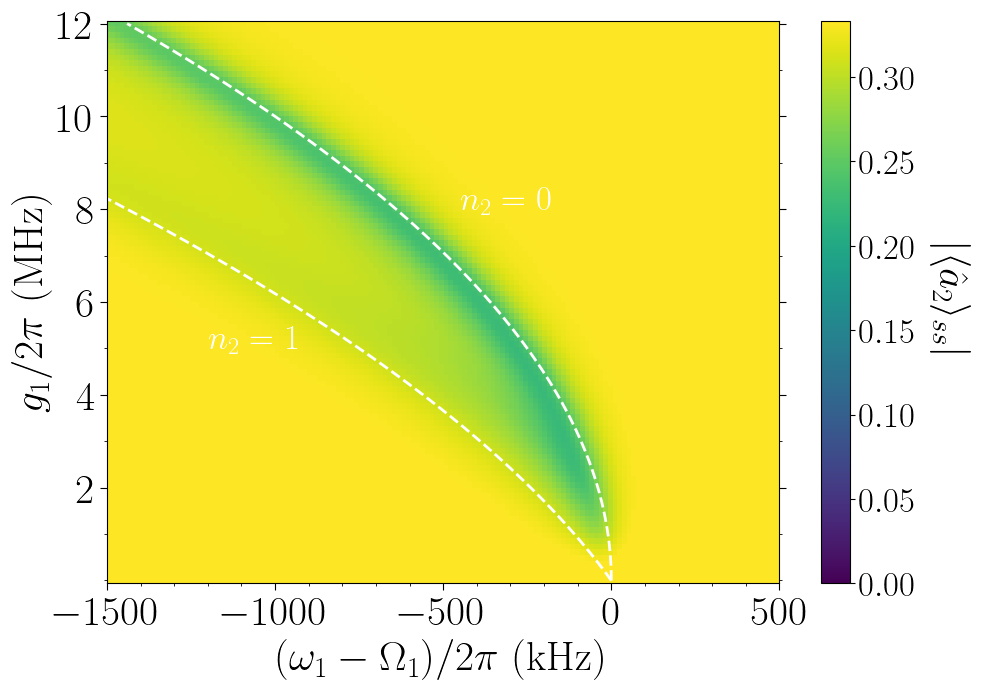

In [141]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e6) for k in galist]
nrm = mpl.colors.Normalize(0, max(B_xy_list[0]))
axes.pcolormesh(x_list, y_list, B_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)


plt.pcolormesh(x_list, y_list, B_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_2 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a2ss.pdf')
plt.show()


In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
nrm = mpl.colors.Normalize(0, max(Nb_xy_list[0]))
axes.pcolormesh(x_list, y_list, Nb_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in galist]
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(2*k**2)/(2*pi*wr*1e3))-((k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(shift_curve, y_list, ':', color='black', lw=2.0)
axes.plot(yyy2, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, Nb_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\langle \hat N_2 \rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('N2_00.pdf')
plt.show()


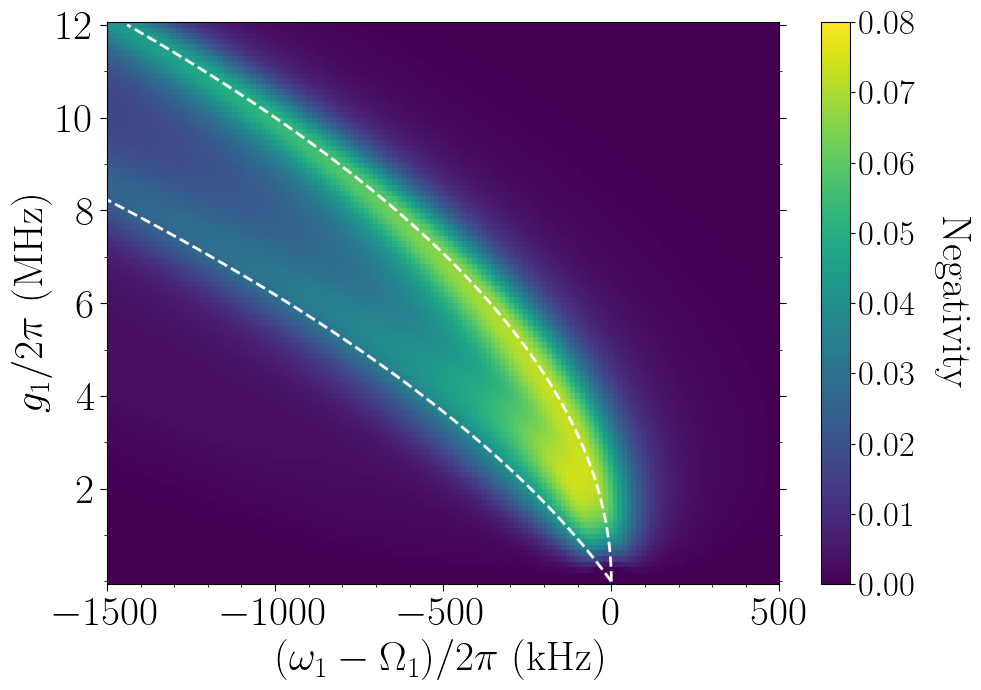

In [144]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e6) for k in galist]
nrm = mpl.colors.Normalize(0, 0.08)
axes.pcolormesh(x_list, y_list, neg_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
yyy = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(yyy, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, neg_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Negativity', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_negativity_2D.pdf')
plt.show()


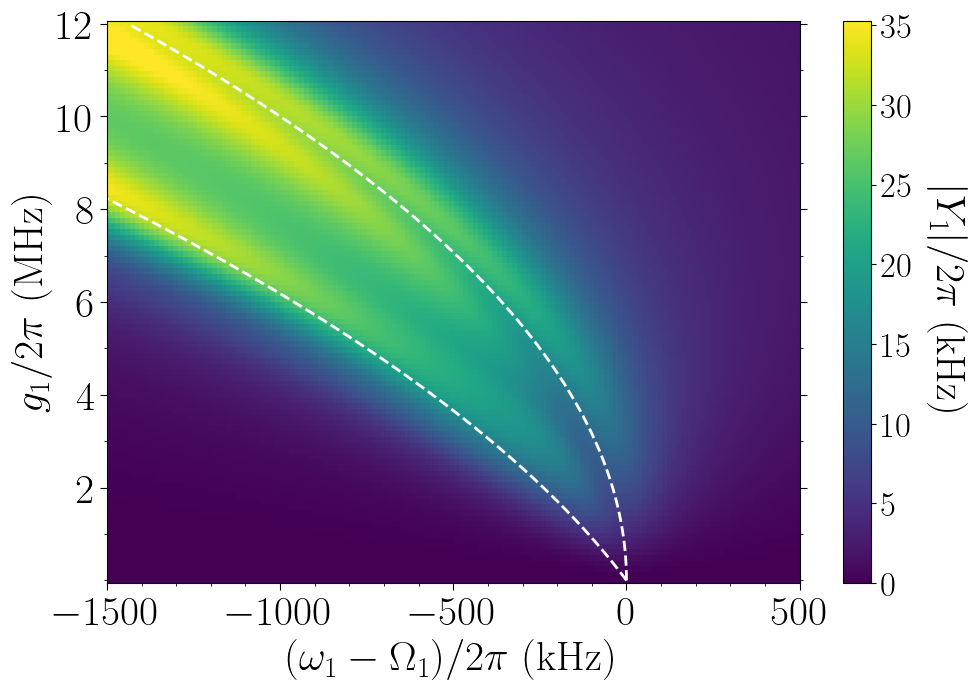

In [150]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e6) for k in galist]
z_list = [[k / (2*pi*1e3) for k in i] for i in S_plus_xy_list]
nrm = mpl.colors.Normalize(0, max(z_list[89]))
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis,
                norm=nrm, shading='auto')
yyy = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(yyy, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis,
               norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert Y_1\vert/2\pi$ (kHz)', labelpad=40, rotation=270, fontsize=30)
plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_2D_absY1.pdf')
plt.show()


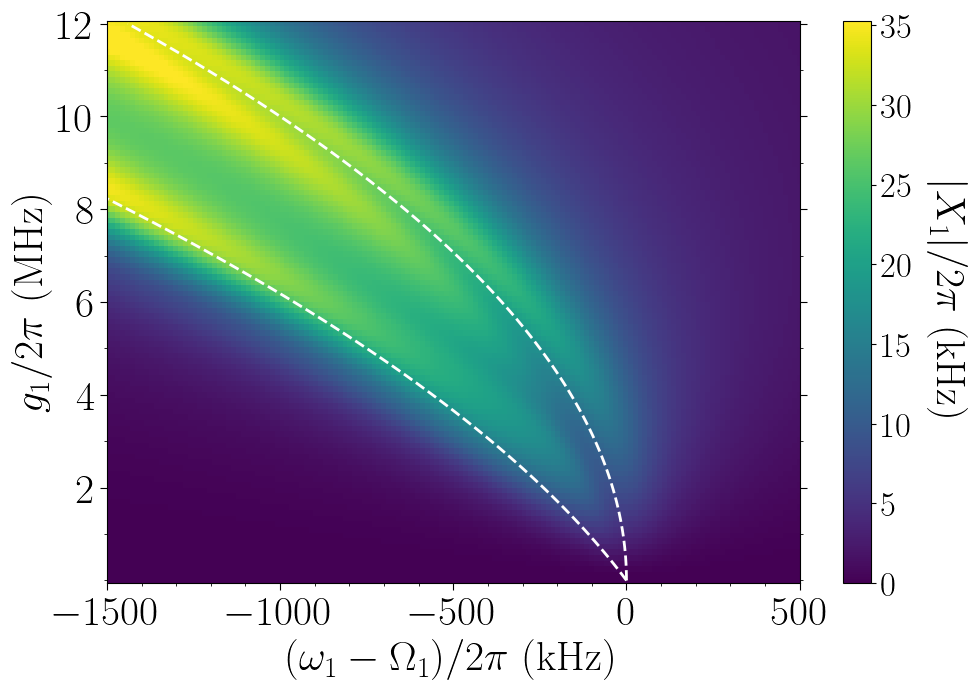

In [151]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
z_list = [[k / (2*pi*1e3) for k in i] for i in S_minus_xy_list]
nrm = mpl.colors.Normalize(0, max(z_list[89]))
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis,
                norm=nrm, shading='auto')
yyy = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(yyy, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis,
               norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_1\vert/2\pi$ (kHz)',labelpad=40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, z_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)


plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_2D_absX1.pdf')
plt.show()


In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
z_list = [[abs(k) / (2*pi*1e3) for k in i] for i in T_xy_list]
nrm = mpl.colors.Normalize(0, 10)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis,
                norm=nrm, shading='auto')
yyy = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(yyy, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-2000, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis,
               norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_1\vert/2\pi$ (kHz)', rotation=90, fontsize=30)
plt.tight_layout()

#plt.savefig('absX1_01.pdf')
plt.show()


In [ ]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in galist]
z_list = [[k / (2*pi*1e3) for k in i] for i in DeltaE_xy_list]
nrm = mpl.colors.Normalize(min(z_list[94]), 0)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis,
                norm=nrm, shading='auto')
yyy = [-(k**2)/(2*pi*wr*1e3) for k in galist]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
axes.plot(yyy, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)
axes.set_xlim(-2000, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis,
               norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_1\vert/2\pi$ (kHz)', rotation=90, fontsize=30)
plt.tight_layout()

#plt.savefig('absX1_01.pdf')
plt.show()


### Plot Pairs


In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(18, 7))

y1 = [-(k**2)/(2*pi*wr*1e3) for k in galist]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]

y_list = [k / (2*pi*1e6) for k in galist]
z1_list = [[k / (2*pi*1e3) for k in i] for i in S_minus_xy_list]
z2_list = [[k / (2*pi*1e3) for k in i] for i in S_plus_xy_list]

nrm1 = mpl.colors.Normalize(0, max(z1_list[89]))
axes[0].pcolormesh(x_list, y_list, z1_list, cmap=cm.viridis,
                   norm=nrm1, shading='auto')
axes[0].plot(y1, y_list, ':', color='white', lw=2.0)
axes[0].plot(y2, y_list, ':', color='white', lw=2.0)
axes[0].set_xlim(-1500, 500)
axes[0].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=30)
axes[0].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes[0].tick_params(axis='both', which='major', direction='out', labelsize=30)
axes[0].tick_params(axis='both', which='minor', labelsize=30)
axes[0].yaxis.set_ticks(arange(2, 12.1, 2))
axes[0].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z1_list, cmap=cm.viridis,
               norm=nrm1, shading='auto')
cbar = plt.colorbar(ax=axes[0])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_1\vert/2\pi$ (kHz)', rotation=90, fontsize=30)


nrm2 = mpl.colors.Normalize(0, max(z2_list[89]))
axes[1].pcolormesh(x_list, y_list, z2_list, cmap=cm.viridis,
                   norm=nrm2, shading='auto')
axes[1].plot(y1, y_list, ':', color='white', lw=2.0)
axes[1].plot(y2, y_list, ':', color='white', lw=2.0)
axes[1].set_xlim(-1500, 500)
axes[1].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=30)
axes[1].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes[1].tick_params(axis='both', which='major', direction='out', labelsize=30)
axes[1].tick_params(axis='both', which='minor', labelsize=30)
axes[1].yaxis.set_ticks(arange(2, 12.1, 2))
axes[1].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z2_list, cmap=cm.viridis,
               norm=nrm2, shading='auto')
cbar = plt.colorbar(ax=axes[1])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert Y_1\vert/2\pi$ (kHz)', rotation=90, fontsize=30)

plt.tight_layout()

plt.savefig('absXY_00.pdf')
plt.show()


## 3. Simulation 2


In [92]:

wa = 2 * pi * 5.1 * 1e9  # 5.1 GHz
wb = 2 * pi * 5.7 * 1e9  # 5.7 GHz
wr = 2 * pi * 100 * 1e6  # 100 MHz

ohm_a_initial = wa - 2 * pi * 1.5 * 1e6  # -1500 kHz
ohm_a_final = wa + 2 * pi * 0.5 * 1e6  # 500 kHz

ohm_b_initial = wb - 2 * pi * 1.5 * 1e6  # -1500 kHz
ohm_b_final = wb + 2 * pi * 0.5 * 1e6  # 500 kHz

ohm_a_list = linspace(ohm_a_initial, ohm_a_final, 180)
ohm_b_list = linspace(ohm_b_initial, ohm_b_final, 180)

# Dissipation rates
kappa_a = 2 * pi * 100 * 1e3   # 100 kHz
kappa_b = 2 * pi * 100 * 1e3   # 100 kHz
gamma = 100 * kappa_a          # 10 MHz

T = 0                              # Temperature
w_th = (sc.k*T)/(sc.hbar)

# avg number of thermal bath excitation coupled to r
n_th_r = n_thermal(wr, w_th)

# Operators
N = 3
a = tensor(destroy(N), qeye(N), qeye(N))
b = tensor(qeye(N), destroy(N), qeye(N))
r = tensor(qeye(N), qeye(N), destroy(N))
Na = a.dag() * a
Nb = b.dag() * b
Nr = r.dag() * r
Xa = a.dag() + a
Xb = b.dag() + b
Xr = r.dag() + r

A_xy_list = []
A_xy_list_2 = []
B_xy_list = []
Na_xy_list = []
Nb_xy_list = []

pA0_xy_list = []
pA1_xy_list = []
pA2_xy_list = []

pB0_xy_list = []
pB1_xy_list = []
pB2_xy_list = []

S_plus_xy_list = []
S_minus_xy_list = []
reS_plus_xy_list = []
reS_minus_xy_list = []
imS_plus_xy_list = []
imS_minus_xy_list = []
neg_xy_list = []

DeltaE_xy_list = []
T_xy_list = []


for k in range(len(ohm_b_list)):

    # Field operators
    a_list = []
    b_list = []
    Na_list = []
    Nb_list = []
    a_list_2 = []

    # Entanglement
    S_plus_list = []
    S_minus_list = []
    reS_plus_list = []
    reS_minus_list = []
    imS_plus_list = []
    imS_minus_list = []
    neg_list = []

    DeltaE_list = []
    T_list = []

    # Populations
    pA_0_list = []
    pB_0_list = []
    pA_1_list = []
    pB_1_list = []
    pA_2_list = []
    pB_2_list = []

    for i in range(len(ohm_a_list)):

        ga = 2 * pi * 5 * 1e6
        gb = 2 * pi * 5 * 1e6          # Fixed at 5 MHz

        chiA = ((ga**2)/wr)
        chiB = ((gb**2)/wr)
        chiAB = ((gb*ga)/wr)

        E_a = 2 * pi * 40 * 1e3
        Ohm_a = ohm_a_list[i]

        E_b = 2 * pi * 40 * 1e3
        Ohm_b = ohm_b_list[k]

        Hvec = []
        Hvec.append((wa-Ohm_a) * Na)
        Hvec.append((wb-Ohm_b) * Nb)
        Hvec.append(wr * Nr)
        Hvec.append(-ga * Na * Xr)
        Hvec.append(-gb * Nb * Xr)
        Hvec.append(E_a * Xa)
        Hvec.append(E_b * Xb)
        H = 0
        for i in range(len(Hvec)):
            H = H + Hvec[i]

        c_ops = []
        rate = kappa_a
        if rate > 0.0:
            c_ops.append(sqrt(rate) * a)

        rate = kappa_b
        if rate > 0.0:
            c_ops.append(sqrt(rate) * b)

        rate = gamma * (1 + n_th_r)
        if rate > 0.0:
            c_ops.append(sqrt(rate) * r)

        #rate = gamma * n_th_r
        # if rate > 0.0:
        #    c_ops.append(sqrt(rate) * r.dag())

        rho_ss = steadystate(H, c_ops)
        chi_ss = rho_ss - tensor(ptrace(rho_ss, (0)),
                                 ptrace(rho_ss, (1)), ptrace(rho_ss, (2)))

        #S_plus_matrix  = chi_ss * b.dag() * b * a.dag()
        #S_minus_matrix = chi_ss * b.dag() * b * a

        #S_plus  = (2* ga * gb / wr) * S_plus_matrix.tr()
        #S_minus = (2* ga * gb / wr) * S_minus_matrix.tr()

        S_plus = (2 * ga * gb / wr) * expect(b.dag() * b * a.dag(), chi_ss)
        S_minus = (2 * ga * gb / wr) * expect(b.dag() * b * a, chi_ss)

        S_plus_list.append(abs(S_plus))
        S_minus_list.append(abs(S_minus))

        reS_plus_list.append(real(S_plus))
        reS_minus_list.append(real(S_minus))

        imS_plus_list.append(imag(S_plus))
        imS_minus_list.append(imag(S_minus))

        #a_ss = expect(a, rho_ss)
        a_ss = (rho_ss * a).tr()
        b_ss = expect(b, rho_ss)

        aada = expect(a * a.dag() * a, rho_ss)
        #adada = expect(a.dag() * a.dag() * a, rho_ss)
        #bbdb = expect(b * b.dag() * b, rho_ss)

        pol_arg = (r - r.dag()) * ((ga/wr) * Na + (gb/wr) * Nb)
        pol = pol_arg.expm()
        #pol_arg_half = (pol_arg / 2)
        #pol_half = pol_arg_half.expm()

        na_ss = expect(Na, rho_ss)
        nb_ss = expect(Nb, rho_ss)

        rho_p = pol * rho_ss * pol.dag()

        a_ss_2 = (E_a - ga * (rho_p * a * Xr).tr() - (2 * ga**2 / wr) * aada - S_minus) / \
            ((-ga**2 / wr) + 1j * (kappa_a/2) + 2 * chiAB * nb_ss - wa + Ohm_a)
        a_list_2.append(a_ss_2)

        a_list.append(a_ss)
        b_list.append(b_ss)

        Na_list.append(abs(na_ss))
        Nb_list.append(abs(nb_ss))

        rhoAB = ptrace(rho_ss, (0, 1))
        rhoA = ptrace(rhoAB, (0))
        rhoB = ptrace(rhoAB, (1))

        # Ground state
        p0A = (fidelity(rhoA, fock(N, 0)))**2
        p0B = (fidelity(rhoB, fock(N, 0)))**2
        # First excited state
        p1A = (fidelity(rhoA, fock(N, 1)))**2
        p1B = (fidelity(rhoB, fock(N, 1)))**2
        # Second excited state
        p2A = (fidelity(rhoA, fock(N, 2)))**2
        p2B = (fidelity(rhoB, fock(N, 2)))**2

        pA_0_list.append(p0A)
        pB_0_list.append(p0B)
        pA_1_list.append(p1A)
        pB_1_list.append(p1B)
        pA_2_list.append(p2A)
        pB_2_list.append(p2B)

        neg = negativity(rhoAB, 0, method='eigenvalues')
        neg_list.append(neg)

    #fig, axes = plt.subplots(1,1, figsize=(10,7))

    absA_list = [abs(k) for k in a_list]
    absA_list_2 = [abs(k) for k in a_list_2]
    absB_list = [abs(k) for k in b_list]
    x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]

    #maxA_2 = max(absA_list_2)

    #absA_list_norm_2 = [k / maxA_2  for k in absA_list_2]

    #axes.plot(x_list,absA_list,label=r'$\langle \hat{a} \rangle$', lw=2.0)
    #axes.plot(x_list,absB_list,label=r'$\langle \hat{b} \rangle$', lw=2.0)
    #axes.plot(x_list,Na_list,label=r'$\vert\langle \hat{a}^\dagger\hat{a} \rangle\vert$', lw=2.0)
    #axes.plot(x_list,Nb_list,label=r'$\langle \hat{b}^\dagger\hat{b} \rangle\vert$', lw=2.0)

    #xposition = [-chiA/ (2*pi*1e3),-chiA/ (2*pi*1e3)-chiAB/ (2*pi*1e3)]
    #plt.axvline(x=xposition[0], color='blue', linestyle='--')
    #plt.axvline(x=xposition[1], color='red', linestyle='--')

    #axes.set_xlabel(r'$\omega_a - \omega_a^d$ (kHz)',rotation=0,fontsize= 20.0)
    #axes.set_ylabel(r'$\langle \hat{a}\rangle$',rotation=90,fontsize= 22.0)
    #axes.tick_params(axis='both', which='major', labelsize=16)
    #axes.tick_params(axis='both', which='minor', labelsize=16)
    # axes.legend(loc=1,fontsize=16)

    A_xy_list.append(absA_list)
    A_xy_list_2.append(absA_list_2)
    B_xy_list.append(absB_list)
    Na_xy_list.append(Na_list)
    Nb_xy_list.append(Nb_list)

    pA0_xy_list.append(pA_0_list)
    pA1_xy_list.append(pA_1_list)
    pA2_xy_list.append(pA_2_list)

    pB0_xy_list.append(pB_0_list)
    pB1_xy_list.append(pB_1_list)
    pB2_xy_list.append(pB_2_list)

    S_plus_xy_list.append(S_plus_list)
    S_minus_xy_list.append(S_minus_list)
    reS_plus_xy_list.append(reS_plus_list)
    reS_minus_xy_list.append(reS_minus_list)
    imS_plus_xy_list.append(imS_plus_list)
    imS_minus_xy_list.append(imS_minus_list)
    neg_xy_list.append(neg_list)

    print('%d/99' % k)


0/99
1/99
2/99
3/99
4/99
5/99
6/99
7/99
8/99
9/99
10/99
11/99
12/99
13/99
14/99
15/99
16/99
17/99
18/99
19/99
20/99
21/99
22/99
23/99
24/99
25/99
26/99
27/99
28/99
29/99
30/99
31/99
32/99
33/99
34/99
35/99
36/99
37/99
38/99
39/99
40/99
41/99
42/99
43/99
44/99
45/99
46/99
47/99
48/99
49/99
50/99
51/99
52/99
53/99
54/99
55/99
56/99
57/99
58/99
59/99
60/99
61/99
62/99
63/99
64/99
65/99
66/99
67/99
68/99
69/99
70/99
71/99
72/99
73/99
74/99
75/99
76/99
77/99
78/99
79/99
80/99
81/99
82/99
83/99
84/99
85/99
86/99
87/99
88/99
89/99
90/99
91/99
92/99
93/99
94/99
95/99
96/99
97/99
98/99
99/99
100/99
101/99
102/99
103/99
104/99
105/99
106/99
107/99
108/99
109/99
110/99
111/99
112/99
113/99
114/99
115/99
116/99
117/99
118/99
119/99
120/99
121/99
122/99
123/99
124/99
125/99
126/99
127/99
128/99
129/99
130/99
131/99
132/99
133/99
134/99
135/99
136/99
137/99
138/99
139/99
140/99
141/99
142/99
143/99
144/99
145/99
146/99
147/99
148/99
149/99
150/99
151/99
152/99
153/99
154/99
155/99
156/99
157/99
158/

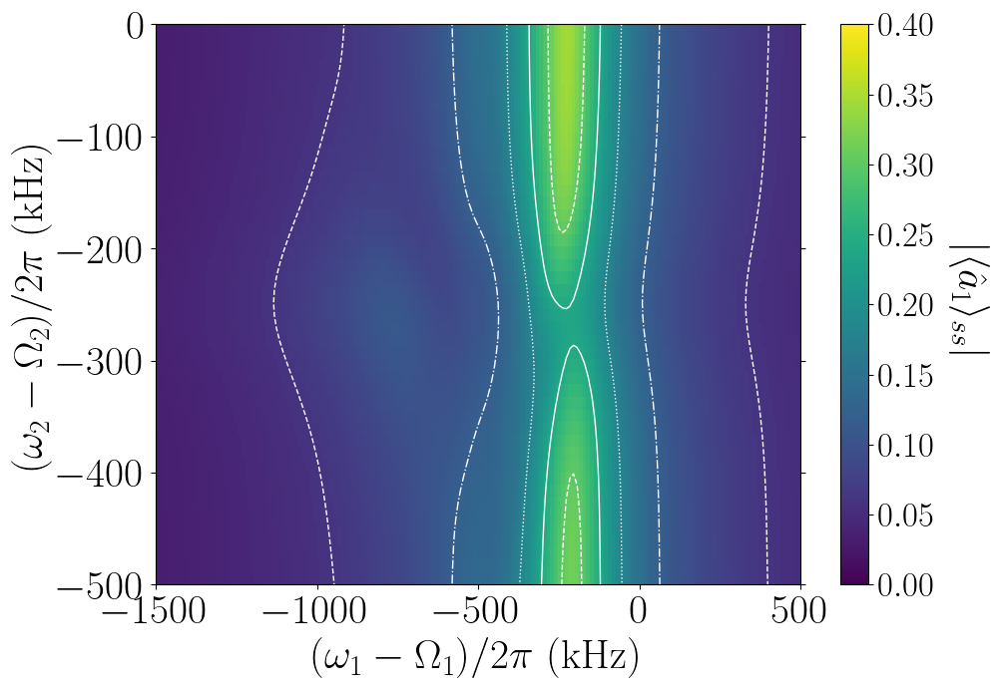

In [93]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]
y_list = [(k-wb) / (2*pi*1e3) for k in ohm_b_list]

nrm = mpl.colors.Normalize(0, 0.4)
axes.pcolormesh(x_list, y_list, A_xy_list_2,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in ohm_b_list]
yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in ohm_b_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)


axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$(\omega_2 - \Omega_2)/2\pi$ (kHz)',
                rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(-500, 1, 100))
axes.yaxis.set_ticks_position('both')
#axes.text(-1150, -700, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(0, -700, r"$n_2 = 0$", color='white', fontsize=25)

axes.set_xlim(-1500, 500)
axes.set_ylim(-500, 0)

plt.pcolormesh(x_list, y_list, A_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_1 \rangle_{ss}\vert$', labelpad=40, rotation=270, fontsize=30)

cp = axes.contour(x_list, y_list, A_xy_list_2, levels=5, colors = 'white', linewidths = 1., linestyles = [ 'solid', 'dashed', 'dashdot', 'dotted'])
axes.clabel(cp, inline=True,
            fontsize=14)

plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a1ss_detuning_opt1.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a1ss_detuning_opt1.pdf')
plt.show()


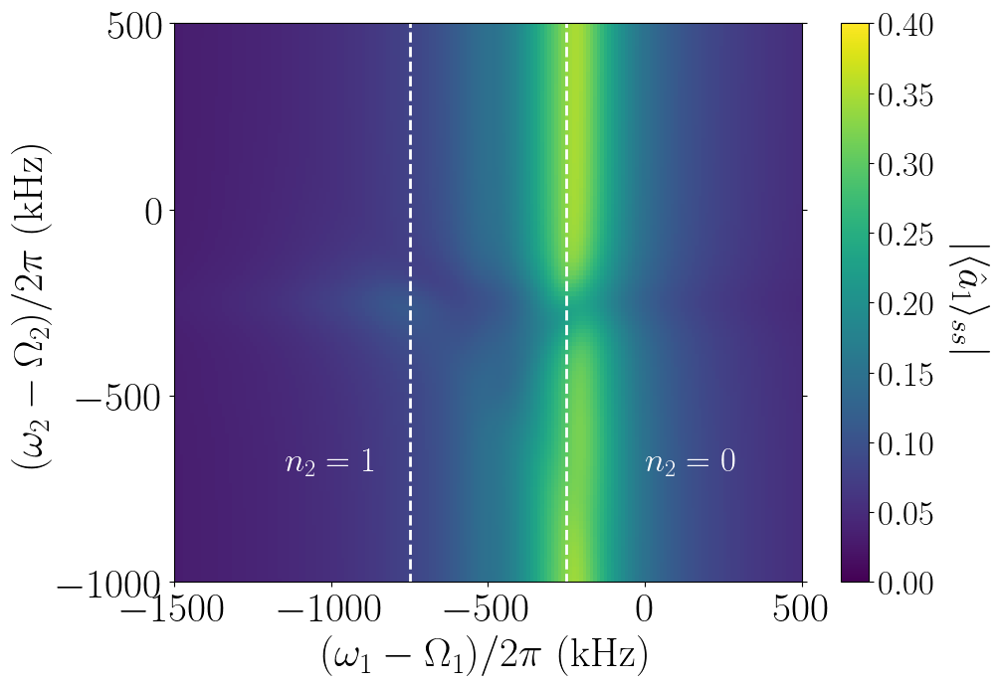

In [95]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]
y_list = [(k-wb) / (2*pi*1e3) for k in ohm_b_list]

nrm = mpl.colors.Normalize(0, 0.4)
axes.pcolormesh(x_list, y_list, A_xy_list_2,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in ohm_b_list]
yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in ohm_b_list]
axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
axes.plot(yyy2, y_list, '--', color='white', lw=2.0)


axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$(\omega_2 - \Omega_2)/2\pi$ (kHz)',
                rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
axes.text(-1150, -700, r"$n_2 = 1$", color='white', fontsize=25)
axes.text(0, -700, r"$n_2 = 0$", color='white', fontsize=25)

axes.set_xlim(-1500, 500)
axes.set_ylim(-1000, 500)

plt.pcolormesh(x_list, y_list, A_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_1 \rangle_{ss}\vert$', labelpad=40, rotation=270, fontsize=30)

#cp = axes.contour(x_list, y_list, A_xy_list_2, levels=5, colors = 'white', linewidths = 1., linestyles = [ 'solid', 'dashed', 'dashdot', 'dotted'])
#axes.clabel(cp, inline=True,
#            fontsize=14)

plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a1ss_detuning_opt2.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a1ss_detuning_opt2.pdf')
plt.show()


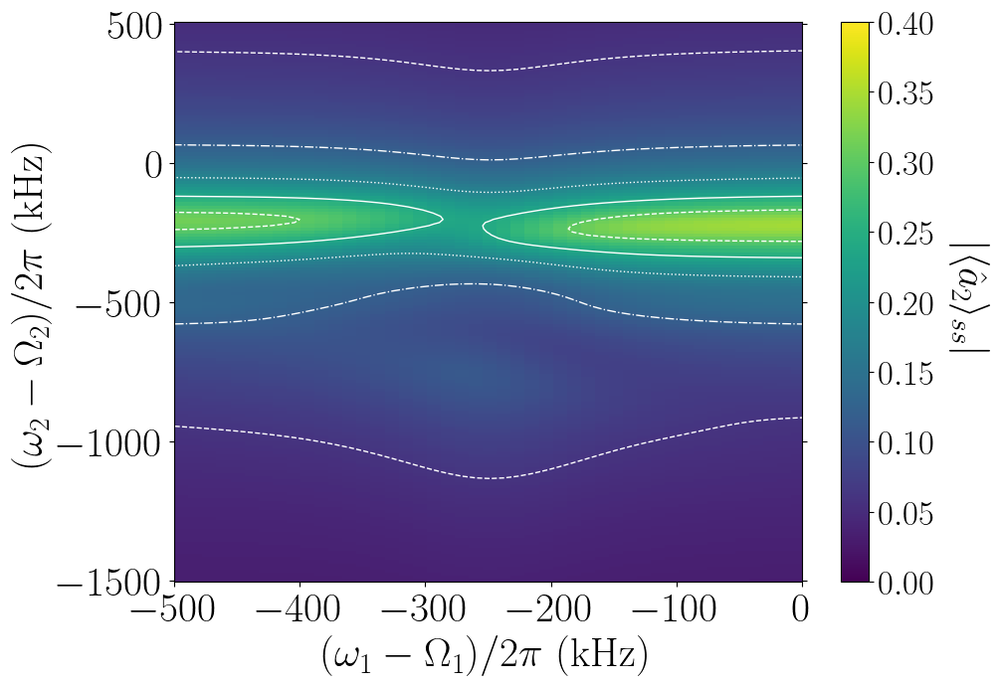

In [50]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]
y_list = [(k-wb) / (2*pi*1e3) for k in ohm_b_list]

nrm = mpl.colors.Normalize(0, 0.4)
axes.pcolormesh(x_list, y_list, B_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in ohm_b_list]
yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in ohm_b_list]
#axes.plot(y_list, shift_curve, ':', color='white', lw=2.0)
#axes.plot(y_list, yyy2, ':', color='white', lw=2.0)

axes.set_xlim(-500, 0)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$(\omega_2 - \Omega_2)/2\pi$ (kHz)',
                rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(0, -950, r"$n_1 = 1$", color='white', fontsize=25)
#axes.text(0, -50, r"$n_1 = 0$", color='white', fontsize=25)
plt.pcolormesh(x_list, y_list, B_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_2 \rangle_{ss}\vert$',labelpad=40, rotation=270, fontsize=30)

cp = axes.contour(x_list, y_list, B_xy_list, levels=5, colors = 'white', linewidths = 1., linestyles = [ 'solid', 'dashed', 'dashdot', 'dotted'])
axes.clabel(cp, inline=True,
            fontsize=14)

plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a2ss_detuning_opt1.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a2ss_detuning_opt1.pdf')
plt.show()


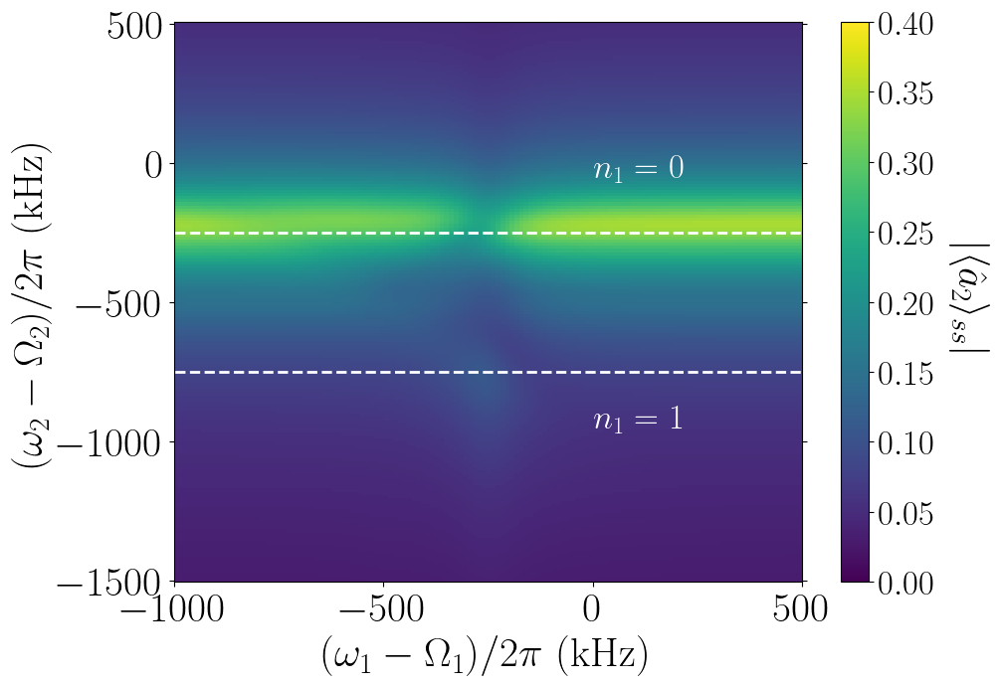

In [56]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]
y_list = [(k-wb) / (2*pi*1e3) for k in ohm_b_list]

nrm = mpl.colors.Normalize(0, 0.4)
axes.pcolormesh(x_list, y_list, B_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in ohm_b_list]
yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in ohm_b_list]
axes.plot(y_list, shift_curve, '--', color='white', lw=2.0)
axes.plot(y_list, yyy2, '--', color='white', lw=2.0)

axes.set_xlim(-1000, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$(\omega_2 - \Omega_2)/2\pi$ (kHz)',
                rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
axes.text(0, -950, r"$n_1 = 1$", color='white', fontsize=25)
axes.text(0, -50, r"$n_1 = 0$", color='white', fontsize=25)
plt.pcolormesh(x_list, y_list, B_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_2 \rangle_{ss}\vert$',labelpad=40, rotation=270, fontsize=30)


plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a2ss_detuning_opt2.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a2ss_detuning_opt2.pdf')
plt.show()


## Test

In [6]:
# galist = 2 * pi * linspace(0, 9, 26) * 1e6

g_size = 100
galist = 2 * pi * linspace(0, 12, g_size) * 1e6
gblist = 2 * pi * linspace(0, 12, g_size) * 1e6

Ea_list = 2 * pi *  linspace(0, 300, g_size) * 1e3  #from 0 to 5MHz
Eb_list = 2 * pi *  linspace(0, 300, g_size) * 1e3  #from 0 to 5MHz

wa = 2 * pi * 5.1 * 1e9  # 5.1 GHz
wb = 2 * pi * 5.7 * 1e9  # 5.7 GHz
wr = 2 * pi * 100 * 1e6  # 100 MHz

ohm_a_initial = wa - 2 * pi * 2.0 * 1e6  # -1500 kHz
ohm_a_final = wa + 2 * pi * 0.5 * 1e6  # 500 kHz

ohm_a_list = linspace(ohm_a_initial, ohm_a_final, 180)

# Dissipation rates
kappa_a = 2 * pi * 100 * 1e3   # 100 kHz
kappa_b = 2 * pi * 100 * 1e3   # 100 kHz
gamma = 100 * kappa_a          # 10 MHz

T = 0                              # Temperature
w_th = (sc.k*T)/(sc.hbar)

# avg number of thermal bath excitation coupled to r
n_th_r = n_thermal(wr, w_th)

# Operators
N = 3
a = tensor(destroy(N), qeye(N), qeye(N))
b = tensor(qeye(N), destroy(N), qeye(N))
r = tensor(qeye(N), qeye(N), destroy(N))
Na = a.dag() * a
Nb = b.dag() * b
Nr = r.dag() * r
Xa = a.dag() + a
Xb = b.dag() + b
Xr = r.dag() + r

A_xy_list = []
A_xy_list_2 = []
B_xy_list = []
Na_xy_list = []
Nb_xy_list = []

pA0_xy_list = []
pA1_xy_list = []
pA2_xy_list = []

pB0_xy_list = []
pB1_xy_list = []
pB2_xy_list = []

S_plus_xy_list = []
S_minus_xy_list = []
reS_plus_xy_list = []
reS_minus_xy_list = []
imS_plus_xy_list = []
imS_minus_xy_list = []
neg_xy_list = []

DeltaE_xy_list = []
T_xy_list = []

for k in range(len(Ea_list)):

    # Field operators
    a_list = []
    b_list = []
    Na_list = []
    Nb_list = []
    a_list_2 = []

    # Entanglement
    S_plus_list = []
    S_minus_list = []
    DeltaE_list = []
    T_list = []
    reS_plus_list = []
    reS_minus_list = []
    imS_plus_list = []
    imS_minus_list = []
    neg_list = []

    # Populations
    pA_0_list = []
    pB_0_list = []
    pA_1_list = []
    pB_1_list = []
    pA_2_list = []
    pB_2_list = []

    for i in range(len(ohm_a_list)):

        ga = 2 * pi * 5 * 1e6          # Fixed at 5 MHz
        gb = 2 * pi * 5 * 1e6          # Fixed at 5 MHz

        chiA = ((ga**2)/wr)
        chiB = ((gb**2)/wr)
        chiAB = ((gb*ga)/wr)

        E_a = Ea_list[k]
        Ohm_a = ohm_a_list[i]

        E_b = 2 * pi * 40 * 1e3
        #Ohm_a = wb - chiB
        Ohm_b = wb - chiB  # 0.9999294416838251 * wb

        Hvec = []
        Hvec.append((wa-Ohm_a) * Na)
        Hvec.append((wb-Ohm_b) * Nb)
        Hvec.append(wr * Nr)
        Hvec.append(-ga * Na * Xr)
        Hvec.append(-gb * Nb * Xr)
        Hvec.append(E_a * Xa)
        Hvec.append(E_b * Xb)
        H = 0
        for i in range(len(Hvec)):
            H = H + Hvec[i]

        c_ops = []
        rate = kappa_a
        if rate > 0.0:
            c_ops.append(sqrt(rate) * a)

        rate = kappa_b
        if rate > 0.0:
            c_ops.append(sqrt(rate) * b)

        rate = gamma * (1 + n_th_r)
        if rate > 0.0:
            c_ops.append(sqrt(rate) * r)

        #rate = gamma * n_th_r
        # if rate > 0.0:
        #    c_ops.append(sqrt(rate) * r.dag())

        rho_ss = steadystate(H, c_ops)
        chi_ss = rho_ss - tensor(ptrace(rho_ss, (0)),
                                 ptrace(rho_ss, (1)), ptrace(rho_ss, (2)))

        #S_plus_matrix  = chi_ss * b.dag() * b * a.dag()
        #S_minus_matrix = chi_ss * b.dag() * b * a

        #S_plus  = (2* ga * gb / wr) * S_plus_matrix.tr()
        #S_minus = (2* ga * gb / wr) * S_minus_matrix.tr()

        S_plus = (2 * ga * gb / wr) * expect(b.dag() * b * a.dag(), chi_ss)
        S_minus = (2 * ga * gb / wr) * expect(b.dag() * b * a, chi_ss)
        Tx = (ga * gb / wr) * expect(Na * Nb, chi_ss)

        T_list.append(Tx)
        S_plus_list.append(abs(S_plus))
        S_minus_list.append(abs(S_minus))

        reS_plus_list.append(real(S_plus))
        reS_minus_list.append(real(S_minus))

        imS_plus_list.append(imag(S_plus))
        imS_minus_list.append(imag(S_minus))

        #a_ss = expect(a, rho_ss)
        a_ss = (rho_ss * a).tr()
        b_ss = expect(b, rho_ss)

        aada = expect(a * a.dag() * a, rho_ss)
        #adada = expect(a.dag() * a.dag() * a, rho_ss)
        #bbdb = expect(b * b.dag() * b, rho_ss)

        pol_arg = (r - r.dag()) * ((ga/wr) * Na + (gb/wr) * Nb)
        pol = pol_arg.expm()
        #pol_arg_half = (pol_arg / 2)
        #pol_half = pol_arg_half.expm()

        na_ss = expect(Na, rho_ss)
        na2_ss = expect(Na**2, rho_ss)
        nb_ss = expect(Nb, rho_ss)

        DeltaE = -(ga**2/wr) * na2_ss - (ga * gb / wr) * na_ss * nb_ss - Tx
        DeltaE_list.append(DeltaE)

        rho_p = pol * rho_ss * pol.dag()

        a_ss_2 = (E_a - ga * (rho_p * a * Xr).tr() - (2 * ga**2 / wr) * aada - S_minus) / \
            ((-ga**2 / wr) + 1j * (kappa_a/2) + 2 * chiAB * nb_ss - wa + Ohm_a)
        a_list_2.append(a_ss_2)

        a_list.append(a_ss)
        b_list.append(b_ss)

        Na_list.append(abs(na_ss))
        Nb_list.append(abs(nb_ss))

        rhoAB = ptrace(rho_ss, (0, 1))
        rhoA = ptrace(rhoAB, (0))
        rhoB = ptrace(rhoAB, (1))

        # Ground state
        p0A = (fidelity(rhoA, fock(N, 0)))**2
        p0B = (fidelity(rhoB, fock(N, 0)))**2
        # First excited state
        p1A = (fidelity(rhoA, fock(N, 1)))**2
        p1B = (fidelity(rhoB, fock(N, 1)))**2
        # Second excited state
        p2A = (fidelity(rhoA, fock(N, 2)))**2
        p2B = (fidelity(rhoB, fock(N, 2)))**2

        pA_0_list.append(p0A)
        pB_0_list.append(p0B)
        pA_1_list.append(p1A)
        pB_1_list.append(p1B)
        pA_2_list.append(p2A)
        pB_2_list.append(p2B)

        neg = negativity(rhoAB, 0, method='eigenvalues')
        neg_list.append(neg)

    #fig, axes = plt.subplots(1,1, figsize=(10,7))

    absA_list = [abs(k) for k in a_list]
    absA_list_2 = [abs(k) for k in a_list_2]
    absB_list = [abs(k) for k in b_list]
    x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]

    #maxA_2 = max(absA_list_2)

    #absA_list_norm_2 = [k / maxA_2  for k in absA_list_2]

    #axes.plot(x_list,absA_list,label=r'$\langle \hat{a} \rangle$', lw=2.0)
    #axes.plot(x_list,absB_list,label=r'$\langle \hat{b} \rangle$', lw=2.0)
    #axes.plot(x_list,Na_list,label=r'$\vert\langle \hat{a}^\dagger\hat{a} \rangle\vert$', lw=2.0)
    #axes.plot(x_list,Nb_list,label=r'$\langle \hat{b}^\dagger\hat{b} \rangle\vert$', lw=2.0)

    #xposition = [-chiA/ (2*pi*1e3),-chiA/ (2*pi*1e3)-chiAB/ (2*pi*1e3)]
    #plt.axvline(x=xposition[0], color='blue', linestyle='--')
    #plt.axvline(x=xposition[1], color='red', linestyle='--')

    #axes.set_xlabel(r'$\omega_a - \omega_a^d$ (kHz)',rotation=0,fontsize= 20.0)
    #axes.set_ylabel(r'$\langle \hat{a}\rangle$',rotation=90,fontsize= 22.0)
    #axes.tick_params(axis='both', which='major', labelsize=16)
    #axes.tick_params(axis='both', which='minor', labelsize=16)
    # axes.legend(loc=1,fontsize=16)

    A_xy_list.append(absA_list)
    A_xy_list_2.append(absA_list_2)
    B_xy_list.append(absB_list)
    Na_xy_list.append(Na_list)
    Nb_xy_list.append(Nb_list)

    pA0_xy_list.append(pA_0_list)
    pA1_xy_list.append(pA_1_list)
    pA2_xy_list.append(pA_2_list)

    pB0_xy_list.append(pB_0_list)
    pB1_xy_list.append(pB_1_list)
    pB2_xy_list.append(pB_2_list)

    S_plus_xy_list.append(S_plus_list)
    S_minus_xy_list.append(S_minus_list)
    reS_plus_xy_list.append(reS_plus_list)
    reS_minus_xy_list.append(reS_minus_list)
    imS_plus_xy_list.append(imS_plus_list)
    imS_minus_xy_list.append(imS_minus_list)
    neg_xy_list.append(neg_list)

    DeltaE_xy_list.append(DeltaE_list)
    T_xy_list.append(T_list)

    print('%d/99' % k)


0/99
1/99
2/99
3/99
4/99
5/99
6/99
7/99
8/99
9/99
10/99
11/99
12/99
13/99
14/99
15/99
16/99
17/99
18/99
19/99
20/99
21/99
22/99
23/99
24/99
25/99
26/99
27/99
28/99
29/99
30/99
31/99
32/99
33/99
34/99
35/99
36/99
37/99
38/99
39/99
40/99
41/99
42/99
43/99
44/99
45/99
46/99
47/99
48/99
49/99
50/99
51/99
52/99
53/99
54/99
55/99
56/99
57/99
58/99
59/99
60/99
61/99
62/99
63/99
64/99
65/99
66/99
67/99
68/99
69/99
70/99
71/99
72/99
73/99
74/99
75/99
76/99
77/99
78/99
79/99
80/99
81/99
82/99
83/99
84/99
85/99
86/99
87/99
88/99
89/99
90/99
91/99
92/99
93/99
94/99
95/99
96/99
97/99
98/99
99/99


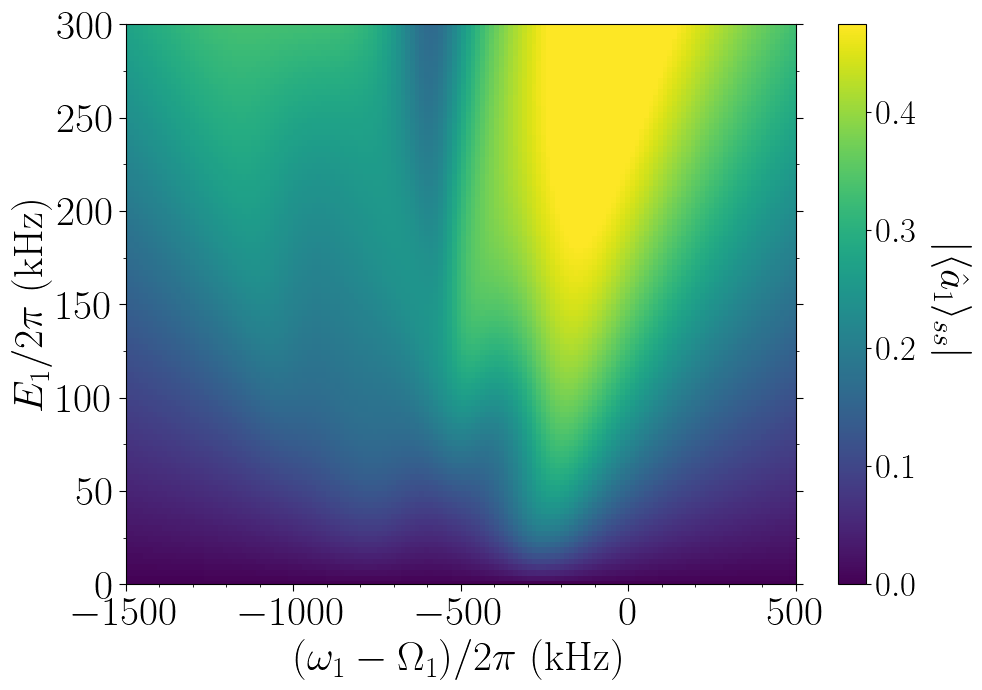

In [5]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e3) for k in Ea_list]
nrm = mpl.colors.Normalize(0, max(A_xy_list[60]))
axes.pcolormesh(x_list, y_list, A_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
#shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in Ea_list]
#yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in Ea_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.xaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
axes.set_xlim(-1500, 500)
axes.set_ylim(0, 300)


axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, A_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_1 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a1ss_Ea.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a1ss_Ea.pdf')
plt.show()


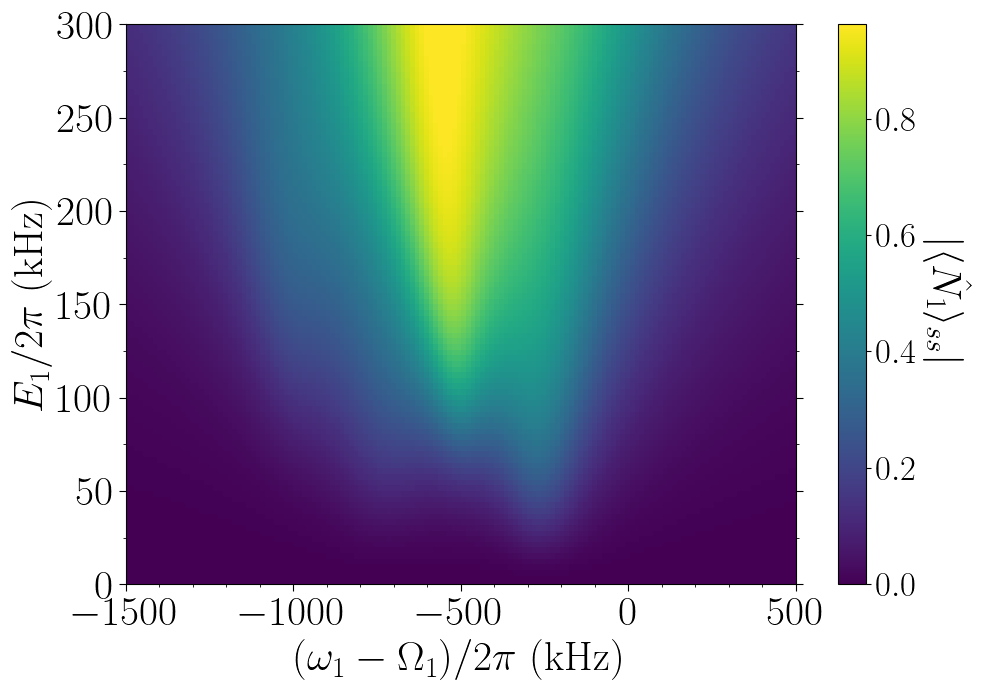

In [9]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e3) for k in Ea_list]
nrm = mpl.colors.Normalize(0, max(Na_xy_list[80]))
axes.pcolormesh(x_list, y_list, Na_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
#shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in Ea_list]
#yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in Ea_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.xaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
axes.set_xlim(-1500, 500)
axes.set_ylim(0, 300)


axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, Na_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat N_1 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_Na1ss_Ea.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_Na1ss_Ea.pdf')
plt.show()


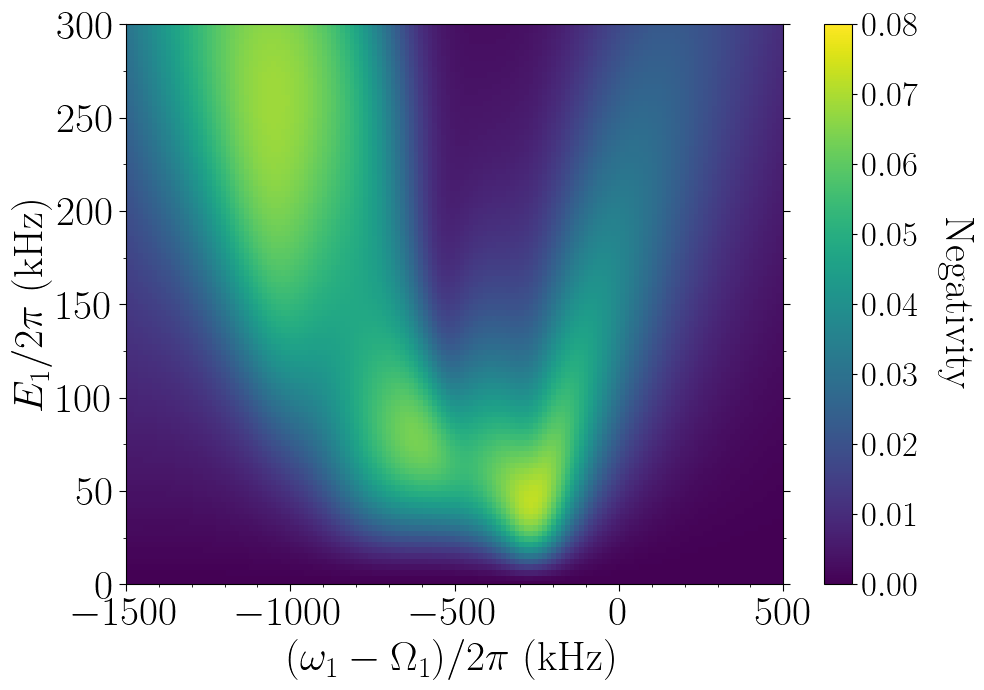

In [10]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e3) for k in Ea_list]
nrm = mpl.colors.Normalize(0, 0.08)
axes.pcolormesh(x_list, y_list, neg_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
#shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in Ea_list]
#yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in Ea_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.xaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
axes.set_xlim(-1500, 500)
axes.set_ylim(0, 300)


axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, neg_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'Negativity', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_Neg_Ea.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_Neg_Ea.pdf')
plt.show()


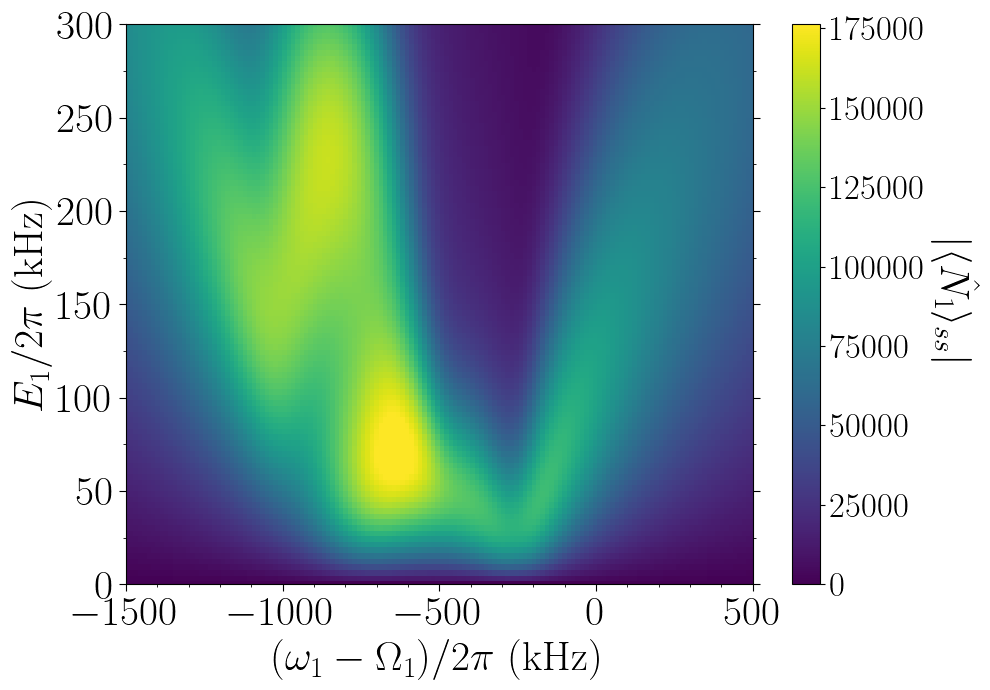

In [11]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e3) for k in Ea_list]
nrm = mpl.colors.Normalize(0, max(S_minus_xy_list[30]))
axes.pcolormesh(x_list, y_list, S_minus_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
#shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in Ea_list]
#yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in Ea_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.xaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
axes.set_xlim(-1500, 500)
axes.set_ylim(0, 300)


axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, S_minus_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat N_1 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_absX1_Ea.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_absX1_Ea.pdf')
plt.show()


NameError: name 'Ea_list' is not defined

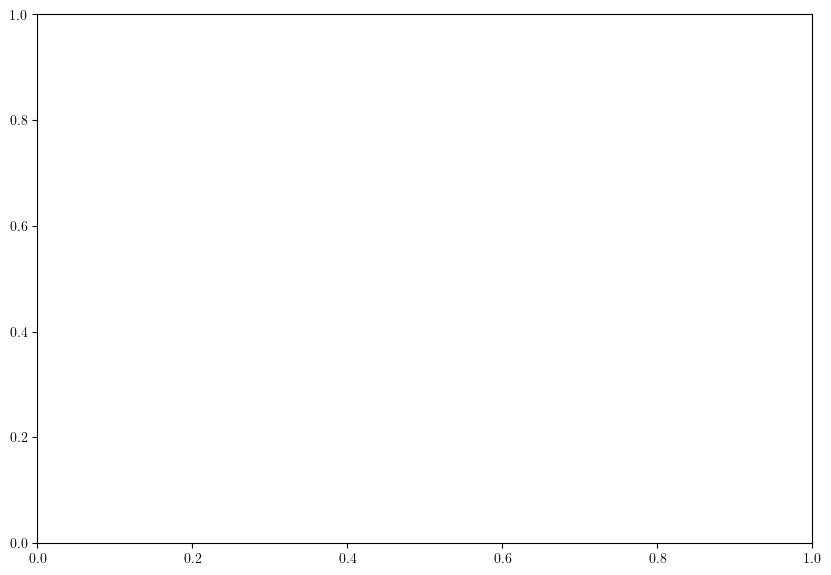

In [4]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in Ea_list]
z_list = [[k / (2*pi*1e3) for k in i] for i in reS_minus_xy_list]

nrm = mpl.colors.Normalize(-30, 30)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
#shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in Ea]
#yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
#axes.plot(shift_curve, y_list, '--', color='black', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
#axes.set_xlim(-1500, 500)
#axes.set_ylim(0, 300)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=Lsize)

plt.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Re$(X_1)/2\pi$ (kHz)',labelpad=40, rotation=270, fontsize=Lsize)
plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_2D_ReX_Ea.png')
plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_2D_ReX_Ea.pdf')
plt.show()


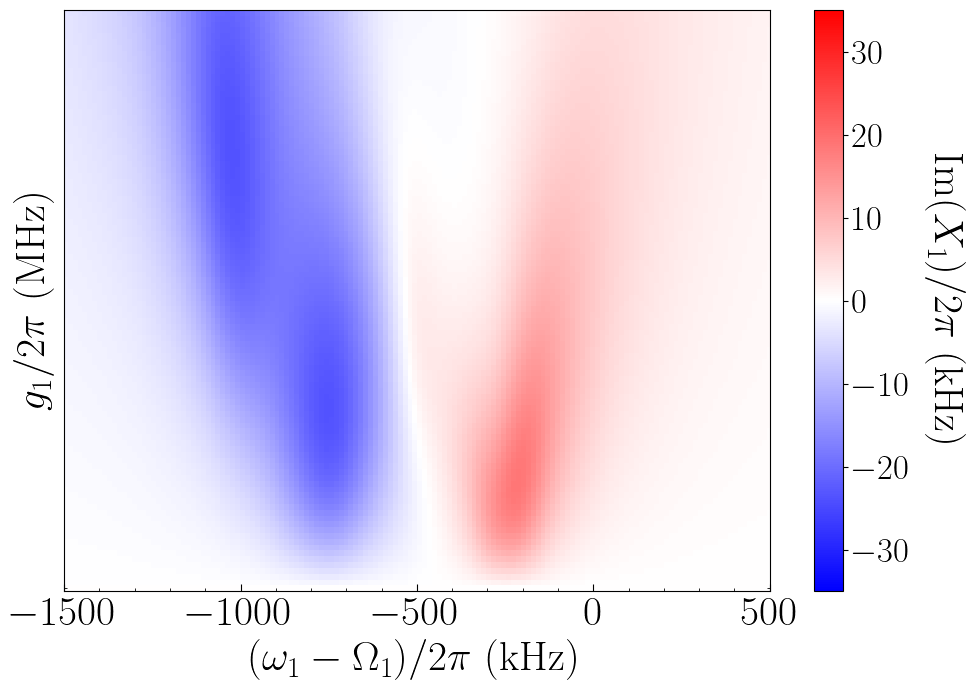

In [104]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in Ea_list]
z_list = [[k / (2*pi*1e3) for k in i] for i in imS_minus_xy_list]

nrm = mpl.colors.Normalize(-35, 35)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
#shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in Ea]
#yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*gb)/(2*pi*wr*1e3)) for k in galist]
#axes.plot(shift_curve, y_list, '--', color='black', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
axes.set_xlim(-1500, 500)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=Lsize)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
axes.yaxis.set_ticks_position('both')

axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Im$(X_1)/2\pi$ (kHz)',labelpad=40, rotation=270, fontsize=Lsize)
plt.tight_layout()

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_2D_ImX_Ea.pdf')
plt.show()


In [106]:
# galist = 2 * pi * linspace(0, 9, 26) * 1e6

g_size = 100
galist = 2 * pi * linspace(0, 12, g_size) * 1e6
gblist = 2 * pi * linspace(0, 12, g_size) * 1e6

Ea_list = 2 * pi * linspace(0, 200, g_size) * 1e3  #from 0 to 5MHz
Eb_list = 2 * pi * linspace(0, 200, g_size) * 1e3  #from 0 to 5MHz

wa = 2 * pi * 5.1 * 1e9  # 5.1 GHz
wb = 2 * pi * 5.7 * 1e9  # 5.7 GHz
wr = 2 * pi * 100 * 1e6  # 100 MHz

ohm_a_initial = wa - 2 * pi * 2.0 * 1e6  # -1500 kHz
ohm_a_final = wa + 2 * pi * 0.5 * 1e6  # 500 kHz

ohm_a_list = linspace(ohm_a_initial, ohm_a_final, 180)

# Dissipation rates
kappa_a = 2 * pi * 100 * 1e3   # 100 kHz
kappa_b = 2 * pi * 100 * 1e3   # 100 kHz
gamma = 100 * kappa_a          # 10 MHz

T = 0                              # Temperature
w_th = (sc.k*T)/(sc.hbar)

# avg number of thermal bath excitation coupled to r
n_th_r = n_thermal(wr, w_th)

# Operators
N = 3
a = tensor(destroy(N), qeye(N), qeye(N))
b = tensor(qeye(N), destroy(N), qeye(N))
r = tensor(qeye(N), qeye(N), destroy(N))
Na = a.dag() * a
Nb = b.dag() * b
Nr = r.dag() * r
Xa = a.dag() + a
Xb = b.dag() + b
Xr = r.dag() + r

A_xy_list = []
A_xy_list_2 = []
B_xy_list = []
Na_xy_list = []
Nb_xy_list = []

pA0_xy_list = []
pA1_xy_list = []
pA2_xy_list = []

pB0_xy_list = []
pB1_xy_list = []
pB2_xy_list = []

S_plus_xy_list = []
S_minus_xy_list = []
reS_plus_xy_list = []
reS_minus_xy_list = []
imS_plus_xy_list = []
imS_minus_xy_list = []
neg_xy_list = []

DeltaE_xy_list = []
T_xy_list = []

for k in range(len(Eb_list)):

    # Field operators
    a_list = []
    b_list = []
    Na_list = []
    Nb_list = []
    a_list_2 = []

    # Entanglement
    S_plus_list = []
    S_minus_list = []
    DeltaE_list = []
    T_list = []
    reS_plus_list = []
    reS_minus_list = []
    imS_plus_list = []
    imS_minus_list = []
    neg_list = []

    # Populations
    pA_0_list = []
    pB_0_list = []
    pA_1_list = []
    pB_1_list = []
    pA_2_list = []
    pB_2_list = []

    for i in range(len(ohm_a_list)):

        ga = 2 * pi * 5 * 1e6          # Fixed at 5 MHz
        gb = 2 * pi * 5 * 1e6          # Fixed at 5 MHz

        chiA = ((ga**2)/wr)
        chiB = ((gb**2)/wr)
        chiAB = ((gb*ga)/wr)

        E_a = 2 * pi * 40 * 1e3
        Ohm_a = ohm_a_list[i]

        E_b = Eb_list[k]
        #Ohm_a = wb - chiB
        Ohm_b = wb - chiB  # 0.9999294416838251 * wb

        Hvec = []
        Hvec.append((wa-Ohm_a) * Na)
        Hvec.append((wb-Ohm_b) * Nb)
        Hvec.append(wr * Nr)
        Hvec.append(-ga * Na * Xr)
        Hvec.append(-gb * Nb * Xr)
        Hvec.append(E_a * Xa)
        Hvec.append(E_b * Xb)
        H = 0
        for i in range(len(Hvec)):
            H = H + Hvec[i]

        c_ops = []
        rate = kappa_a
        if rate > 0.0:
            c_ops.append(sqrt(rate) * a)

        rate = kappa_b
        if rate > 0.0:
            c_ops.append(sqrt(rate) * b)

        rate = gamma * (1 + n_th_r)
        if rate > 0.0:
            c_ops.append(sqrt(rate) * r)

        #rate = gamma * n_th_r
        # if rate > 0.0:
        #    c_ops.append(sqrt(rate) * r.dag())

        rho_ss = steadystate(H, c_ops)
        chi_ss = rho_ss - tensor(ptrace(rho_ss, (0)),
                                 ptrace(rho_ss, (1)), ptrace(rho_ss, (2)))

        #S_plus_matrix  = chi_ss * b.dag() * b * a.dag()
        #S_minus_matrix = chi_ss * b.dag() * b * a

        #S_plus  = (2* ga * gb / wr) * S_plus_matrix.tr()
        #S_minus = (2* ga * gb / wr) * S_minus_matrix.tr()

        S_plus = (2 * ga * gb / wr) * expect(b.dag() * b * a.dag(), chi_ss)
        S_minus = (2 * ga * gb / wr) * expect(b.dag() * b * a, chi_ss)
        Tx = (ga * gb / wr) * expect(Na * Nb, chi_ss)

        T_list.append(Tx)
        S_plus_list.append(abs(S_plus))
        S_minus_list.append(abs(S_minus))

        reS_plus_list.append(real(S_plus))
        reS_minus_list.append(real(S_minus))

        imS_plus_list.append(imag(S_plus))
        imS_minus_list.append(imag(S_minus))

        #a_ss = expect(a, rho_ss)
        a_ss = (rho_ss * a).tr()
        b_ss = expect(b, rho_ss)

        aada = expect(a * a.dag() * a, rho_ss)
        #adada = expect(a.dag() * a.dag() * a, rho_ss)
        #bbdb = expect(b * b.dag() * b, rho_ss)

        pol_arg = (r - r.dag()) * ((ga/wr) * Na + (gb/wr) * Nb)
        pol = pol_arg.expm()
        #pol_arg_half = (pol_arg / 2)
        #pol_half = pol_arg_half.expm()

        na_ss = expect(Na, rho_ss)
        na2_ss = expect(Na**2, rho_ss)
        nb_ss = expect(Nb, rho_ss)

        DeltaE = -(ga**2/wr) * na2_ss - (ga * gb / wr) * na_ss * nb_ss - Tx
        DeltaE_list.append(DeltaE)

        rho_p = pol * rho_ss * pol.dag()

        a_ss_2 = (E_a - ga * (rho_p * a * Xr).tr() - (2 * ga**2 / wr) * aada - S_minus) / \
            ((-ga**2 / wr) + 1j * (kappa_a/2) + 2 * chiAB * nb_ss - wa + Ohm_a)
        a_list_2.append(a_ss_2)

        a_list.append(a_ss)
        b_list.append(b_ss)

        Na_list.append(abs(na_ss))
        Nb_list.append(abs(nb_ss))

        rhoAB = ptrace(rho_ss, (0, 1))
        rhoA = ptrace(rhoAB, (0))
        rhoB = ptrace(rhoAB, (1))

        # Ground state
        p0A = (fidelity(rhoA, fock(N, 0)))**2
        p0B = (fidelity(rhoB, fock(N, 0)))**2
        # First excited state
        p1A = (fidelity(rhoA, fock(N, 1)))**2
        p1B = (fidelity(rhoB, fock(N, 1)))**2
        # Second excited state
        p2A = (fidelity(rhoA, fock(N, 2)))**2
        p2B = (fidelity(rhoB, fock(N, 2)))**2

        pA_0_list.append(p0A)
        pB_0_list.append(p0B)
        pA_1_list.append(p1A)
        pB_1_list.append(p1B)
        pA_2_list.append(p2A)
        pB_2_list.append(p2B)

        neg = negativity(rhoAB, 0, method='eigenvalues')
        neg_list.append(neg)

    #fig, axes = plt.subplots(1,1, figsize=(10,7))

    absA_list = [abs(k) for k in a_list]
    absA_list_2 = [abs(k) for k in a_list_2]
    absB_list = [abs(k) for k in b_list]
    x_list = [(k-wa) / (2*pi*1e3) for k in ohm_a_list]

    #maxA_2 = max(absA_list_2)

    #absA_list_norm_2 = [k / maxA_2  for k in absA_list_2]

    #axes.plot(x_list,absA_list,label=r'$\langle \hat{a} \rangle$', lw=2.0)
    #axes.plot(x_list,absB_list,label=r'$\langle \hat{b} \rangle$', lw=2.0)
    #axes.plot(x_list,Na_list,label=r'$\vert\langle \hat{a}^\dagger\hat{a} \rangle\vert$', lw=2.0)
    #axes.plot(x_list,Nb_list,label=r'$\langle \hat{b}^\dagger\hat{b} \rangle\vert$', lw=2.0)

    #xposition = [-chiA/ (2*pi*1e3),-chiA/ (2*pi*1e3)-chiAB/ (2*pi*1e3)]
    #plt.axvline(x=xposition[0], color='blue', linestyle='--')
    #plt.axvline(x=xposition[1], color='red', linestyle='--')

    #axes.set_xlabel(r'$\omega_a - \omega_a^d$ (kHz)',rotation=0,fontsize= 20.0)
    #axes.set_ylabel(r'$\langle \hat{a}\rangle$',rotation=90,fontsize= 22.0)
    #axes.tick_params(axis='both', which='major', labelsize=16)
    #axes.tick_params(axis='both', which='minor', labelsize=16)
    # axes.legend(loc=1,fontsize=16)

    A_xy_list.append(absA_list)
    A_xy_list_2.append(absA_list_2)
    B_xy_list.append(absB_list)
    Na_xy_list.append(Na_list)
    Nb_xy_list.append(Nb_list)

    pA0_xy_list.append(pA_0_list)
    pA1_xy_list.append(pA_1_list)
    pA2_xy_list.append(pA_2_list)

    pB0_xy_list.append(pB_0_list)
    pB1_xy_list.append(pB_1_list)
    pB2_xy_list.append(pB_2_list)

    S_plus_xy_list.append(S_plus_list)
    S_minus_xy_list.append(S_minus_list)
    reS_plus_xy_list.append(reS_plus_list)
    reS_minus_xy_list.append(reS_minus_list)
    imS_plus_xy_list.append(imS_plus_list)
    imS_minus_xy_list.append(imS_minus_list)
    neg_xy_list.append(neg_list)

    DeltaE_xy_list.append(DeltaE_list)
    T_xy_list.append(T_list)

    print('%d/99' % k)


0/99
1/99
2/99
3/99
4/99
5/99
6/99
7/99
8/99
9/99
10/99
11/99
12/99
13/99
14/99
15/99
16/99
17/99
18/99
19/99
20/99
21/99
22/99
23/99
24/99
25/99
26/99
27/99
28/99
29/99
30/99
31/99
32/99
33/99
34/99
35/99
36/99
37/99
38/99
39/99
40/99
41/99
42/99
43/99
44/99
45/99
46/99
47/99
48/99
49/99
50/99
51/99
52/99
53/99
54/99
55/99
56/99
57/99
58/99
59/99
60/99
61/99
62/99
63/99
64/99
65/99
66/99
67/99
68/99
69/99
70/99
71/99
72/99
73/99
74/99
75/99
76/99
77/99
78/99
79/99
80/99
81/99
82/99
83/99
84/99
85/99
86/99
87/99
88/99
89/99
90/99
91/99
92/99
93/99
94/99
95/99
96/99
97/99
98/99
99/99


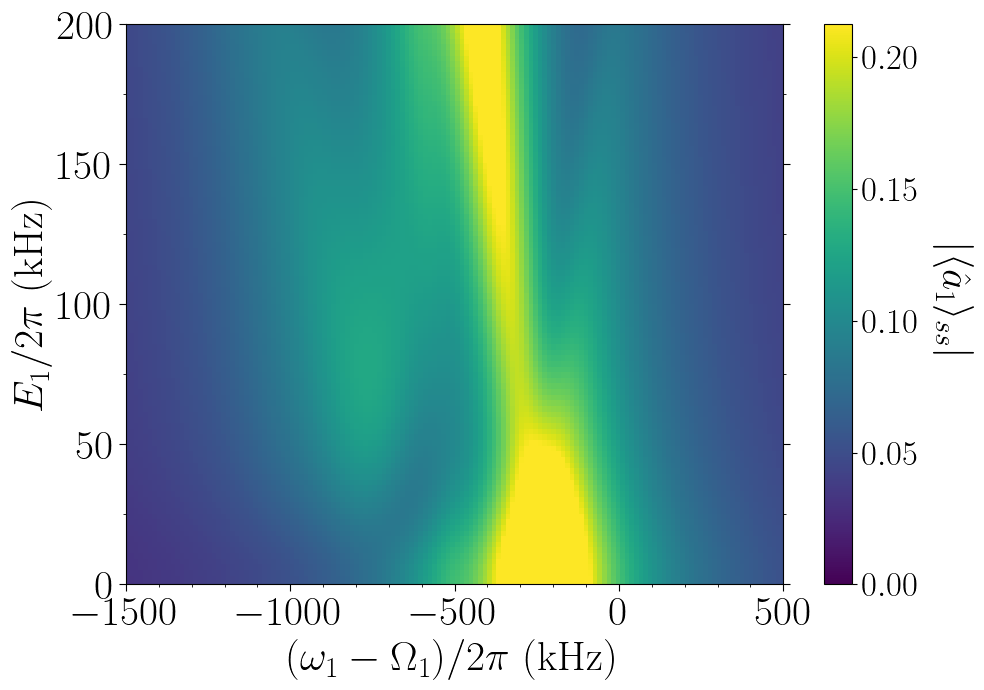

In [111]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e3) for k in Eb_list]
nrm = mpl.colors.Normalize(0, max(A_xy_list[25]))
axes.pcolormesh(x_list, y_list, A_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
#shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in Ea_list]
#yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in Ea_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.xaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
axes.set_xlim(-1500, 500)
axes.set_ylim(0, 200)


axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, A_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_1 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_a1ss_Eb.pdf')
plt.show()


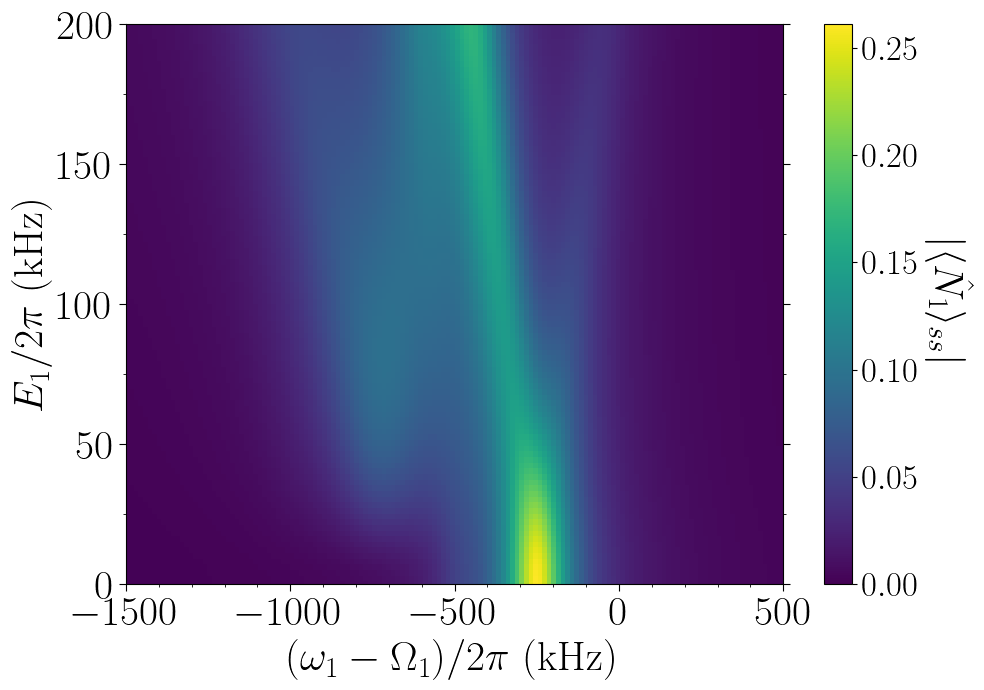

In [113]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e3) for k in Eb_list]
nrm = mpl.colors.Normalize(0, max(Na_xy_list[0]))
axes.pcolormesh(x_list, y_list, Na_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
#shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in Ea_list]
#yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in Ea_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.xaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
axes.set_xlim(-1500, 500)
axes.set_ylim(0, 200)


axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, Na_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat N_1 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_Na1ss_Eb.pdf')
plt.show()


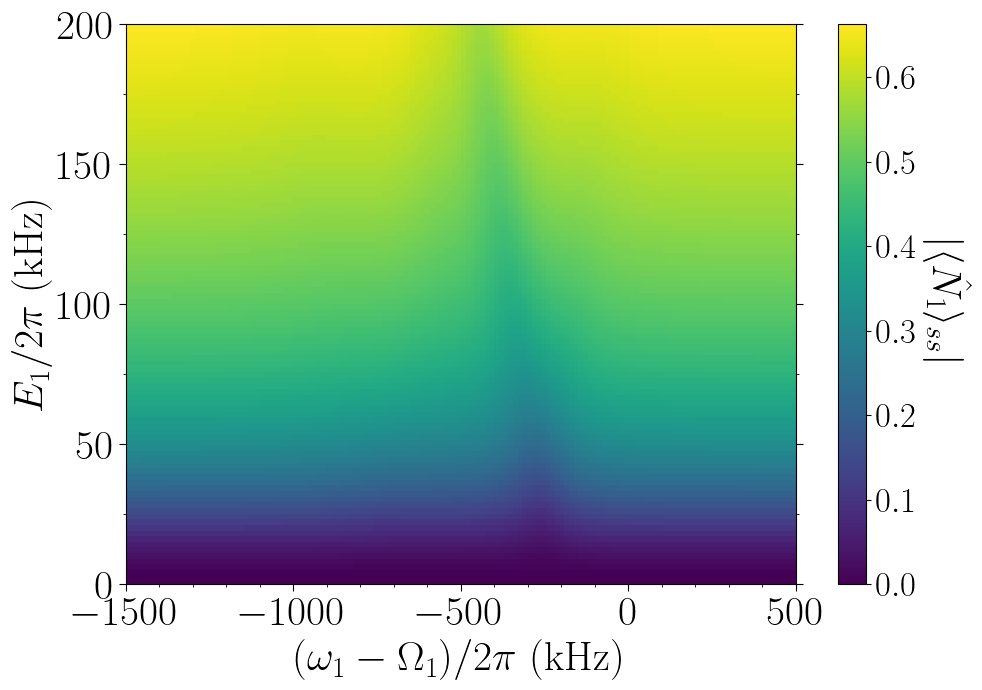

In [116]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e3) for k in Eb_list]
nrm = mpl.colors.Normalize(0, max(Nb_xy_list[99]))
axes.pcolormesh(x_list, y_list, Nb_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
#shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in Ea_list]
#yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in Ea_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.xaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
axes.set_xlim(-1500, 500)
axes.set_ylim(0, 200)


axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, Nb_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat N_1 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_Na1ss_Eb.pdf')
plt.show()


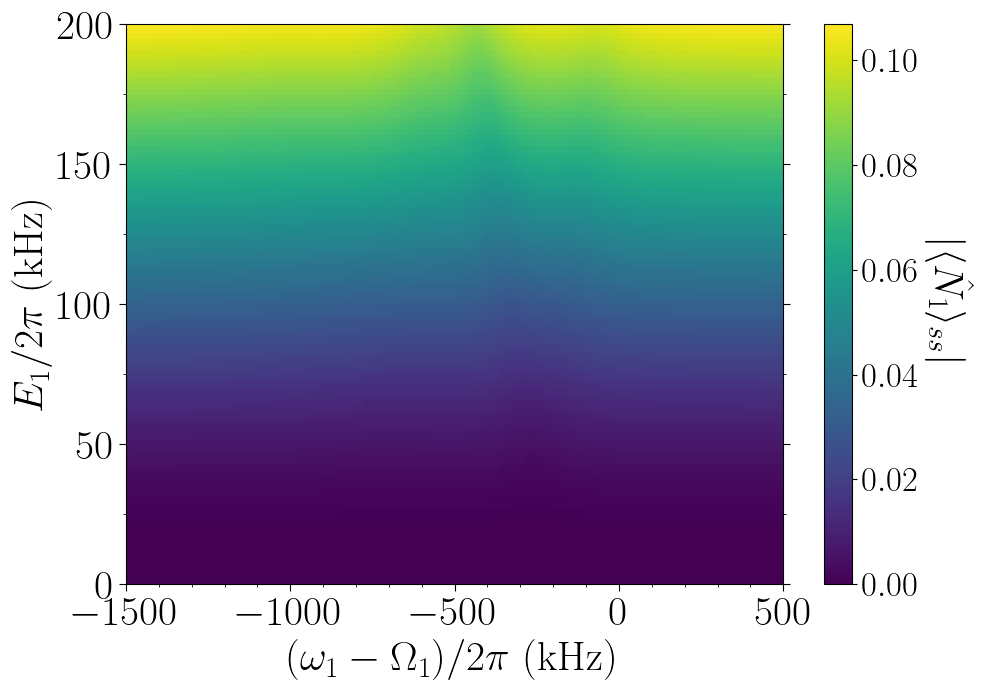

In [118]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e3) for k in Eb_list]
nrm = mpl.colors.Normalize(0, max(pB2_xy_list[99]))
axes.pcolormesh(x_list, y_list, pB2_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
#shift_curve = [-(ga**2)/(2*pi*wr*1e3) for k in Ea_list]
#yyy2 = [(-(ga**2)/(2*pi*wr*1e3))-((2*ga*gb)/(2*pi*wr*1e3)) for k in Ea_list]
#axes.plot(shift_curve, y_list, '--', color='white', lw=2.0)
#axes.plot(yyy2, y_list, '--', color='white', lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$E_1/2\pi$ (kHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.xaxis.set_ticks(arange(-1500, 501, 500))
axes.yaxis.set_ticks_position('both')
#axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
#axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
axes.set_xlim(-1500, 500)
axes.set_ylim(0, 200)


axes.yaxis.set_minor_locator(AutoMinorLocator(2))
axes.xaxis.set_minor_locator(AutoMinorLocator(5))

axes.xaxis.set_tick_params(length=5)
axes.yaxis.set_tick_params(length=5)

plt.pcolormesh(x_list, y_list, pB2_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat N_1 \rangle_{ss}\vert$', labelpad = 40, rotation=270, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig(r'Images_from_Article_simulation_daleks\twomodes_cavity1field_2D_Na1ss_Eb.pdf')
plt.show()


## Simulation 3: Multiple modes (N > 2)


In [116]:
name = "Metamaterial_modes_simulation"
author = "Alessandro Santana"

time_index = datetime.datetime.now().strftime("[%Y-%m-%d][%Hh%Mm]")
date_index = datetime.datetime.now().strftime("[%Y-%m-%d]")

save_path = "Data/" + date_index + "/" + time_index + "/"
try:
    #os.mkdir("Data")
    os.mkdir("Data/" + date_index)
except OSError:
    print ("Creation of the directory %s failed. Directory may already exist." % date_index)  
try:
    os.mkdir(save_path)
    os.mkdir(save_path+"/npy/")
    os.mkdir(save_path+"/pdf/")
except OSError:
    print ("Creation of the directory %s failed. Directory may already exist." % save_path)

# Create log file
filename = name  + ".log"
file = open(save_path + filename,"w")
file.write("Simulation: " + name + "\n")
file.write("Author: " + author + "\n\n")

# Save simulation parameters in log file
def log_parameters():
    file.write("        ## Simulation parameters ##\n")
    file.write("        # Frequecies:\n")
    file.write("        w1 = %.2f GHz\n" % float(w1/(2*pi*1e9)))
    file.write("        w2 = %.2f GHz\n" % float(w2/(2*pi*1e9)))
    if N_cavities > 2:
        file.write("        w3 = %.2f GHz\n" % float(w3/(2*pi*1e9)))
    file.write("        wr = %.2f GHz\n" % float(wr/(2*pi*1e9)))
    file.write("        g1 = %.2f MHz\n" % float(g1/(2*pi*1e6)))
    file.write("        g2 = %.2f MHz\n" % float(g2/(2*pi*1e6)))
    if N_cavities > 2:
        file.write("        g3 = %.2f MHz\n\n" % float(g3/(2*pi*1e6)))
    file.write("        # Displacements:\n")
    file.write("        chi1 = %.1f kHz\n" % float(chi1/(2*pi*1e3)))
    file.write("        chi2 = %.1f kHz\n" % float(chi2/(2*pi*1e3)))
    if N_cavities > 2:
        file.write("        chi3 = %.1f kHz\n" % float(chi3/(2*pi*1e3)))
    file.write("        chi12 = %.1f kHz\n" % float(chi12/(2*pi*1e3)))
    if N_cavities > 2:
        file.write("        chi23 = %.1f kHz\n" % float(chi23/(2*pi*1e3)))
        file.write("        chi13 = %.1f kHz\n\n" % float(chi13/(2*pi*1e3)))
    file.write("        # External fields:\n")
    if E_1 > 0:
        file.write("        Cavity 1 drive:\n")
        file.write("            E_1 = %.1f kHz\n" % float(E_1/(2*pi*1e3)))
        file.write("            Sigma_1 = %.1f GHz\n" % float(Ohm_1/(2*pi*1e9)))
        file.write("            Detuning1 = %.1f kHz\n" %
              float((w1 - Ohm_1)/(2*pi*1e3)))

    if E_2 > 0:
        file.write("        Cavity 2 drive:\n")
        file.write("            E_2 = %.1f kHz\n" % float(E_2/(2*pi*1e3)))
        file.write("            Sigma_2 = %.1f GHz\n" % float(Ohm_2/(2*pi*1e9)))
        file.write("            Detuning2 = %.1f kHz\n" %
              float((w2 - Ohm_2)/(2*pi*1e3)))
    if N_cavities > 2:
        if E_3 > 0:
            file.write("        Cavity 3 drive:\n")
            file.write("            E_3 = %.1f kHz\n" % float(E_3/(2*pi*1e3)))
            file.write("            Sigma_3 = %.1f GHz\n" % float(Ohm_3/(2*pi*1e9)))
            file.write("            Detuning3 = %.1f kHz\n\n" %
                float((w3 - Ohm_3)/(2*pi*1e3)))
    else:
        if E_1 == 0:
            file.write("        NONE\n")
        if E_2 == 0:
            file.write("        NONE\n")
        if N_cavities > 2:
            if E_3 == 0:
                file.write("        NONE\n")

    file.write("        # Dissipation parameters:\n")
    file.write("        kappa_1 = %.1f kHz\n" % float(kappa_1/(2*pi*1e3)))
    file.write("        kappa_2 = %.1f kHz\n" % float(kappa_2/(2*pi*1e3)))
    file.write("        kappa_3 = %.1f kHz\n" % float(kappa_3/(2*pi*1e3)))
    file.write("        gamma = %.1f kHz\n" % float(gamma/(2*pi*1e3)))

    return 

Creation of the directory [2022-07-06] failed. Directory may already exist.


In [117]:
import time
from datetime import timedelta

file.write("##### Simulation START #####\n\n")

# Number of cavities: N_cavities = 2,3 or 4
N_cavities = 3

# Fock space dimension (No temperature simulation)
N = 2

file.write("# Fock dimension:\n")
file.write("N = %d\n\n" % N)

# Coupling strength g_k
g0, gf, g_size = 0, 12, 100
g1list = 2 * pi * linspace(g0, gf, g_size) * 1e6
g2list = 2 * pi * linspace(g0, gf, g_size) * 1e6

if N_cavities > 2:
    g3list = 2 * pi * linspace(0, 12, g_size) * 1e6

    if N_cavities > 3:
        g4list = 2 * pi * linspace(0, 12, g_size) * 1e6

file.write("# g_list parameters:\n")
file.write("g1_initial =  %.2f MHz, g1_final = %.2f MHz, g1list_length = %d\n" % (g1list[0]/(2*pi*1e6), g1list[-1]/(2*pi*1e6), len(g1list)))
file.write("g2_initial =  %.2f MHz, g2_final = %.2f MHz, g2list_length = %d\n" % (g2list[0]/(2*pi*1e6), g2list[-1]/(2*pi*1e6), len(g2list)))
if N_cavities > 2:
    file.write("g3_initial =  %.2f MHz, g3_final = %.2f MHz, g3list_length = %d\n" % (g3list[0]/(2*pi*1e6), g3list[-1]/(2*pi*1e6), len(g3list)))
    if N_cavities > 3:
        file.write("g4_initial =  %.2f MHz, g4_final = %.2f MHz, g4list_length = %d\n" % (g4list[0]/(2*pi*1e6), g4list[-1]/(2*pi*1e6), len(g4list)))


# Mode frequencies
w1 = 2 * pi * 5.1 * 1e9  # 5.1 GHz
w2 = 2 * pi * 5.3 * 1e9  # 5.3 GHz

if N_cavities > 2:
    w3 = 2 * pi * 5.5 * 1e9  # 5.5 GHz

    if N_cavities > 3:
        w4 = 2 * pi * 5.7 * 1e9   # 5.7 GHz

wr = 2 * pi * 100 * 1e6  # 100 MHz

# Driving field and detuning
detuning_min =  2 * pi * 2.0 * 1e6  # -2000 kHz
detuning_max =  2 * pi * 0.5 * 1e6  #   500 kHz

ohm_1_initial = w1 - detuning_min  
ohm_1_final   = w1 + detuning_max    

ohm_2_initial = w2 - detuning_min   
ohm_2_final   = w2 + detuning_max  

o_size = 180
ohm_1_list = linspace(ohm_1_initial, ohm_1_final, o_size)
ohm_2_list = linspace(ohm_2_initial, ohm_2_final, o_size)

if N_cavities > 2:
    ohm_3_initial = w3 - detuning_min
    ohm_3_final   = w3 + detuning_max 

    ohm_3_list = linspace(ohm_3_initial, ohm_3_final, o_size)

    if N_cavities > 3:
        ohm_4_initial = w4 - detuning_min 
        ohm_4_final   = w4 + detuning_max 

        ohm_4_list = linspace(ohm_4_initial, ohm_4_final, o_size)

file.write("\n# Ohm_list paramters:\n")
file.write("ohm_1_initial = %.2f GHz, ohm_1_final = %.2f GHz, ohm_1_list_length = %d\n" % (ohm_1_list[0]/(2*pi*1e9), ohm_1_list[-1]/(2*pi*1e9), len(ohm_1_list)))
file.write("ohm_2_initial = %.2f GHz, ohm_2_final = %.2f GHz, ohm_2_list_length = %d\n" % (ohm_2_list[0]/(2*pi*1e9), ohm_2_list[-1]/(2*pi*1e9), len(ohm_2_list)))
if N_cavities > 2:
    file.write("ohm_3_initial = %.2f GHz, ohm_3_final = %.2f GHz, ohm_3_list_length = %d\n" % (ohm_3_list[0]/(2*pi*1e9), ohm_3_list[-1]/(2*pi*1e9), len(ohm_3_list)))
    if N_cavities > 3:
        file.write("ohm_4_initial = %.2f GHz, ohm_4_final = %.2f GHz, ohm_4_list_length = %d\n" % (ohm_4_list[0]/(2*pi*1e9), ohm_4_list[-1]/(2*pi*1e9), len(ohm_4_list)))

# Dissipation rates
drate = 50  # 100 kHz
kappa_1 = 2 * pi * drate * 1e3           
kappa_2 = 2 * pi * drate * 1e3   

if N_cavities > 2:
    kappa_3 = 2 * pi * drate * 1e3   

    if N_cavities > 3:
        kappa_4 = 2 * pi * drate * 1e3
    else:
        kappa_4 = 0
else:
    kappa_3 = 0
    kappa_4 = 0

gamma = 100 * kappa_1                  # 10 MHz

# Bosonic operators
if N_cavities == 2:
    a1 = tensor(destroy(N), qeye(N), qeye(N))
    a2 = tensor(qeye(N), destroy(N), qeye(N))
    r  = tensor(qeye(N), qeye(N), destroy(N))
elif N_cavities == 3:
    a1 = tensor(destroy(N), qeye(N), qeye(N), qeye(N))
    a2 = tensor(qeye(N), destroy(N), qeye(N), qeye(N))
    a3 = tensor(qeye(N), qeye(N), destroy(N), qeye(N))
    r  = tensor(qeye(N), qeye(N), qeye(N), destroy(N))
elif N_cavities == 4:
    a1 = tensor(destroy(N), qeye(N), qeye(N), qeye(N), qeye(N))
    a2 = tensor(qeye(N), destroy(N), qeye(N), qeye(N), qeye(N))
    a3 = tensor(qeye(N), qeye(N), destroy(N), qeye(N), qeye(N))
    a4 = tensor(qeye(N), qeye(N), qeye(N), destroy(N), qeye(N))
    r  = tensor(qeye(N), qeye(N), qeye(N), qeye(N), destroy(N))

# Number operators
N1 = a1.dag() * a1
N2 = a2.dag() * a2
if N_cavities > 2:
    N3 = a3.dag() * a3
    if N_cavities > 3:
        N4 = a4.dag() * a4

Nr = r.dag() * r

# Quadrature operators
X1 = a1.dag() + a1
X2 = a2.dag() + a2
if N_cavities > 2:
    X3 = a3.dag() + a3
    if N_cavities > 3:
        X4 = a4.dag() + a4

Xr = r.dag() + r

# Creating a set of empty lists
A1_xy_list = []
A2_xy_list = []
N1_xy_list = []
N2_xy_list = []
p10_xy_list = []
p11_xy_list = []
p20_xy_list = []
p21_xy_list = []
X1_xy_list = []
Y1_xy_list = []
X2_xy_list = []
Y2_xy_list = []
Neg12_xy_list = []
sigma1_xy_list = []
sigma2_xy_list = []
DeltaE1_xy_list = []
DeltaE2_xy_list = []

if N > 2:
    p12_xy_list = []
    p22_xy_list = []
    if N > 3:
        p13_xy_list = []
        p23_xy_list = []

if N_cavities > 2:

    A3_xy_list = []
    N3_xy_list = []
    p30_xy_list = []
    p31_xy_list = []
    X3_xy_list = []
    Y3_xy_list = []
    Neg23_xy_list = []
    Neg13_xy_list = []
    sigma3_xy_list = []
    DeltaE3_xy_list = []

    if N > 2:
        p32_xy_list = []
        if N > 3:
            p33_xy_list = []

    if N_cavities > 3:
        A4_xy_list = []
        N4_xy_list = []
        p40_xy_list = []
        p41_xy_list = []
        X4_xy_list = []
        Y4_xy_list = []
        Neg24_xy_list = []
        Neg14_xy_list = []
        Neg34_xy_list = []
        sigma4_xy_list = []
        DeltaE4_xy_list = []

        if N > 2:
            p42_xy_list = []
            if N > 3:
                p43_xy_list = []

for k in range(len(g1list)):

    file.write('\n### k = %d/%d START ###\n' % (k, int(len(g1list)-1)))
    start_time_k = time.monotonic()

    # Creating another set of empty lists
    a1_list = []
    a2_list = []
    N1_list = []
    N2_list = []
    p1_0_list = []
    p1_1_list = []
    p2_0_list = []
    p2_1_list = []
    X1_list = []
    Y1_list = []
    X2_list = []
    Y2_list = []
    Neg12_list = []
    sigma1_list = []
    sigma2_list = []
    DeltaE1_list = []
    DeltaE2_list = []

    if N > 2:
        p1_2_list = []
        p2_2_list = []
        if N > 3:
            p1_3_list = []
            p2_3_list = []

    if N_cavities > 2:
        a3_list = []
        N3_list = []
        p3_0_list = []
        p3_1_list = []
        X3_list = []
        Y3_list = []
        Neg23_list = []
        Neg13_list = []
        sigma3_list = []
        DeltaE3_list = []

        if N > 2:
            p3_2_list = []
            if N > 3:
                p3_3_list = []

        if N_cavities > 3:
            a4_list = []
            N4_list = []
            p4_0_list = []
            p4_1_list = []
            X4_list = []
            Y4_list = []
            Neg24_list = []
            Neg14_list = []
            Neg34_list = []
            sigma4_list = []
            DeltaE4_list = []

            if N > 2:
                p4_2_list = []
                if N > 3:
                    p4_3_list = []

    for i in range(len(ohm_1_list)):

        file.write('    ### i = %d/%d START ###\n\n' % (i, int(len(ohm_1_list)-1)))
        start_time_i = time.monotonic()

        g1 = g1list[k]
        g2 = 2 * pi * 5 * 1e6             # Fixed at 5 MHz

        chi1  = ((g1**2)/wr)
        chi2  = ((g2**2)/wr)
        chi12 = ((g1*g2)/wr)

        Edrive = 40                       # Driving field strength 50 kHz
        E_1 = 2 * pi * Edrive * 1e3
        Ohm_1 = ohm_1_list[i]

        E_2 = 2 * pi * Edrive * 1e3
        Ohm_2 = w2 - chi2

        if N_cavities > 2:
            g3 = 2 * pi * 8 * 1e6          # Fixed at 8 MHz

            chi3  = ((g3**2)/wr)
            chi13 = ((g1*g3)/wr)
            chi23 = ((g2*g3)/wr)

            E_3 = 2 * pi * Edrive * 1e3
            Ohm_3 = w3 - chi3

            if N_cavities > 3:
                g4 = 2 * pi * 12 * 1e6     # Fixed at 12 MHz

                chi4  = ((g4**2)/wr)
                chi14 = ((g1*g4)/wr)
                chi24 = ((g2*g4)/wr)
                chi34 = ((g3*g4)/wr)

                E_4 = 2 * pi * Edrive * 1e3
                Ohm_4 = w4 - chi4

        log_parameters()  # file.write all parameters

        # Hamiltonians:
        H_1 = ((w1-Ohm_1) * N1) + (g1 * N1 * Xr) + (E_1 * X1)
        H_2 = ((w2-Ohm_2) * N2) + (g2 * N2 * Xr) + (E_2 * X2)
        if N_cavities > 2:
            H_3 = ((w3-Ohm_3) * N3) + (g3 * N3 * Xr) + (E_3 * X3)
            if N_cavities > 3:
                H_4 = ((w4-Ohm_4) * N4) + (g4 * N4 * Xr) + (E_4 * X4)
            else:
                H_4 = 0
        else:
             H_3 = 0
             H_4 = 0
        
        # Total Hamiltonian:
        H = (wr * Nr) + H_1 + H_2 + H_3 + H_4

        # Lindblad collapse operators
        c_ops = []
        rate = kappa_1
        if rate > 0.0:
            c_ops.append(sqrt(rate) * a1)

        rate = kappa_2
        if rate > 0.0:
            c_ops.append(sqrt(rate) * a2)

        rate = kappa_3
        if rate > 0.0:
            c_ops.append(sqrt(rate) * a3)

        rate = kappa_4
        if rate > 0.0:
            c_ops.append(sqrt(rate) * a4)

        rate = gamma 
        if rate > 0.0:
            c_ops.append(sqrt(rate) * r)

        # Steady-state solution
        rho_ss = steadystate(H, c_ops)

        if N_cavities == 2:
            chi_ss = rho_ss - tensor(ptrace(rho_ss, (0)), ptrace(rho_ss, (1)), ptrace(rho_ss, (2)))
        elif N_cavities == 3:
            chi_ss = rho_ss - tensor(ptrace(rho_ss, (0)), ptrace(rho_ss, (1)), ptrace(rho_ss, (2)), ptrace(rho_ss, (3)))
        elif N_cavities == 4:
            chi_ss = rho_ss - tensor(ptrace(rho_ss, (0)), ptrace(rho_ss, (1)), ptrace(rho_ss, (2)), ptrace(rho_ss, (3)),  ptrace(rho_ss, (4)))

        ## Results ##

        X_1 = (2 * g1 * g2 / wr) * expect(N2 * a1, chi_ss)
        X_2 = (2 * g2 * g1 / wr) * expect(N1 * a2, chi_ss)
        
        if N_cavities > 2:
            X_1 = X_1 + (2 * g1 * g3 / wr) * expect(N3 * a1, chi_ss)
            X_2 = X_2 + (2 * g2 * g3 / wr) * expect(N3 * a2, chi_ss)

            X_3 = (2 * g3 * g1 / wr) * expect(N1 * a3, chi_ss) + \
                    (2 * g3 * g2 / wr) * expect(N2 * a3, chi_ss)

            if N_cavities > 3:
                X_1 = X_1 + (2 * g1 * g4 / wr) * expect(N4 * a1, chi_ss)
                X_2 = X_2 + (2 * g2 * g4 / wr) * expect(N4 * a2, chi_ss)
                X_3 = X_3 + (2 * g3 * g4 / wr) * expect(N3 * a2, chi_ss)

                X_4 = (2 * g4 * g1 / wr) * expect(N1 * a4, chi_ss) + \
                      (2 * g4 * g2 / wr) * expect(N2 * a4, chi_ss) + \
                      (2 * g4 * g3 / wr) * expect(N3 * a4, chi_ss)

        Y_1 = (2 * g1 * g2 / wr) * expect(N2 * a1.dag(), chi_ss)
        Y_2 = (2 * g2 * g1 / wr) * expect(N1 * a2.dag(), chi_ss)
        
        if N_cavities > 2:
            Y_1 = Y_1 + (2 * g1 * g3 / wr) * expect(N3 * a1.dag(), chi_ss)
            Y_2 = Y_2 + (2 * g2 * g3 / wr) * expect(N3 * a2.dag(), chi_ss)

            Y_3 = (2 * g3 * g1 / wr) * expect(N1 * a3.dag(), chi_ss) + \
                  (2 * g3 * g2 / wr) * expect(N2 * a3.dag(), chi_ss)

            if N_cavities > 3:
                Y_1 = Y_1 + (2 * g1 * g4 / wr) * expect(N4 * a1.dag(), chi_ss)
                Y_2 = Y_2 + (2 * g2 * g4 / wr) * expect(N4 * a2.dag(), chi_ss)
                Y_3 = Y_3 + (2 * g3 * g4 / wr) * expect(N3 * a3.dag(), chi_ss)

                Y_4 = (2 * g4 * g1 / wr) * expect(N1 * a4.dag(), chi_ss) + \
                      (2 * g4 * g2 / wr) * expect(N2 * a4.dag(), chi_ss) + \
                      (2 * g4 * g3 / wr) * expect(N3 * a4.dag(), chi_ss)

        sigma1 = (g1 * g2 / wr) * expect(N1 * N2, chi_ss)
        sigma2 = (g2 * g1 / wr) * expect(N2 * N1, chi_ss)
            
        if N_cavities > 2:
            sigma1 = sigma1 + (g1 * g3 / wr) * expect(N1 * N3, chi_ss)
            sigma2 = sigma2 + (g2 * g3 / wr) * expect(N2 * N3, chi_ss)

            sigma3 = (g3 * g1 / wr) * expect(N3 * N1, chi_ss) + \
                     (g3 * g2 / wr) * expect(N3 * N2, chi_ss)

            if N_cavities > 3:
                sigma1 = sigma1 + (g1 * g4 / wr) * expect(N1 * N4, chi_ss)
                sigma2 = sigma2 + (g2 * g4 / wr) * expect(N2 * N4, chi_ss)
                sigma3 = sigma3 + (g3 * g4 / wr) * expect(N3 * N4, chi_ss)

                sigma4 = (g4 * g1 / wr) * expect(N4 * N1, chi_ss) + \
                         (g4 * g2 / wr) * expect(N4 * N2, chi_ss) + \
                         (g4 * g3 / wr) * expect(N4 * N3, chi_ss)

        sigma1_list.append(sigma1)
        sigma2_list.append(sigma2)

        X1_list.append(X_1)
        X2_list.append(X_2)

        Y1_list.append(Y_1)
        Y2_list.append(Y_2)

        a1_ss = (rho_ss * a1).tr()
        a2_ss = (rho_ss * a2).tr()

        N1_ss = expect(N1, rho_ss)
        N2_ss = expect(N2, rho_ss)

        N1sq_ss = expect(N1**2, rho_ss)
        N2sq_ss = expect(N2**2, rho_ss)

        DeltaE1 = (g1**2/wr) * N1sq_ss + (g1 * g2 / wr) * N1_ss * N2_ss + sigma1
        DeltaE2 = (g2**2/wr) * N2sq_ss + (g2 * g1 / wr) * N2_ss * N1_ss + sigma2

        a1_list.append(abs(a1_ss))
        a2_list.append(abs(a2_ss))

        N1_list.append(abs(N1_ss))
        N2_list.append(abs(N2_ss))

        rho12 = ptrace(rho_ss, (0, 1))

        rho1 = ptrace(rho_ss, (0))
        rho2 = ptrace(rho_ss, (1))

        Neg12 = negativity(rho12, 0, method='eigenvalues')

        Neg12_list.append(Neg12)

        # Ground state
        p01 = (fidelity(rho1, fock(N, 0)))**2
        p02 = (fidelity(rho2, fock(N, 0)))**2
        # First excited state
        p11 = (fidelity(rho1, fock(N, 1)))**2
        p12 = (fidelity(rho2, fock(N, 1)))**2

        p1_0_list.append(p01)
        p2_0_list.append(p02)

        p1_1_list.append(p11)
        p2_1_list.append(p12)

        if N > 2:
            # Second excited state
            p21 = (fidelity(rho1, fock(N, 2)))**2
            p22 = (fidelity(rho2, fock(N, 2)))**2

            p1_2_list.append(p21)
            p2_2_list.append(p22)

            if N > 3:
                # Third excited state
                p31 = (fidelity(rho1, fock(N, 3)))**2
                p32 = (fidelity(rho2, fock(N, 3)))**2

                p1_3_list.append(p31)
                p2_3_list.append(p32)

        if N_cavities > 2:
            X3_list.append(X_3)
            Y3_list.append(Y_3)
            sigma3_list.append(sigma3)
            a3_ss = (rho_ss * a3).tr()
            N3_ss = expect(N3, rho_ss)
            N3sq_ss = expect(N3**2, rho_ss)
        
            DeltaE1 = DeltaE1 + (g1 * g3 / wr) * N1_ss * N3_ss
            DeltaE2 = DeltaE2 + (g2 * g3 / wr) * N2_ss * N3_ss

            DeltaE3 = (g3**2/wr) * N3sq_ss + (g3 * g1 / wr) * N3_ss * N1_ss + \
                                             (g3 * g2 / wr) * N3_ss * N2_ss + sigma3

            a3_list.append(abs(a3_ss))
            N3_list.append(abs(N3_ss))

            rho3  = ptrace(rho_ss, (2))
            rho23 = ptrace(rho_ss, (1, 2))
            rho13 = ptrace(rho_ss, (0, 2))

            Neg23 = negativity(rho23, 0, method='eigenvalues')
            Neg13 = negativity(rho13, 0, method='eigenvalues')

            Neg13_list.append(Neg13)
            Neg23_list.append(Neg23)


            # Ground state
            p03 = (fidelity(rho3, fock(N, 0)))**2
            # First excited state
            p13 = (fidelity(rho3, fock(N, 1)))**2

            p3_0_list.append(p03)
            p3_1_list.append(p13)

            if N > 2:
                # Second excited state
                p23 = (fidelity(rho3, fock(N, 2)))**2

                p3_2_list.append(p23)

                if N > 3:
                    # Third excited state
                    p33 = (fidelity(rho3, fock(N, 3)))**2

                    p3_3_list.append(p33)

            if N_cavities > 3:
                
                X4_list.append(X_4)
                Y4_list.append(Y_4)
                sigma4_list.append(sigma4)
                a4_ss = (rho_ss * a4).tr()
                N4_ss = expect(N4, rho_ss)
                N4sq_ss = expect(N4**2, rho_ss)
            
                DeltaE1 = DeltaE1 + (g1 * g4 / wr) * N1_ss * N4_ss
                DeltaE2 = DeltaE2 + (g2 * g4 / wr) * N2_ss * N4_ss
                DeltaE3 = DeltaE3 + (g3 * g4 / wr) * N3_ss * N4_ss

                DeltaE4 = (g4**2/wr) * N4sq_ss + (g4 * g1 / wr) * N4_ss * N1_ss + \
                                                 (g4 * g2 / wr) * N4_ss * N2_ss + \
                                                 (g4 * g3 / wr) * N4_ss * N3_ss + sigma4

                a4_list.append(abs(a4_ss))
                N4_list.append(abs(N4_ss))

                rho4  = ptrace(rho_ss, (3))
                rho24 = ptrace(rho_ss, (1, 3))
                rho14 = ptrace(rho_ss, (0, 3))
                rho34 = ptrace(rho_ss, (2, 3))

                Neg24 = negativity(rho24, 0, method='eigenvalues')
                Neg14 = negativity(rho14, 0, method='eigenvalues')
                Neg34 = negativity(rho34, 0, method='eigenvalues')

                Neg14_list.append(Neg14)
                Neg24_list.append(Neg24)
                Neg34_list.append(Neg34)

                # Ground state
                p04 = (fidelity(rho4, fock(N, 0)))**2
                # First excited state
                p14 = (fidelity(rho4, fock(N, 1)))**2

                p4_0_list.append(p04)
                p4_1_list.append(p14)

                if N > 2:
                    # Second excited state
                    p24 = (fidelity(rho4, fock(N, 2)))**2

                    p4_2_list.append(p24)

                    if N > 3:
                        # Third excited state
                        p34 = (fidelity(rho4, fock(N, 3)))**2

                        p4_3_list.append(p34)

                DeltaE4_list.append(DeltaE4)

            DeltaE3_list.append(DeltaE3)
        
        DeltaE1_list.append(DeltaE1)
        DeltaE2_list.append(DeltaE2)
        

        end_time_i = time.monotonic()
        file.write('    ### i = %d/%d FINISH (t = %f seconds) ###\n\n' %
              (i, int(len(ohm_1_list)-1), end_time_i - start_time_i))

    A1_xy_list.append(a1_list)
    A2_xy_list.append(a2_list)
    N1_xy_list.append(N1_list)
    N2_xy_list.append(N2_list)

    p10_xy_list.append(p1_0_list)
    p11_xy_list.append(p1_1_list)
    p20_xy_list.append(p2_0_list)
    p21_xy_list.append(p2_1_list)

    sigma1_xy_list.append(sigma1_list)
    sigma2_xy_list.append(sigma2_list)

    X1_xy_list.append(X1_list)
    X2_xy_list.append(X2_list)

    Y1_xy_list.append(Y1_list)
    Y2_xy_list.append(Y2_list)

    Neg12_xy_list.append(Neg12_list)

    DeltaE1_xy_list.append(DeltaE1_list)
    DeltaE2_xy_list.append(DeltaE2_list)

    if N > 2:
        p12_xy_list.append(p1_2_list)
        p22_xy_list.append(p2_2_list)

        if N > 3:
            p13_xy_list.append(p1_3_list)
            p23_xy_list.append(p2_3_list)

    
    if N_cavities > 2:
        A3_xy_list.append(a3_list)
        N3_xy_list.append(N3_list)

        p30_xy_list.append(p3_0_list)
        p31_xy_list.append(p3_1_list)

        sigma3_xy_list.append(sigma3_list)

        X3_xy_list.append(X3_list)
        Y3_xy_list.append(Y3_list)

        Neg23_xy_list.append(Neg23_list)
        Neg13_xy_list.append(Neg13_list)

        DeltaE3_xy_list.append(DeltaE3_list)

        if N > 2:
            p32_xy_list.append(p3_2_list)

            if N > 3:
                p33_xy_list.append(p3_3_list)


        if N_cavities > 3:
            A4_xy_list.append(a4_list)
            N4_xy_list.append(N4_list)

            p40_xy_list.append(p4_0_list)
            p41_xy_list.append(p4_1_list)

            sigma4_xy_list.append(sigma4_list)

            X4_xy_list.append(X4_list)
            Y4_xy_list.append(Y4_list)

            Neg24_xy_list.append(Neg24_list)
            Neg14_xy_list.append(Neg14_list)
            Neg34_xy_list.append(Neg34_list)

            DeltaE4_xy_list.append(DeltaE4_list)

            if N > 2:
                p42_xy_list.append(p4_2_list)

                if N > 3:
                    p43_xy_list.append(p4_3_list)


    end_time_k = time.monotonic()
    file.write('### k = %d/%d FINISH (t = %f seconds) ###\n' %
          (k, int(len(g1list)-1), end_time_k - start_time_k))

x_list = [(k-w1) / (2*pi*1e3) for k in ohm_1_list]


file.write("\n##### Simulation FINISH #####")
file.close()


### Results N = 2

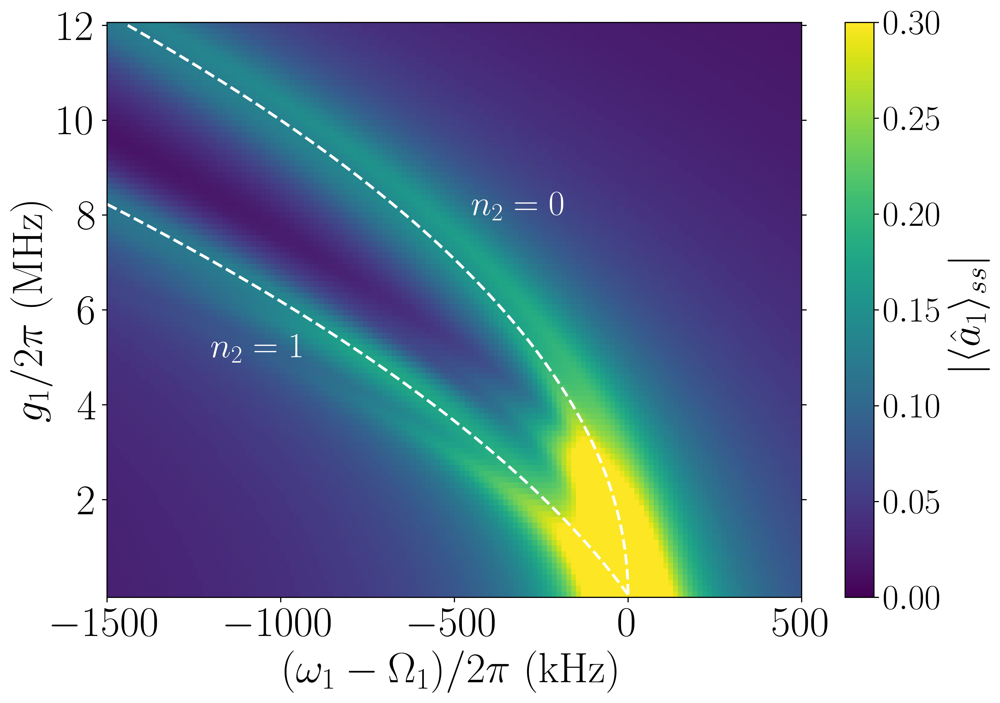

In [32]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))
# axes.imshow(neglist12_,origin="lower",aspect=1.0)
y_list = [k / (2*pi*1e6) for k in g1list]
nrm = mpl.colors.Normalize(0, 0.3)
axes.pcolormesh(x_list, y_list, A1_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y12 = [-(2*k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
y22 = [(-(2*k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(y1, y_list, '--', color='white', lw=2.0)
#axes.plot(y12, y_list, ':', color='white', lw=2.0)
axes.plot(y2, y_list, '--', color='white', lw=2.0)
#axes.plot(y22, y_list, ':', color='white', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
axes.text(-1200, 5, r"$n_2 = 1$", color='white', fontsize=25)
axes.text(-450, 8, r"$n_2 = 0$", color='white', fontsize=25)
plt.pcolormesh(x_list, y_list, A1_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\vert\langle \hat a_1 \rangle_{ss}\vert$', rotation=90, fontsize=30)
plt.tight_layout()

#cp = axes.contour(x_list, y_list, A1_xy_list)
#axes.clabel(cp, inline=True,
#            fontsize=16)

plt.savefig('a1_ss_02.pdf')
plt.show()


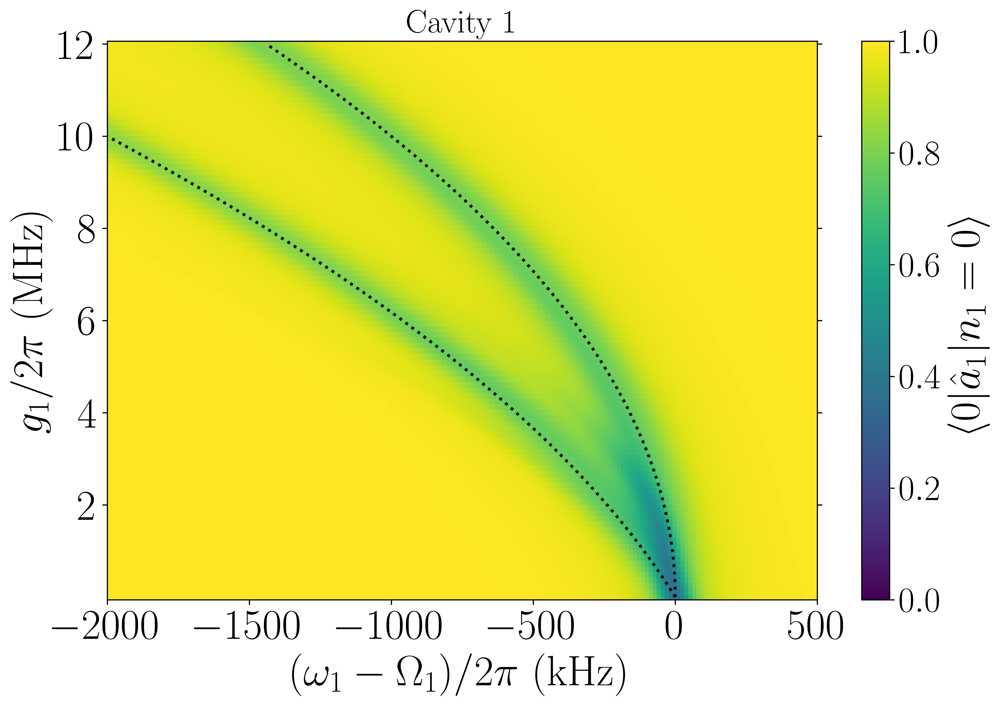

In [35]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
nrm = mpl.colors.Normalize(0, 1)
axes.pcolormesh(x_list, y_list, p10_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(y1, y_list, ':', color='black', lw=2.0)
axes.plot(y2, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-2000, 500)
axes.set_title(r'Cavity 1', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, p10_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 0\vert \hat a_1 \vert n_1 = 0\rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('pop1_0_01.pdf')
plt.show()


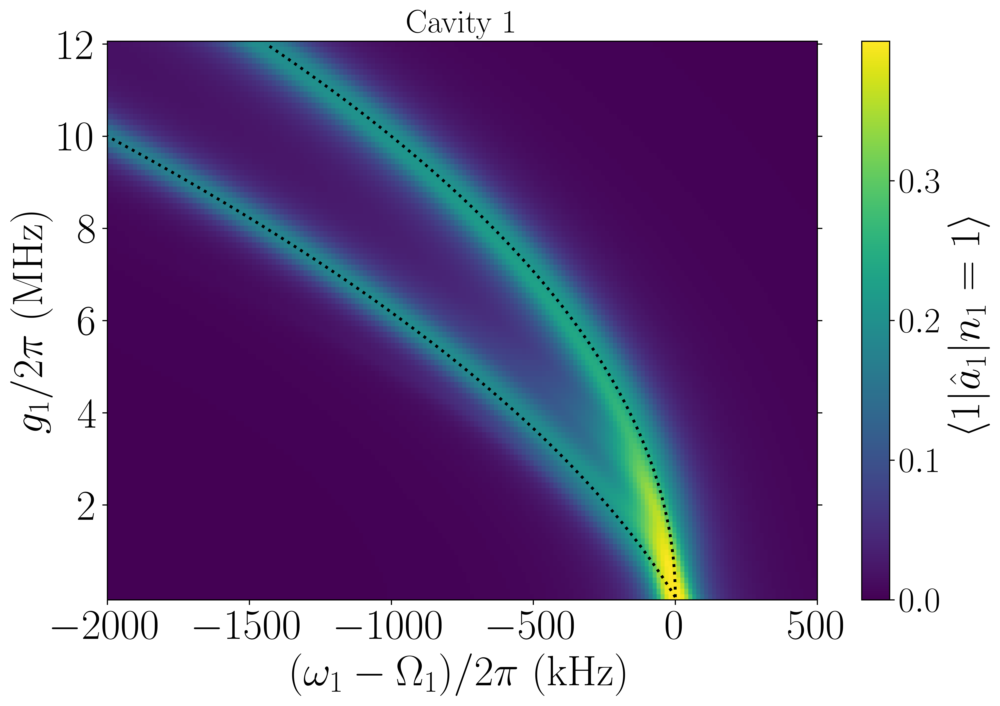

In [39]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
nrm = mpl.colors.Normalize(0, max(p11_xy_list[0]))
axes.pcolormesh(x_list, y_list, p11_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(y1, y_list, ':', color='black', lw=2.0)
axes.plot(y2, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-2000, 500)
axes.set_title(r'Cavity 1', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, p11_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 1\vert \hat a_1 \vert n_1 = 1\rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('pop1_0_01.pdf')
plt.show()

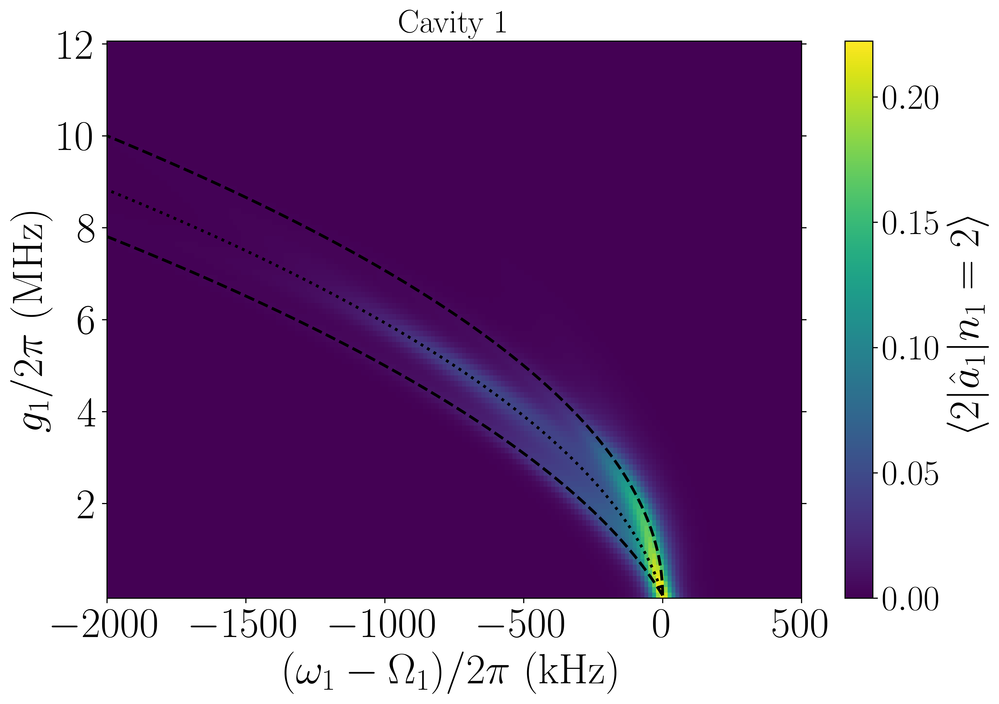

In [65]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
nrm = mpl.colors.Normalize(0, max(p12_xy_list[0]))
axes.pcolormesh(x_list, y_list, p12_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
y1 = [-(2*k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(2*k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
y3 = [(-(2*k**2)/(2*pi*wr*1e3))-(( k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(y1, y_list, '--', color='black', lw=2.0)
axes.plot(y2, y_list, '--', color='black', lw=2.0)
axes.plot(y3, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-2000, 500)
axes.set_title(r'Cavity 1', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, p12_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 2\vert \hat a_1 \vert n_1 = 2\rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('pop1_2_01.pdf')
plt.show()

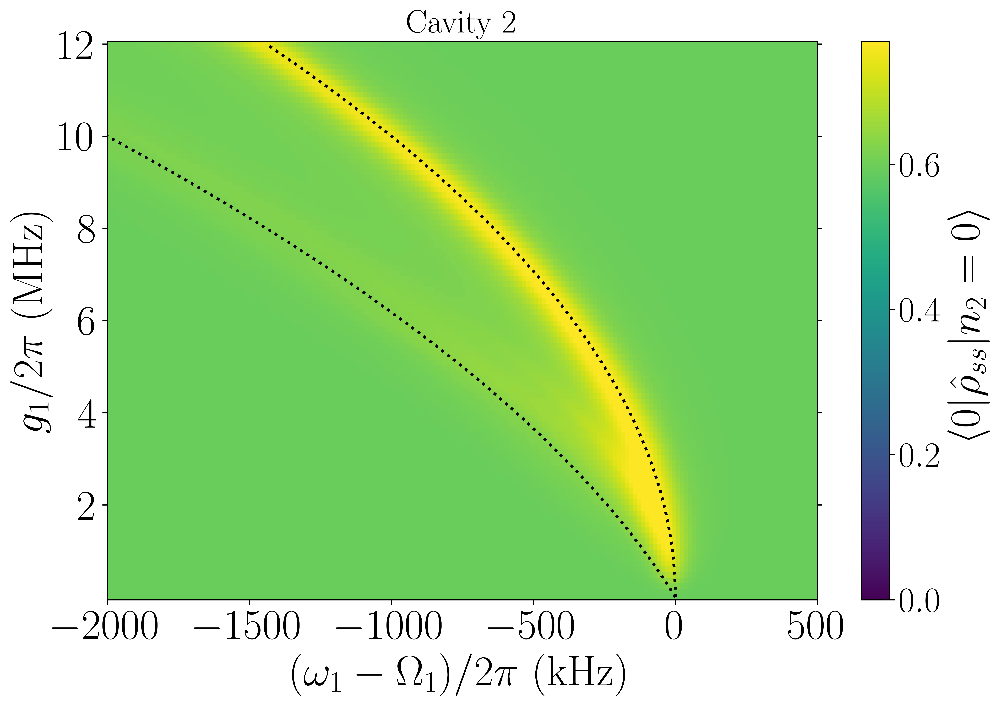

In [60]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
nrm = mpl.colors.Normalize(0, max(p20_xy_list[59]))
axes.pcolormesh(x_list, y_list, p20_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(y1, y_list, ':', color='black', lw=2.0)
axes.plot(y2, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-2000, 500)
axes.set_title(r'Cavity 2', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, p20_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 0\vert \hat \rho_{ss} \vert n_2 = 0\rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('pop2_0_01.pdf')
plt.show()


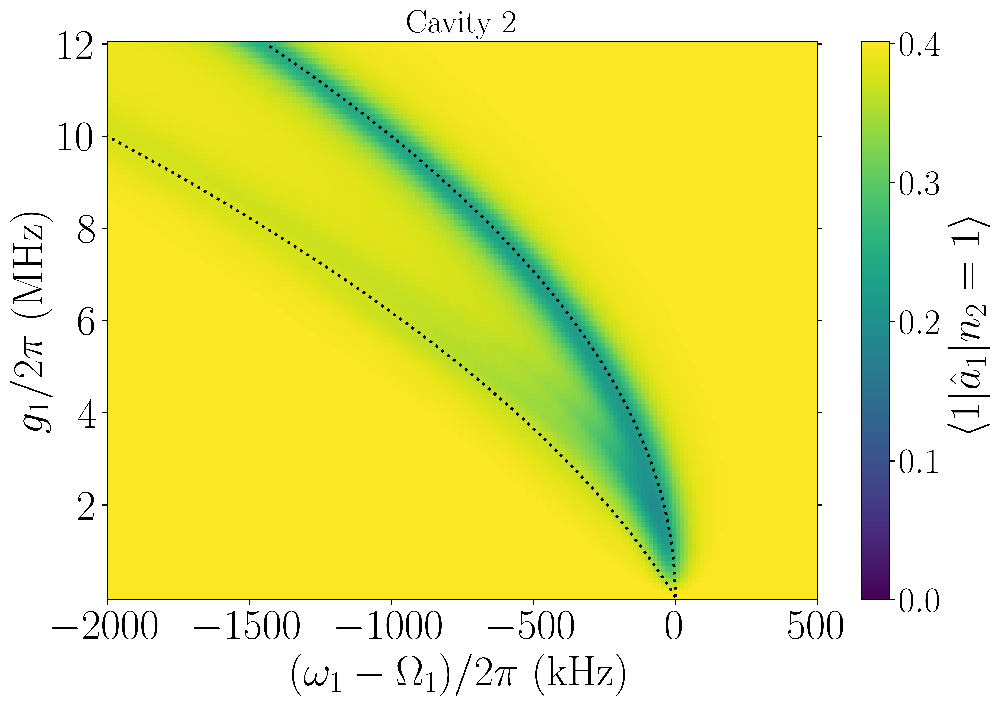

In [56]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
nrm = mpl.colors.Normalize(0, max(p21_xy_list[0]))
axes.pcolormesh(x_list, y_list, p21_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(y1, y_list, ':', color='black', lw=2.0)
axes.plot(y2, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-2000, 500)
axes.set_title(r'Cavity 2', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, p21_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 1\vert \hat a_1 \vert n_2 = 1\rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('pop2_0_01.pdf')
plt.show()


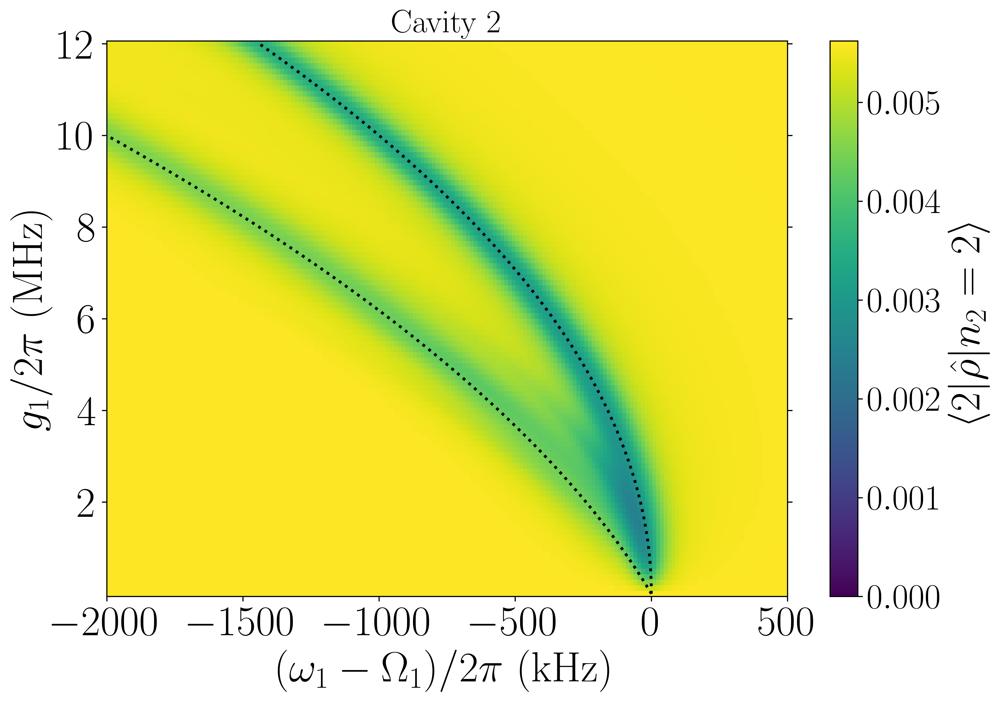

In [55]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
nrm = mpl.colors.Normalize(0, max(p22_xy_list[0]))
axes.pcolormesh(x_list, y_list, p22_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(y1, y_list, ':', color='black', lw=2.0)
axes.plot(y2, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-2000, 500)
axes.set_title(r'Cavity 2', fontsize=23)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, p22_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(
    r'$\langle 2\vert \hat \rho \vert n_2 = 2\rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('pop2_0_01.pdf')
plt.show()


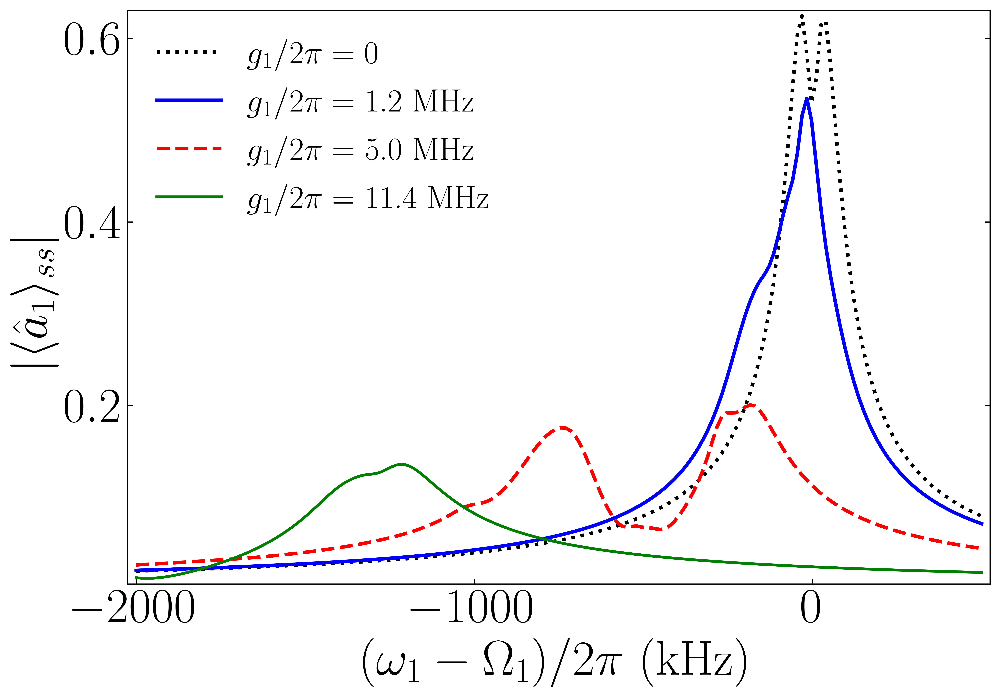

In [20]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]

axes.plot(x_list, A1_xy_list[0], color='black',
          linestyle=':', label=r'$g_1/2\pi =  0$', lw=2.5)
axes.plot(x_list, A1_xy_list[10], color='blue', linestyle='-',
          label=r'$g_1/2\pi = $ %.1f MHz' % y_list[10], lw=2.5)
axes.plot(x_list, A1_xy_list[41], color='red', linestyle='--',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[41], lw=2.5)
axes.plot(x_list, A1_xy_list[94], color='green', linestyle='-',
          label=r'$g_1/2\pi =$ %.1f MHz' % y_list[94], lw=2.0)

axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=35)
axes.set_ylabel(
    r'$\vert\langle \hat{a}_1\rangle_{ss}\vert$', rotation=90, fontsize=35)

axes.tick_params(axis='both', which='major', direction='in', labelsize=35)
axes.tick_params(axis='both', which='minor', direction='in', labelsize=35)
# axes.yaxis.tick_right()
axes.yaxis.set_ticks_position('both')
axes.legend(loc=2, fontsize=23, frameon=False)
#start, end = axes.get_xlim()
#axes.yaxis.set_ticks(arange(0, 0.81, 0.1))

#axes.text(-900, 0.14, r"$n_2 = 1$", color='red', fontsize=25, rotation=-45)
#axes.text(-410, 0.27, r"$n_2 = 0$", color='red', fontsize=25, rotation=-45)

plt.margins(x=0.01, y=0.01)
plt.tight_layout()
plt.savefig('a1_ss_2d_02.pdf')
plt.show()


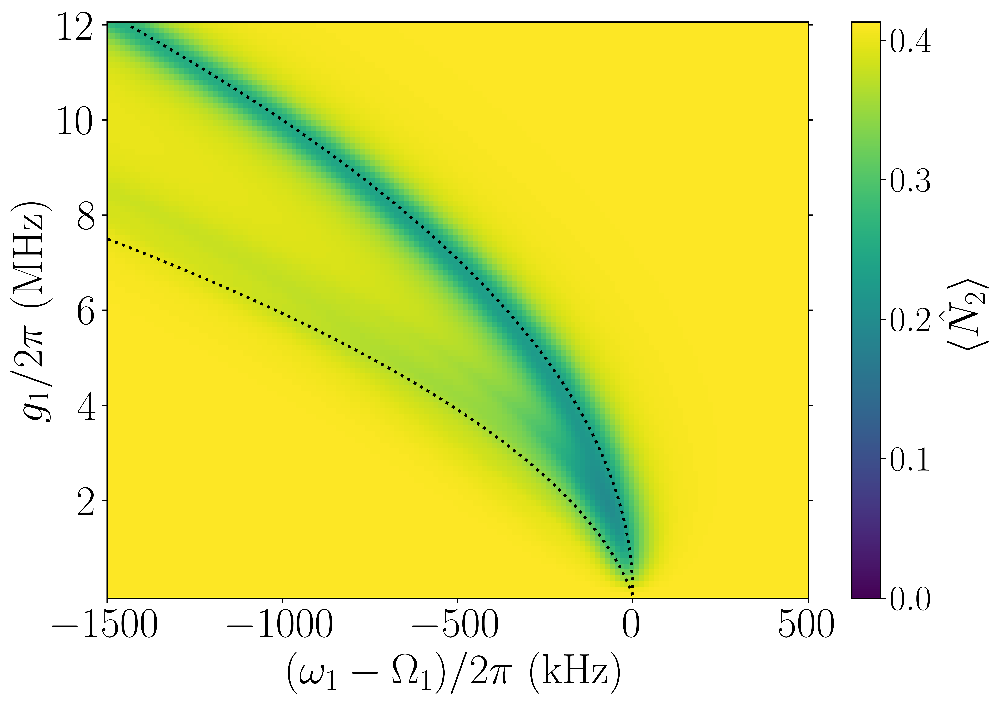

In [62]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
nrm = mpl.colors.Normalize(0, max(N2_xy_list[0]))
axes.pcolormesh(x_list, y_list, N2_xy_list,
                cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
yyy2 = [(-(2*k**2)/(2*pi*wr*1e3))-((k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(shift_curve, y_list, ':', color='black', lw=2.0)
axes.plot(yyy2, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-1500, 500)
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=30)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=30)
axes.tick_params(axis='both', which='major', direction='out', labelsize=30)
axes.tick_params(axis='both', which='minor', labelsize=30)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, N2_xy_list,
               cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\langle \hat N_2 \rangle$', rotation=90, fontsize=30)
plt.tight_layout()

plt.savefig('N2_00.pdf')
plt.show()


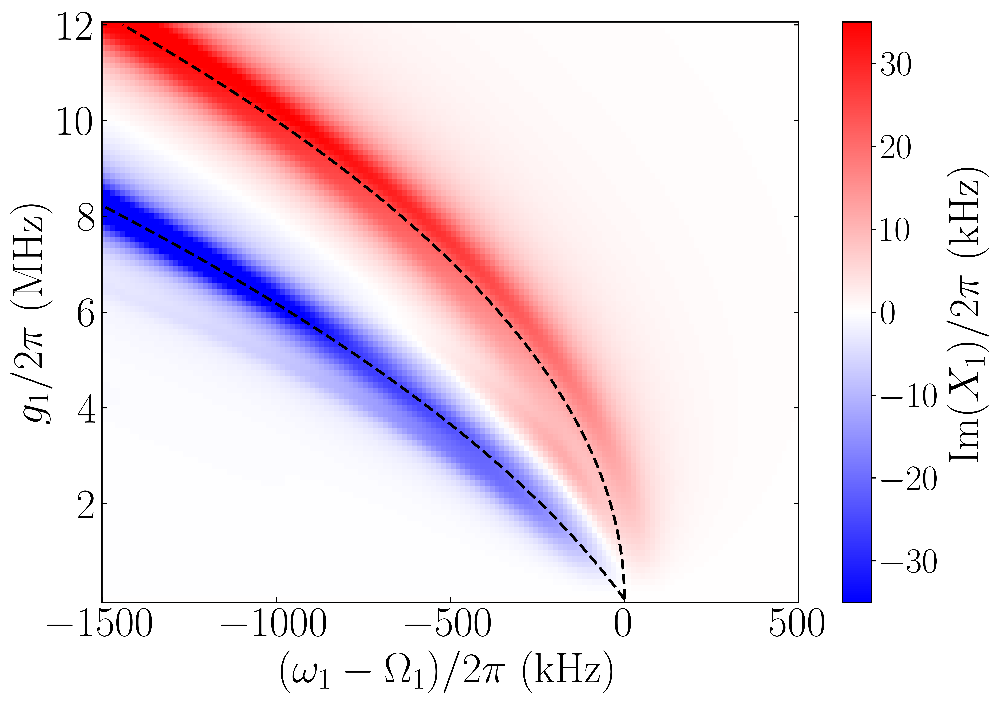

In [66]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
z_list = [[imag(k) / (2*pi*1e3) for k in i] for i in X1_xy_list]

nrm = mpl.colors.Normalize(-35, 35)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y12 = [-(2*k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
y22 = [(-(k**2)/(2*pi*wr*1e3))-((4*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(y1, y_list, '--', color='black', lw=2.0)
#axes.plot(y12, y_list, ':', color='black', lw=2.0)
axes.plot(y2, y_list, '--', color='black', lw=2.0)
#axes.plot(y22, y_list, ':', color='black', lw=2.0)
axes.set_xlim(-1500, 500)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', labelsize=Lsize)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
axes.yaxis.set_ticks_position('both')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Im$(X_1)/2\pi$ (kHz)', rotation=90, fontsize=Lsize)
plt.tight_layout()

plt.savefig('ImX_01.pdf')
plt.show()


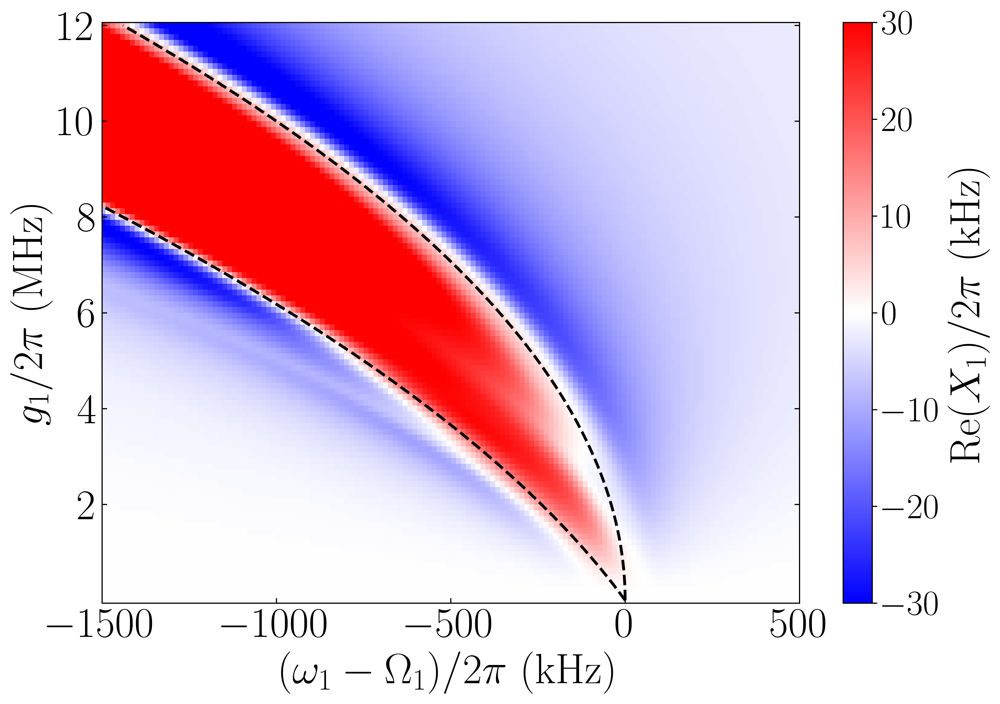

In [27]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
z_list = [[real(k) / (2*pi*1e3) for k in i] for i in X1_xy_list]

nrm = mpl.colors.Normalize(-30, 30)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(shift_curve, y_list, '--', color='black', lw=2.0)
axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
axes.set_xlim(-1500, 500)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', labelsize=Lsize)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.bwr, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Re$(X_1)/2\pi$ (kHz)', rotation=90, fontsize=Lsize)
plt.tight_layout()

plt.savefig('ReX_01.pdf')
plt.show()


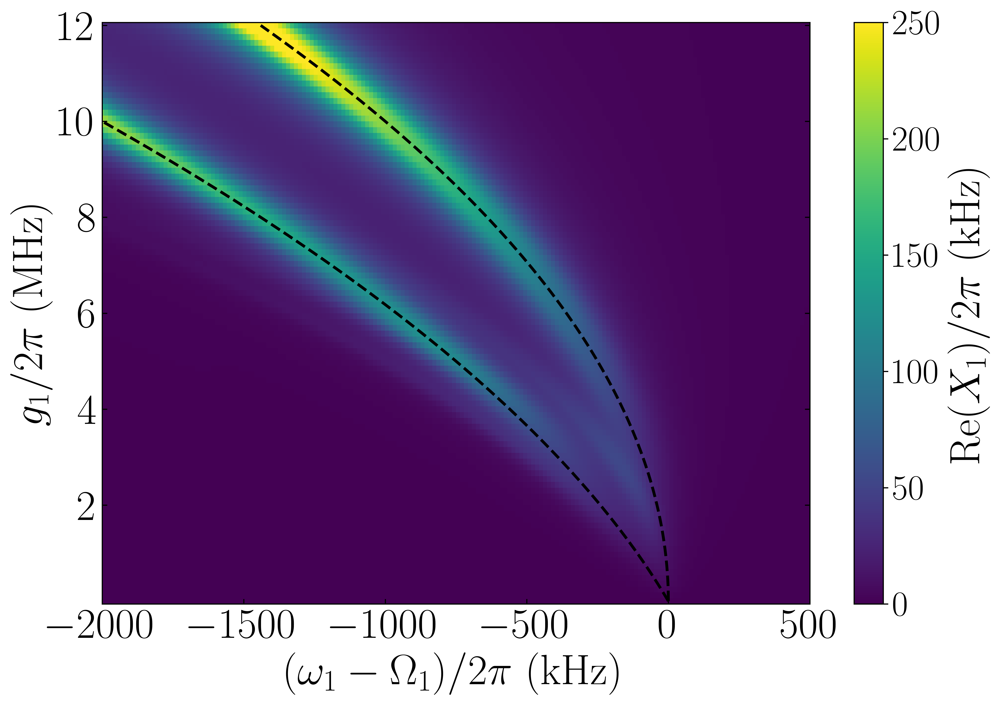

In [80]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
z_list = [[real(k) / (2*pi*1e3) for k in i] for i in DeltaE1_xy_list]

nrm = mpl.colors.Normalize(0, 250)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(shift_curve, y_list, '--', color='black', lw=2.0)
axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
axes.set_xlim(-2000, 500)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', labelsize=Lsize)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Re$(X_1)/2\pi$ (kHz)', rotation=90, fontsize=Lsize)
plt.tight_layout()

plt.savefig('ReX_01.pdf')
plt.show()


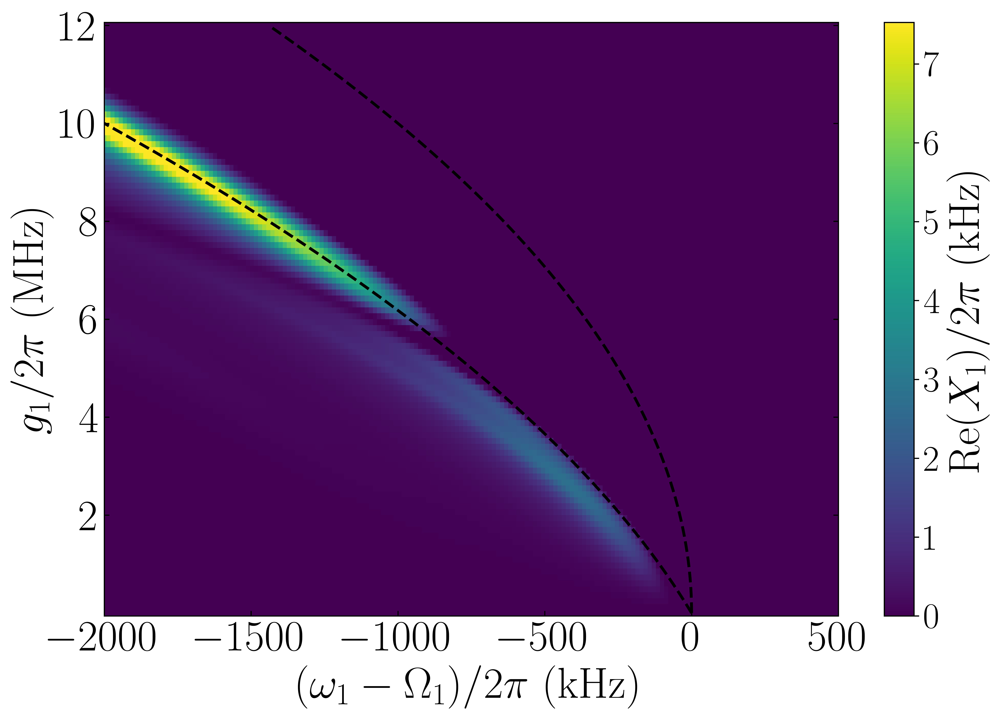

In [83]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
z_list = [[k / (2*pi*1e3) for k in i] for i in sigma1_xy_list]

nrm = mpl.colors.Normalize(0, max(z_list[70]))
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(shift_curve, y_list, '--', color='black', lw=2.0)
axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
axes.set_xlim(-2000, 500)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', labelsize=Lsize)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Re$(X_1)/2\pi$ (kHz)', rotation=90, fontsize=Lsize)
plt.tight_layout()

plt.savefig('ReX_01.pdf')
plt.show()


In [86]:
len(sigma1_xy_list[0][:])

180

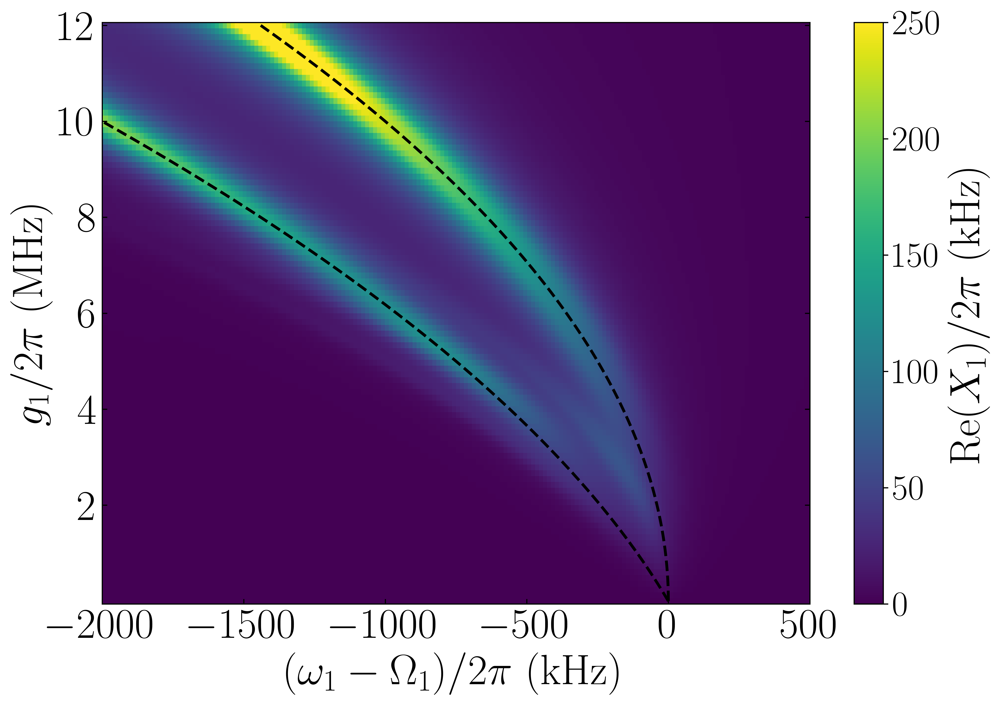

In [97]:
fig, axes = plt.subplots(1, 1, figsize=(10, 7))

y_list = [k / (2*pi*1e6) for k in g1list]
z_list = []
for k in range(len(sigma1_xy_list[:])):
    line = []
    for i in range(len(sigma1_xy_list[0][:])):
        line.append((DeltaE1_xy_list[k][i] - sigma1_xy_list[k][i])/(2 * pi * 1e3))
    z_list.append(line)

nrm = mpl.colors.Normalize(0, 250)
axes.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis, norm=nrm, shading='auto')
shift_curve = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
yyy2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
axes.plot(shift_curve, y_list, '--', color='black', lw=2.0)
axes.plot(yyy2, y_list, '--', color='black', lw=2.0)
axes.set_xlim(-2000, 500)

Lsize = 30
axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                rotation=0, fontsize=Lsize)
axes.set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=Lsize)
axes.tick_params(axis='both', which='major', direction='in', labelsize=Lsize)
axes.tick_params(axis='both', which='minor', labelsize=Lsize)
axes.yaxis.set_ticks(arange(2, 12.1, 2))
axes.yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z_list, cmap=cm.viridis, norm=nrm, shading='auto')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'Re$(X_1)/2\pi$ (kHz)', rotation=90, fontsize=Lsize)
plt.tight_layout()

plt.savefig('ReX_01.pdf')
plt.show()

In [110]:
nm = arange(5,100,10)
nm[1]

15

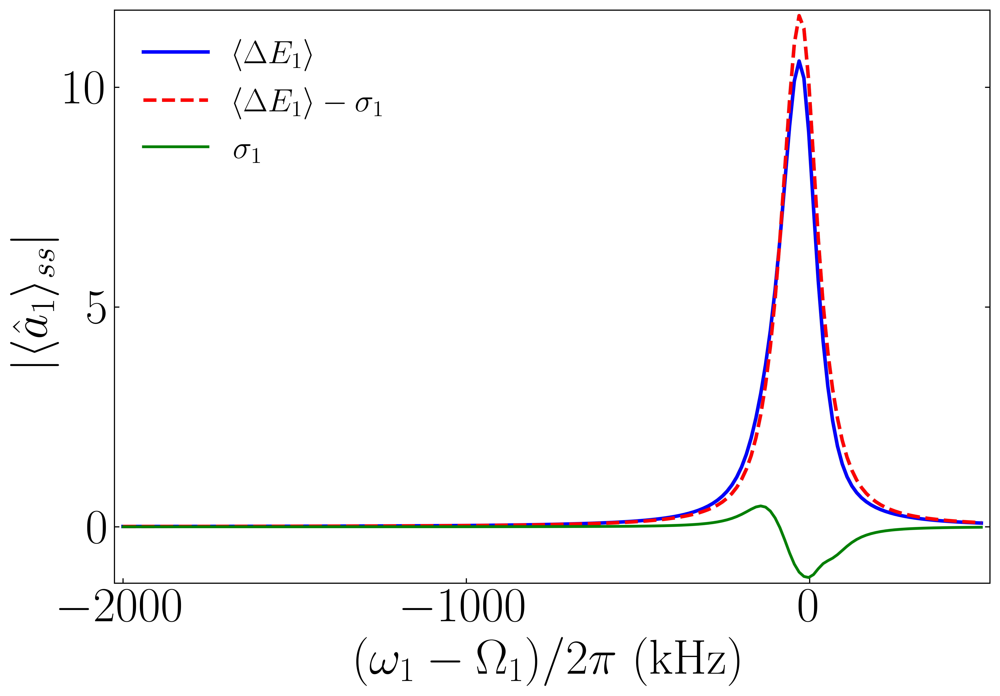

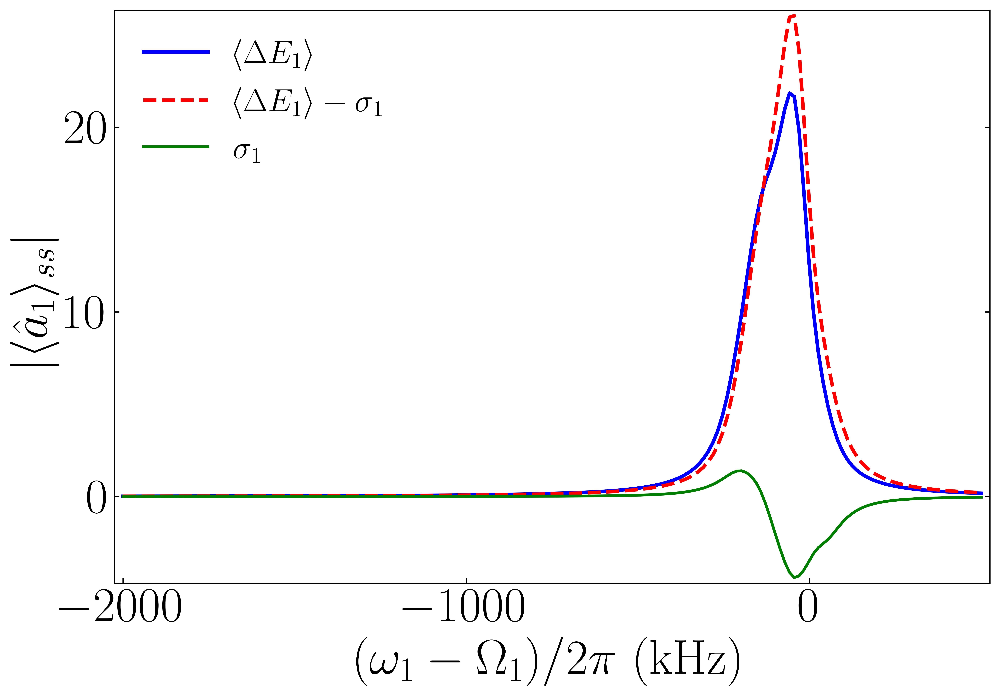

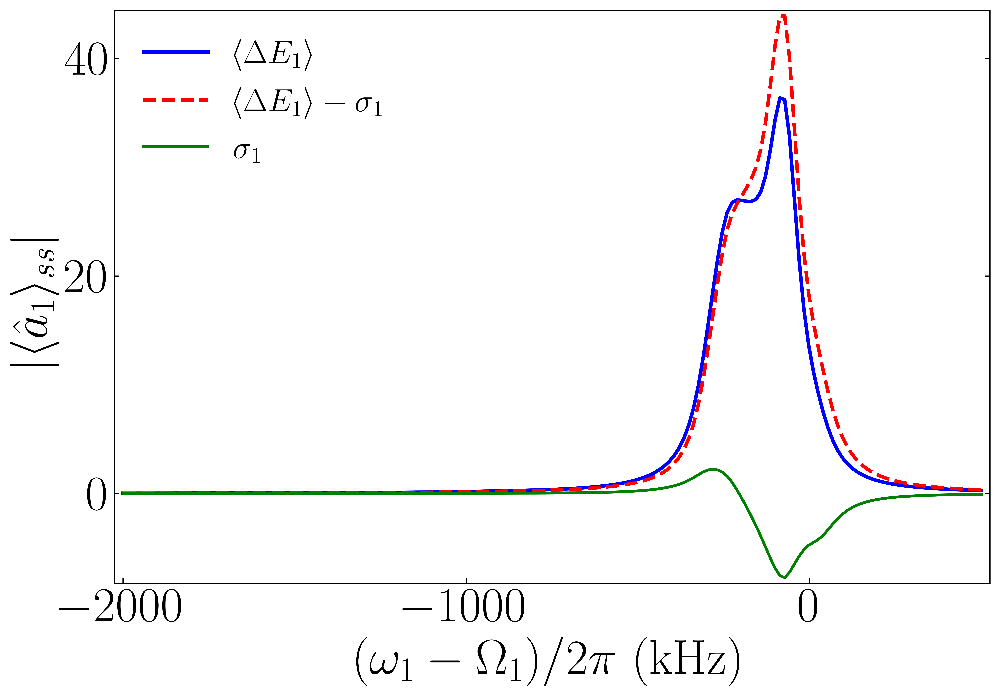

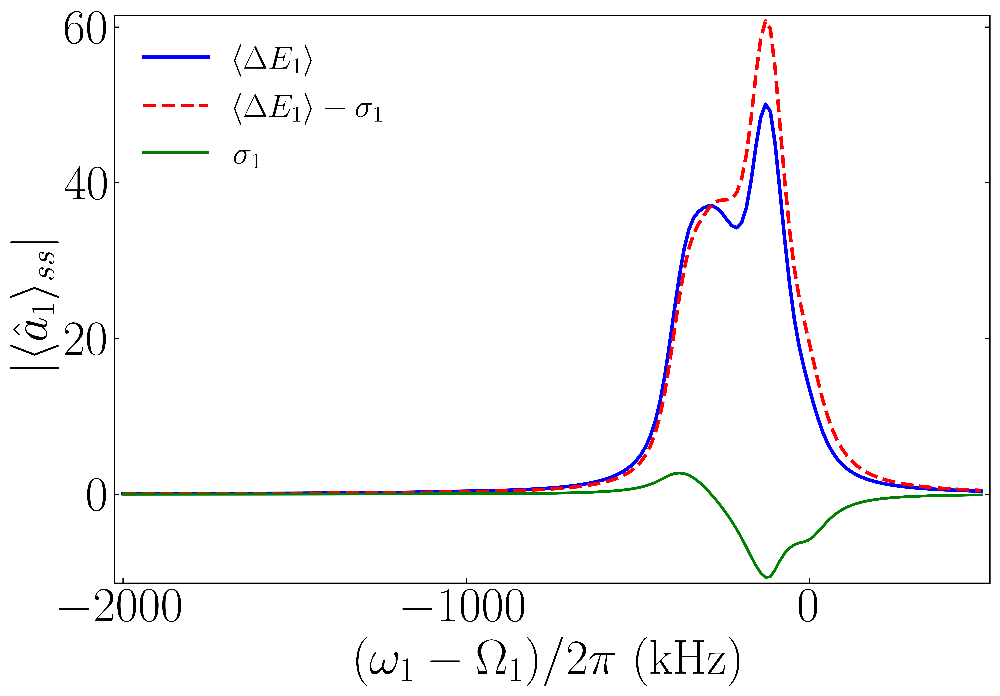

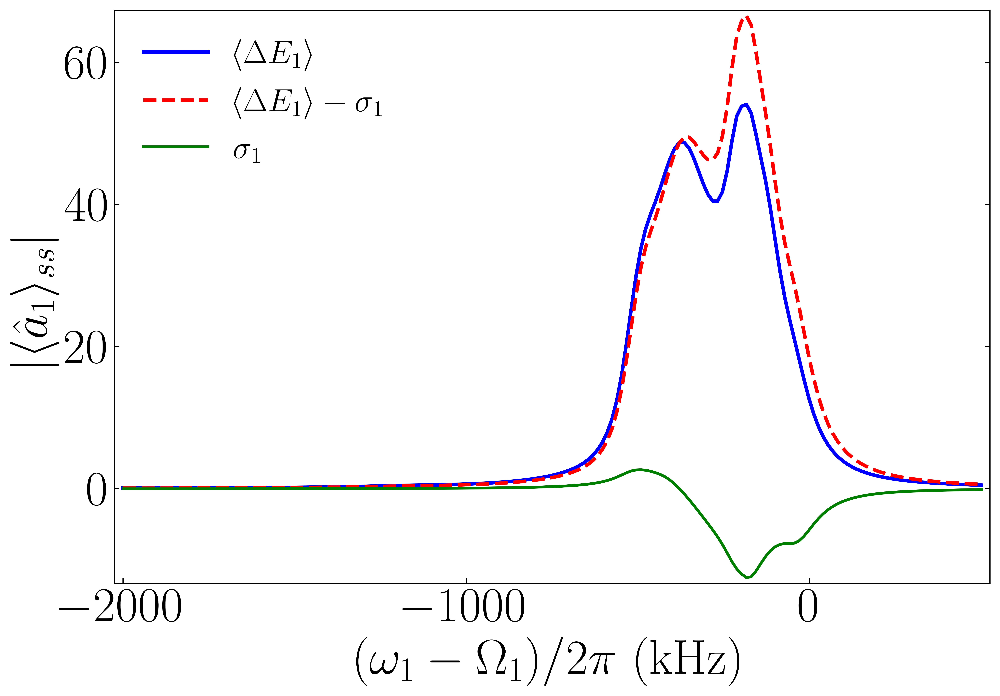

...

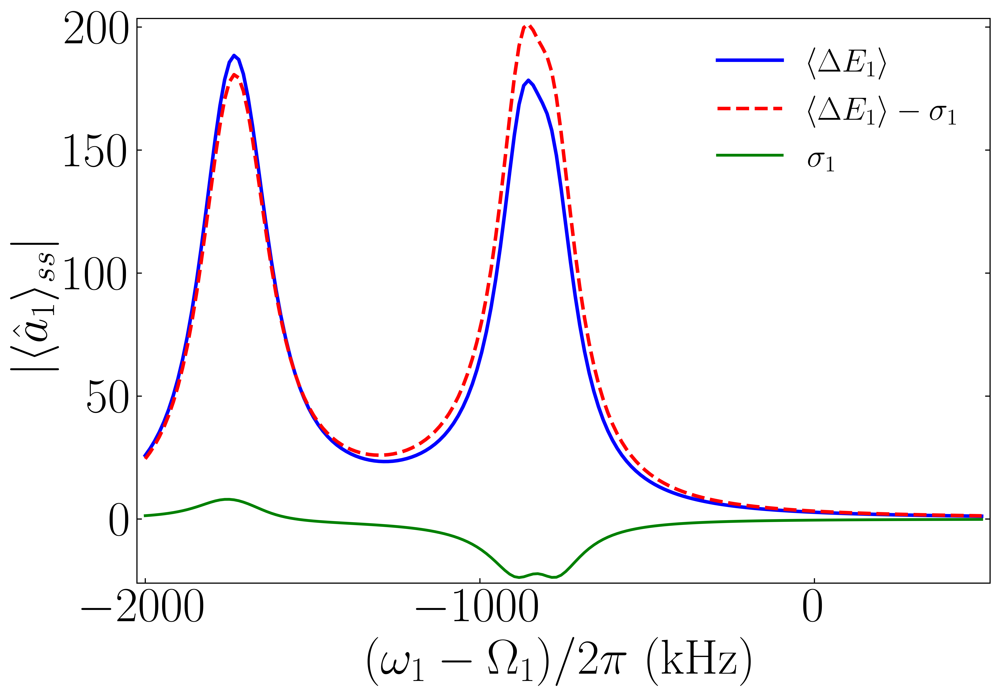

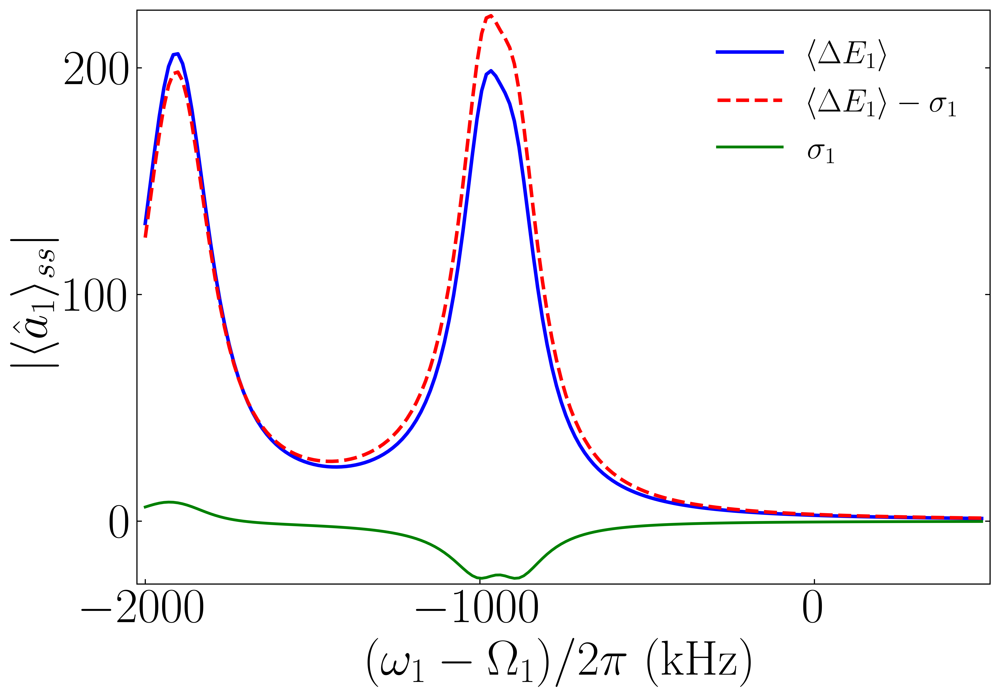

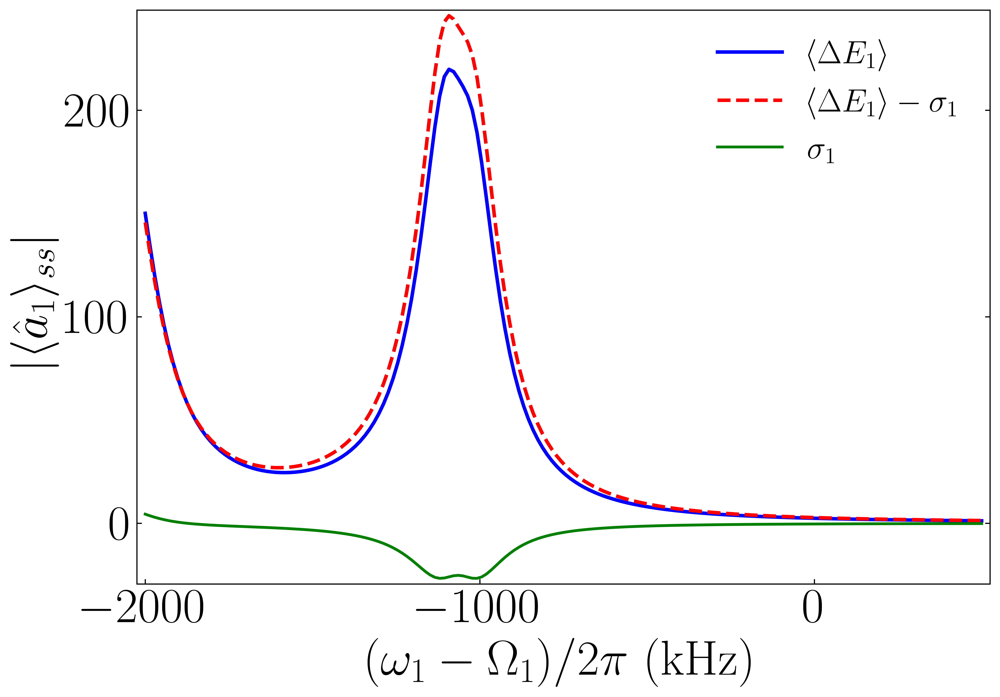

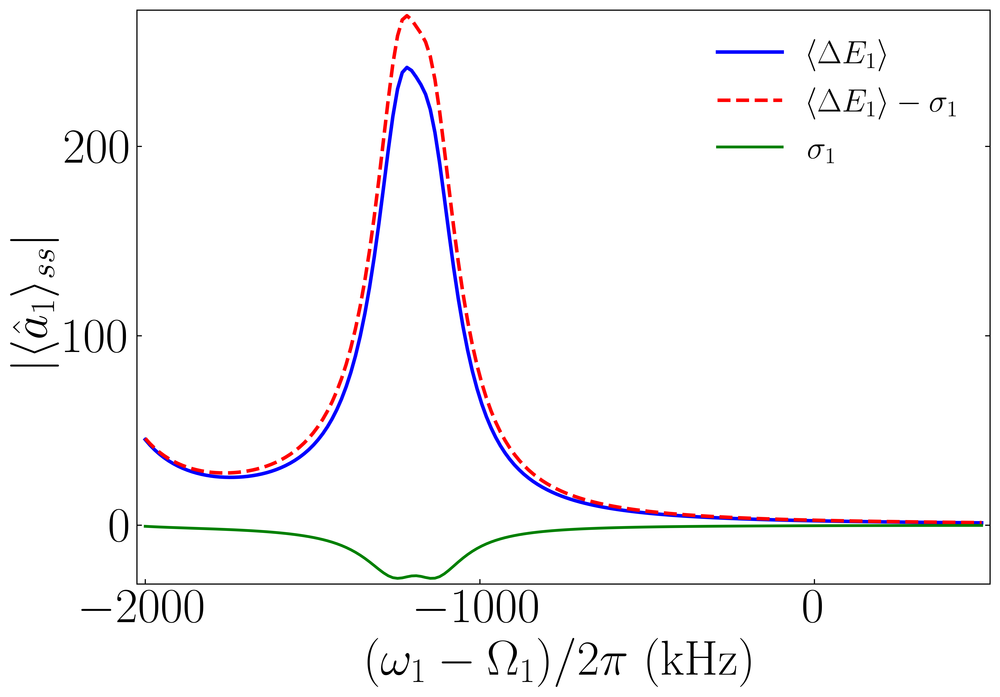

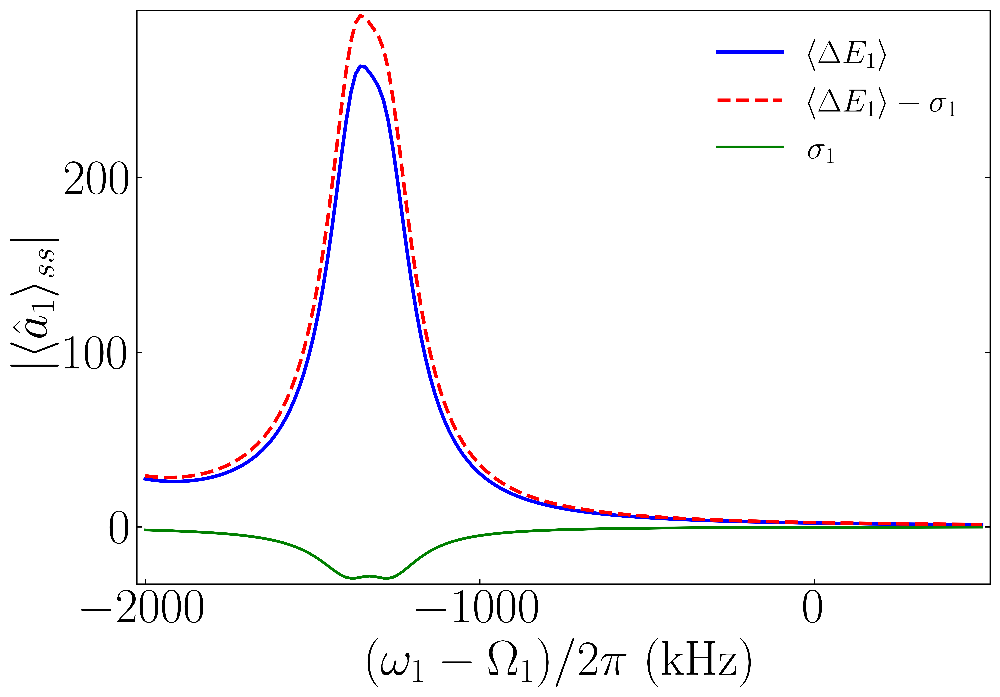

In [115]:
y_list = [k / (2*pi*1e6) for k in g1list]

z_list2 = [[k / (2*pi*1e3) for k in i] for i in sigma1_xy_list]
z_list3 = [[k / (2*pi*1e3) for k in i] for i in DeltaE1_xy_list]

nm = arange(5,g_size,5)

for i in range(len(nm)):

    fig, axes = plt.subplots(1, 1, figsize=(10, 7))
    axes.plot(x_list, z_list3[nm[i]], color='blue', linestyle='-', label='$\langle\Delta E_1 \\rangle$', lw=2.5)
    axes.plot(x_list, z_list[nm[i]], color='red', linestyle='--', label='$\langle\Delta E_1 \\rangle - \sigma_1 $', lw=2.5)
    axes.plot(x_list, z_list2[nm[i]], color='green', linestyle='-', label='$\sigma_1$', lw=2.0)

    axes.set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)', rotation=0, fontsize=35)
    axes.set_ylabel(r'$\vert\langle \hat{a}_1\rangle_{ss}\vert$', rotation=90, fontsize=35)

    axes.tick_params(axis='both', which='major', direction='in', labelsize=35)
    axes.tick_params(axis='both', which='minor', direction='in', labelsize=35)
    # axes.yaxis.tick_right()
    axes.yaxis.set_ticks_position('both')
    axes.legend( fontsize=23, frameon=False)
    #start, end = axes.get_xlim()
    #axes.yaxis.set_ticks(arange(0, 0.81, 0.1))

    #axes.text(-900, 0.14, r"$n_2 = 1$", color='red', fontsize=25, rotation=-45)
    #axes.text(-410, 0.27, r"$n_2 = 0$", color='red', fontsize=25, rotation=-45)

    plt.margins(x=0.01, y=0.01)
    plt.tight_layout()
    plt.show()


### Results N = 3

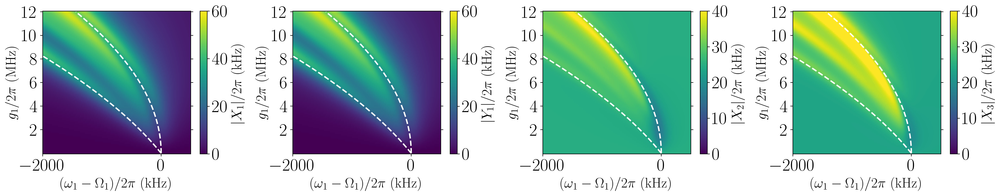

In [74]:
fig, axes = plt.subplots(1, 4, figsize=(20, 4))

font_size  = 20
label_size = 25

y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g3)/(2*pi*wr*1e3)) for k in g1list]

y_list = [k / (2*pi*1e6) for k in g1list]

z1_list = [[abs(k) / (2*pi*1e3) for k in i] for i in X1_xy_list]
z2_list = [[abs(k) / (2*pi*1e3) for k in i] for i in Y1_xy_list]
z3_list = [[abs(k) / (2*pi*1e3) for k in i] for i in X2_xy_list]
z4_list = [[abs(k) / (2*pi*1e3) for k in i] for i in X3_xy_list]

nrm1 = mpl.colors.Normalize(0, 60)
axes[0].pcolormesh(x_list, y_list, z1_list, cmap=cm.viridis,
                   norm=nrm1, shading='auto')
axes[0].plot(y1, y_list, '--', color='white', lw=2.0)
axes[0].plot(y2, y_list, '--', color='white', lw=2.0)
axes[0].set_xlim(-2000, 500)
axes[0].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=font_size)
axes[0].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=font_size)
axes[0].tick_params(axis='both', which='major', direction='out', labelsize=label_size)
axes[0].tick_params(axis='both', which='minor', labelsize=label_size)
axes[0].yaxis.set_ticks(arange(2, 12.1, 2))
axes[0].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z1_list, cmap=cm.viridis,
               norm=nrm1, shading='auto')
cbar = plt.colorbar(ax=axes[0])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_1\vert/2\pi$ (kHz)', rotation=90, fontsize=font_size)


nrm2 = mpl.colors.Normalize(0, 60)
axes[1].pcolormesh(x_list, y_list, z2_list, cmap=cm.viridis,
                   norm=nrm2, shading='auto')
axes[1].plot(y1, y_list, '--', color='white', lw=2.0)
axes[1].plot(y2, y_list, '--', color='white', lw=2.0)
axes[1].set_xlim(-2000, 500)
axes[1].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=font_size)
axes[1].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=font_size)
axes[1].tick_params(axis='both', which='major', direction='out', labelsize=label_size)
axes[1].tick_params(axis='both', which='minor', labelsize=label_size)
axes[1].yaxis.set_ticks(arange(2, 12.1, 2))
axes[1].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z2_list, cmap=cm.viridis,
               norm=nrm2, shading='auto')
cbar = plt.colorbar(ax=axes[1])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert Y_1\vert/2\pi$ (kHz)', rotation=90, fontsize=font_size)

nrm3 = mpl.colors.Normalize(0, 40)
axes[2].pcolormesh(x_list, y_list, z3_list, cmap=cm.viridis,
                   norm=nrm3, shading='auto')
axes[2].plot(y1, y_list, '--', color='white', lw=2.0)
axes[2].plot(y2, y_list, '--', color='white', lw=2.0)
axes[2].set_xlim(-2000, 500)
axes[2].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=font_size)
axes[2].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=font_size)
axes[2].tick_params(axis='both', which='major', direction='out', labelsize=label_size)
axes[2].tick_params(axis='both', which='minor', labelsize=label_size)
axes[2].yaxis.set_ticks(arange(2, 12.1, 2))
axes[2].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z3_list, cmap=cm.viridis,
               norm=nrm3, shading='auto')
cbar = plt.colorbar(ax=axes[2])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_2\vert/2\pi$ (kHz)', rotation=90, fontsize=font_size)


nrm4 = mpl.colors.Normalize(0, 40)
axes[3].pcolormesh(x_list, y_list, z4_list, cmap=cm.viridis,
                   norm=nrm4, shading='auto')
axes[3].plot(y1, y_list, '--', color='white', lw=2.0)
axes[3].plot(y2, y_list, '--', color='white', lw=2.0)
axes[3].set_xlim(-2000, 500)
axes[3].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=font_size)
axes[3].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=font_size)
axes[3].tick_params(axis='both', which='major', direction='out', labelsize=label_size)
axes[3].tick_params(axis='both', which='minor', labelsize=label_size)
axes[3].yaxis.set_ticks(arange(2, 12.1, 2))
axes[3].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z4_list, cmap=cm.viridis,
               norm=nrm4, shading='auto')
cbar = plt.colorbar(ax=axes[3])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_3\vert/2\pi$ (kHz)', rotation=90, fontsize=font_size)


plt.tight_layout()

plt.savefig('absXY_00.pdf')
plt.show()


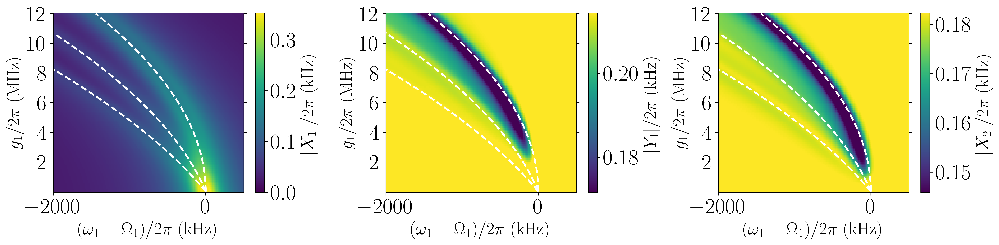

In [83]:
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

font_size  = 20
label_size = 25

y1 = [-(k**2)/(2*pi*wr*1e3) for k in g1list]
y2 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g2)/(2*pi*wr*1e3)) for k in g1list]
y3 = [(-(k**2)/(2*pi*wr*1e3))-((2*k*g3)/(2*pi*wr*1e3)) for k in g1list]

y_list = [k / (2*pi*1e6) for k in g1list]

z1_list = [[abs(k)  for k in i] for i in A1_xy_list]
z2_list = [[abs(k)  for k in i] for i in A2_xy_list]
z3_list = [[abs(k)  for k in i] for i in A3_xy_list]

nrm1 = mpl.colors.Normalize(0, max(z1_list[0]))
axes[0].pcolormesh(x_list, y_list, z1_list, cmap=cm.viridis,
                   norm=nrm1, shading='auto')
axes[0].plot(y1, y_list, '--', color='white', lw=2.0)
axes[0].plot(y2, y_list, '--', color='white', lw=2.0)
axes[0].plot(y3, y_list, '--', color='white', lw=2.0)
axes[0].set_xlim(-2000, 500)
axes[0].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=font_size)
axes[0].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=font_size)
axes[0].tick_params(axis='both', which='major', direction='out', labelsize=label_size)
axes[0].tick_params(axis='both', which='minor', labelsize=label_size)
axes[0].yaxis.set_ticks(arange(2, 12.1, 2))
axes[0].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z1_list, cmap=cm.viridis,
               norm=nrm1, shading='auto')
cbar = plt.colorbar(ax=axes[0])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_1\vert/2\pi$ (kHz)', rotation=90, fontsize=font_size)


nrm2 = mpl.colors.Normalize(0.8*  max(z2_list[0]), max(z2_list[0]))
axes[1].pcolormesh(x_list, y_list, z2_list, cmap=cm.viridis,
                   norm=nrm2, shading='auto')
axes[1].plot(y1, y_list, '--', color='white', lw=2.0)
axes[1].plot(y2, y_list, '--', color='white', lw=2.0)
axes[1].plot(y3, y_list, '--', color='white', lw=2.0)
axes[1].set_xlim(-2000, 500)
axes[1].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=font_size)
axes[1].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=font_size)
axes[1].tick_params(axis='both', which='major', direction='out', labelsize=label_size)
axes[1].tick_params(axis='both', which='minor', labelsize=label_size)
axes[1].yaxis.set_ticks(arange(2, 12.1, 2))
axes[1].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z2_list, cmap=cm.viridis,
               norm=nrm2, shading='auto')
cbar = plt.colorbar(ax=axes[1])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert Y_1\vert/2\pi$ (kHz)', rotation=90, fontsize=font_size)

nrm3 = mpl.colors.Normalize(0.8* max(z3_list[0]), max(z3_list[0]))
axes[2].pcolormesh(x_list, y_list, z3_list, cmap=cm.viridis,
                   norm=nrm3, shading='auto')
axes[2].plot(y1, y_list, '--', color='white', lw=2.0)
axes[2].plot(y2, y_list, '--', color='white', lw=2.0)
axes[2].plot(y3, y_list, '--', color='white', lw=2.0)
axes[2].set_xlim(-2000, 500)
axes[2].set_xlabel(r'$(\omega_1 - \Omega_1)/2\pi$ (kHz)',
                   rotation=0, fontsize=font_size)
axes[2].set_ylabel(r'$g_1/2\pi$ (MHz)', rotation=90, fontsize=font_size)
axes[2].tick_params(axis='both', which='major', direction='out', labelsize=label_size)
axes[2].tick_params(axis='both', which='minor', labelsize=label_size)
axes[2].yaxis.set_ticks(arange(2, 12.1, 2))
axes[2].yaxis.set_ticks_position('both')
plt.pcolormesh(x_list, y_list, z3_list, cmap=cm.viridis,
               norm=nrm3, shading='auto')
cbar = plt.colorbar(ax=axes[2])
cbar.ax.tick_params(labelsize=25)
cbar.ax.set_ylabel(r'$\vert X_2\vert/2\pi$ (kHz)', rotation=90, fontsize=font_size)


plt.tight_layout()

plt.savefig('absXY_00.pdf')
plt.show()



### Results N = 4